# UCL Dissertation - Cold Waves Calculation and Analysis - Code ERA5 Tasmin Observation Reanalysis

This notebook shows the code to calculate cold waves based off the methodology used in my Master's dissertation. This notebook is for ERA5 Daily Minimum Temperature Data to calculate cold wave periods and subsequent analysis of those periods. 

# 1.1 Import packages and files

In [1]:
import xarray as xr
filename_era5_tmin_europe='OneDrive - University College London/Documents/Uni/Masters/Dissertation/Data/ERA5/CE/era5_tmin_daily_eu_extended.nc'

In [2]:
#combine files

ds_tmin_era = xr.open_mfdataset(paths=[filename_era5_tmin_europe], combine="by_coords")

In [1]:
'''Import packages for loading data, analysing, and plotting'''

import xarray
import numpy
import cartopy
import matplotlib
%matplotlib inline

# Add a couple of deep down individual functions.
from mpl_toolkits.axes_grid1 import make_axes_locatable
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
from matplotlib.ticker import AutoMinorLocator
from cartopy.util import add_cyclic_point

# used to create area averages over AR6 regions.
import regionmask

# hide some warning messages
import warnings
warnings.filterwarnings("ignore")

C:\Users\harry\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated and will be removed in a future release
  "class": algorithms.Blowfish,


In [2]:
#pip install xarray == 2023.10.1
import xarray as xr

#pip install numpy == 1.22.0
import numpy as np

#pip install cartopy == 0.22.0
import cartopy 

#pip install xarray == 3.5.1
import matplotlib 
import matplotlib.pyplot as plt

import pandas as pd

In [5]:
# load the coordinates
lat=ds_tmin_era['lat']
lon=ds_tmin_era['lon']
# load the variables themselves
tasmin=ds_tmin_era.tmin
tasmin

<xarray.DataArray 'tmin' (time: 27169, lat: 181, lon: 281)> Size: 6GB
dask.array<open_dataset-tmin, shape=(27169, 181, 281), dtype=float32, chunksize=(1, 181, 281), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) datetime64[ns] 217kB 1950-01-01T12:00:00 ... 2024-05-20T1...
  * lon      (lon) float64 2kB -30.0 -29.75 -29.5 -29.25 ... 39.5 39.75 40.0
  * lat      (lat) float64 1kB 75.0 74.75 74.5 74.25 ... 30.75 30.5 30.25 30.0
Attributes:
    long_name:     Daily Minimum Near-Surface Air Temperature
    units:         K
    code:          202
    table:         128
    cell_methods:  time: minimum

# 1.2 Get Tasmin Anomalies (linear trend)

In [7]:
# Define the corrected latitude and longitude bounds for the UK
lat_bounds = slice(60, 49)  # From 60°N to 49°N
lon_bounds = slice(-8, 4)   # From -8°W to 4°E

# Crop the data to the UK region
tasmin_uk = tasmin.sel(lat=lat_bounds, lon=lon_bounds)

# Now you can inspect the cropped dataset
print(tasmin_uk)

<xarray.DataArray 'tmin' (time: 27169, lat: 45, lon: 49)> Size: 240MB
dask.array<getitem, shape=(27169, 45, 49), dtype=float32, chunksize=(1, 45, 49), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) datetime64[ns] 217kB 1950-01-01T12:00:00 ... 2024-05-20T1...
  * lon      (lon) float64 392B -8.0 -7.75 -7.5 -7.25 -7.0 ... 3.25 3.5 3.75 4.0
  * lat      (lat) float64 360B 60.0 59.75 59.5 59.25 ... 49.75 49.5 49.25 49.0
Attributes:
    long_name:     Daily Minimum Near-Surface Air Temperature
    units:         K
    code:          202
    table:         128
    cell_methods:  time: minimum


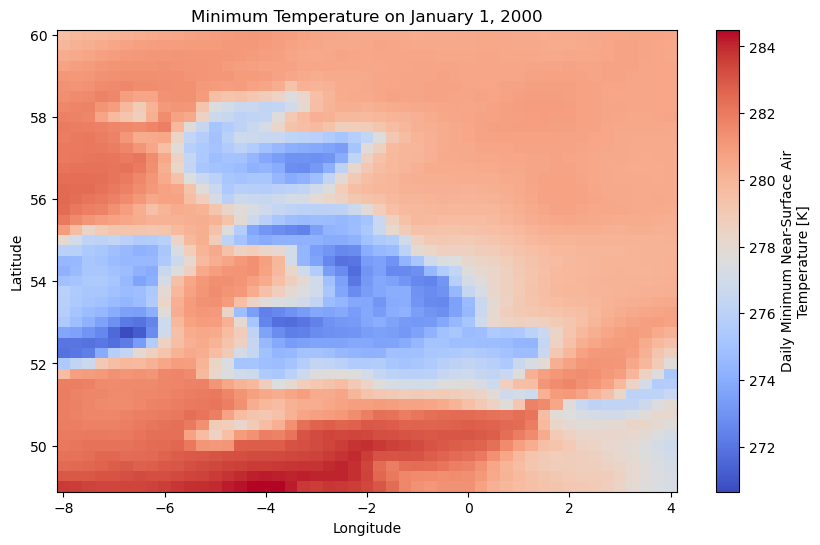

In [13]:
# Select the data for January 1, 2000
tasmin_20000101 = tasmin_uk.sel(time='2000-01-01')

# Plot the tasmin for January 1, 2000
plt.figure(figsize=(10, 6))
tasmin_20000101.plot(cmap='coolwarm')  # You can choose any colormap you like
plt.title('Minimum Temperature on January 1, 2000')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

In [14]:
%%time 
tasmin_uk.load()

CPU times: total: 1min 5s
Wall time: 3min 40s


<xarray.DataArray 'tmin' (time: 27169, lat: 45, lon: 49)> Size: 240MB
array([[[280.85797, 280.92242, 280.98688, ..., 280.26605, 280.34418,
         280.2146 ],
        [281.15485, 281.20367, 281.2486 , ..., 280.43237, 280.38354,
         280.30054],
        [281.4107 , 281.42828, 281.45367, ..., 280.46466, 280.4187 ,
         280.40698],
        ...,
        [283.16653, 283.06497, 283.03763, ..., 268.9887 , 269.22888,
         268.96136],
        [283.13528, 283.16068, 283.1724 , ..., 269.06293, 269.22504,
         269.21527],
        [283.21732, 283.2564 , 283.29742, ..., 269.0473 , 269.3639 ,
         269.41272]],

       [[280.98242, 280.98828, 280.9922 , ..., 279.1543 , 279.2129 ,
         279.0703 ],
        [281.1797 , 281.1875 , 281.19727, ..., 279.31445, 279.2871 ,
         279.13477],
        [281.32422, 281.3086 , 281.30078, ..., 279.4297 , 279.39648,
         279.33203],
...
        [286.59537, 286.59537, 286.75943, ..., 282.31604, 282.07776,
         282.20862],
        [286.6774 , 286.69888, 286.79068, ..., 282.54846, 282.3883 ,
         281.609  ],
        [286.72623, 286.7438 , 286.8434 , ..., 282.59143, 282.4391 ,
         281.84143]],

       [[283.9471 , 283.83774, 283.72925, ..., 283.48755, 283.63208,
         283.7649 ],
        [283.7596 , 283.68344, 283.70386, ..., 283.6985 , 283.8684 ,
         283.9309 ],
        [283.8855 , 284.0476 , 284.10727, ..., 283.6516 , 283.9231 ,
         283.94458],
        ...,
        [286.65503, 286.61987, 286.6433 , ..., 282.74097, 282.8601 ,
         282.4734 ],
        [286.76157, 286.63745, 286.5398 , ..., 282.38354, 282.6433 ,
         282.07886],
        [286.71362, 286.7811 , 286.6355 , ..., 281.63745, 281.71753,
         281.34253]]], dtype=float32)
Coordinates:
  * time     (time) datetime64[ns] 217kB 1950-01-01T12:00:00 ... 2024-05-20T1...
  * lon      (lon) float64 392B -8.0 -7.75 -7.5 -7.25 -7.0 ... 3.25 3.5 3.75 4.0
  * lat      (lat) float64 360B 60.0 59.75 59.5 59.25 ... 49.75 49.5 49.25 49.0
Attributes:
    long_name:     Daily Minimum Near-Surface Air Temperature
    units:         K
    code:          202
    table:         128
    cell_methods:  time: minimum

In [ ]:
%%time
tasmin_coarsen = tasmin.sel(time=slice('1950', '1980')).coarsen(lon=4, boundary='trim').mean().coarsen(lat=4, bounary='trim').mean()

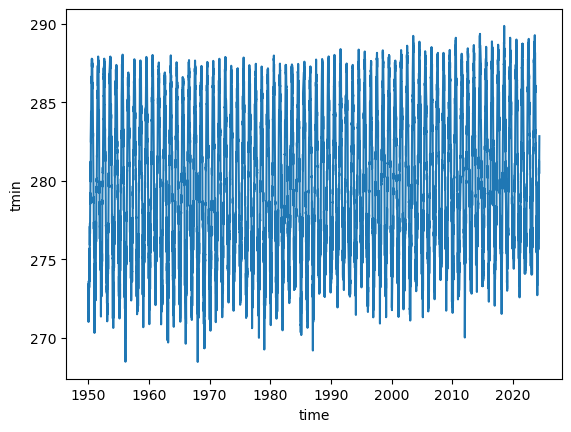

In [15]:
tasmin.mean(('lat', 'lon')).plot()

In [16]:
# Calculate daily climatology
daily_climatology = tasmin_uk.groupby('time.dayofyear').mean('time')

In [17]:
tasmin_anom = tasmin_uk.groupby('time.dayofyear').apply(lambda row: row - daily_climatology.sel(dayofyear=row.time[0].dt.dayofyear))

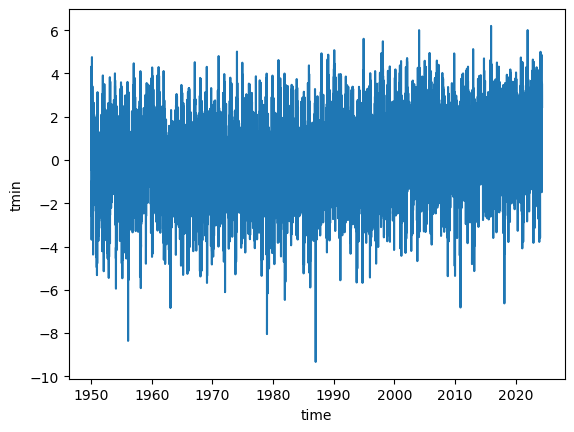

In [57]:
tasmin_anom.mean(('lat', 'lon')).plot()

In [19]:
def detrend_dim(da, dim, deg=1):
    # detrend along a single dimension
    p = da.polyfit(dim=dim, deg=deg)
    fit = xr.polyval(da[dim], p.polyfit_coefficients)
    return da - fit

def detrend(da, dims, deg=1):
    # detrend along multiple dimensions
    # only valid for linear detrending (deg=1)
    da_detrended = da
    for dim in dims:
        da_detrended = detrend_dim(da_detrended, dim, deg=deg)
    return da_detrended

In [20]:
tasmin_anom_detrended = detrend(tasmin_anom, dims=('time', ))

In [62]:
tasmin_anom_detrended

<xarray.DataArray (time: 27169, lat: 45, lon: 49)> Size: 479MB
array([[[ 2.5696456 ,  2.64067592,  2.73720821, ...,  3.38927692,
          3.49757448,  3.60177801],
        [ 2.73516008,  2.7907718 ,  2.86109131, ...,  3.55645009,
          3.59602104,  3.69787296],
        [ 2.88217195,  2.90757362,  2.95430683, ...,  3.62270304,
          3.69867665,  3.76215157],
        ...,
        [ 1.67909457,  1.64815   ,  1.67291432, ..., -3.70657109,
         -3.40061404, -3.46120282],
        [ 1.50987155,  1.58051015,  1.63415103, ..., -3.54452465,
         -3.33866151, -3.40001788],
        [ 1.42781654,  1.51460313,  1.60134052, ..., -3.40645968,
         -3.10676418, -3.13184936]],

       [[ 2.83464274,  2.85830935,  2.89746814, ...,  2.51667879,
          2.59714391,  2.72865863],
        [ 2.93301791,  2.93815304,  2.96193268, ...,  2.6644104 ,
          2.74316585,  2.8164211 ],
        [ 3.00712306,  2.98671713,  2.99222044, ...,  2.8425393 ,
          2.94707707,  2.98775418],
...
        [ 1.68720627,  1.68473554,  1.85165365, ..., -0.58952294,
         -0.86968932, -0.67427285],
        [ 1.70009   ,  1.71859361,  1.81232136, ..., -0.40543886,
         -0.59967634, -1.40690903],
        [ 1.69016533,  1.70109751,  1.79112127, ..., -0.33104266,
         -0.54501402, -1.16742302]],

       [[ 2.46742959,  2.34934091,  2.24469115, ...,  1.93177386,
          2.0590391 ,  2.10748058],
        [ 2.10483207,  2.01187329,  2.02196248, ...,  2.02802968,
          2.23464466,  2.24488466],
        [ 2.09554534,  2.22477888,  2.26568854, ...,  1.90299762,
          2.19991056,  2.16622039],
        ...,
        [ 1.54236897,  1.48377548,  1.49255064, ..., -0.23165757,
         -0.16822662, -0.4716818 ],
        [ 1.59446813,  1.45684304,  1.34616328, ..., -0.61675688,
         -0.41884364, -1.05688695],
        [ 1.49152621,  1.54506013,  1.38972171, ..., -1.39254974,
         -1.41053695, -1.83268928]]])
Coordinates:
  * time       (time) datetime64[ns] 217kB 1950-01-01T12:00:00 ... 2024-05-20...
  * lon        (lon) float64 392B -8.0 -7.75 -7.5 -7.25 ... 3.25 3.5 3.75 4.0
  * lat        (lat) float64 360B 60.0 59.75 59.5 59.25 ... 49.5 49.25 49.0
    dayofyear  (time) int64 217kB 1 2 3 4 5 6 7 ... 135 136 137 138 139 140 141

In [65]:
tasmin_anom_smoothed = tasmin_anom.rolling(time=360*3).mean().mean(('lat', 'lon'))
tasmin_anom_detrended_smoothed = tasmin_anom_detrended.rolling(time=360*3).mean().mean(('lat', 'lon'))

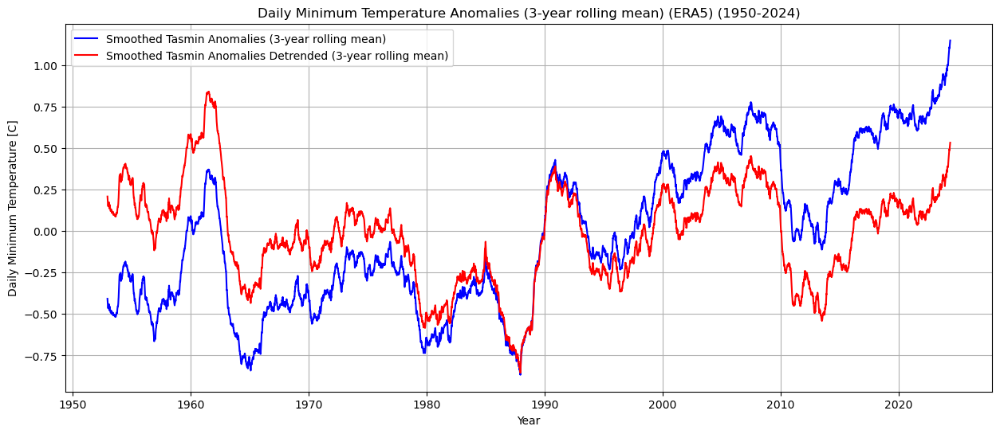

In [67]:
# Plotting the data
fig, ax = plt.subplots(figsize=(15, 6))

# Plot the cold event temperatures (mean across 'quantile' dimension if applicable)
tasmin_anom_smoothed.plot(ax=ax, label='Smoothed Tasmin Anomalies (3-year rolling mean)', color='blue')

# Plot the winter cold event temperatures (mean across 'quantile' dimension if applicable)
tasmin_anom_detrended_smoothed.plot(ax=ax, label='Smoothed Tasmin Anomalies Detrended (3-year rolling mean)', color='red')

# Customize the plot
ax.grid(True)
ax.set_xlabel('Year')
ax.set_ylabel('Daily Minimum Temperature [C]')
ax.set_title('Daily Minimum Temperature Anomalies (3-year rolling mean) (ERA5) (1950-2024)')

# Add a legend
ax.legend()

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/ERA5_tasmin_Anomalies_smoothed_comparison.png', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

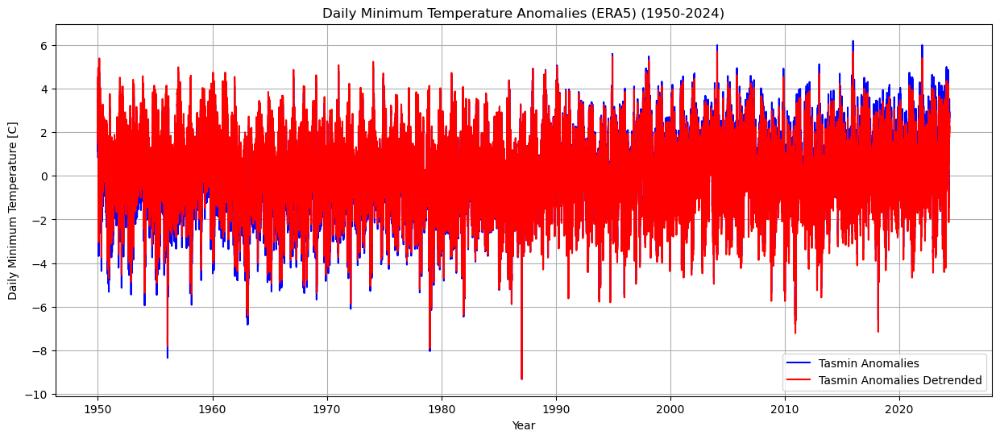

In [69]:
# Plotting the data
fig, ax = plt.subplots(figsize=(15, 6))

# Plot the cold event temperatures (mean across 'quantile' dimension if applicable)
tasmin_anom.mean(('lat', 'lon')).plot(ax=ax, label='Tasmin Anomalies', color='blue')

# Plot the winter cold event temperatures (mean across 'quantile' dimension if applicable)
tasmin_anom_detrended.mean(('lat', 'lon')).plot(ax=ax, label='Tasmin Anomalies Detrended', color='red')

# Customize the plot
ax.grid(True)
ax.set_xlabel('Year')
ax.set_ylabel('Daily Minimum Temperature [C]')
ax.set_title('Daily Minimum Temperature Anomalies (ERA5) (1950-2024)')

# Add a legend
ax.legend()

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/ERA5_tasmin_Anomalies_comparison.png', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

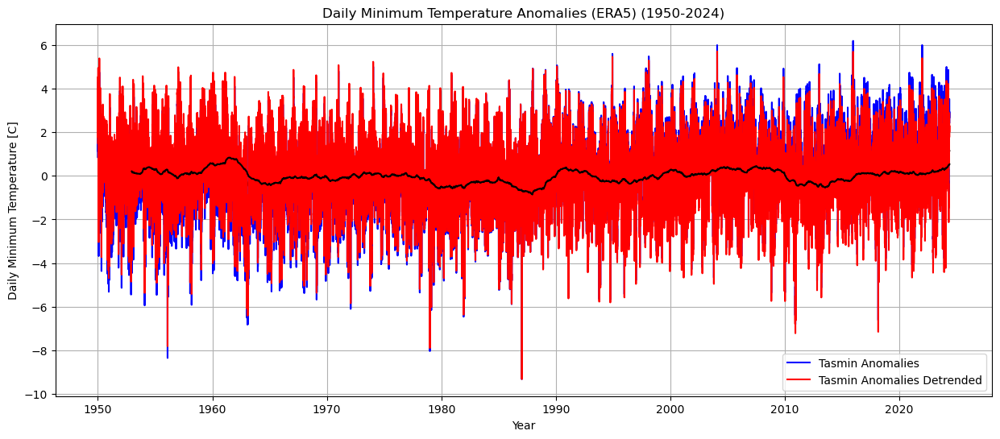

In [1155]:
# Plotting the data
fig, ax = plt.subplots(figsize=(15, 6))

# Plot the cold event temperatures (mean across 'quantile' dimension if applicable)
tasmin_anom.mean(('lat', 'lon')).plot(ax=ax, label='Tasmin Anomalies', color='blue')
tasmin_anom_smoothed.plot(ax=ax, color='black')

# Plot the winter cold event temperatures (mean across 'quantile' dimension if applicable)
tasmin_anom_detrended.mean(('lat', 'lon')).plot(ax=ax, label='Tasmin Anomalies Detrended', color='red')
tasmin_anom_detrended_smoothed.plot(ax=ax, color='black')

# Customize the plot
ax.grid(True)
ax.set_xlabel('Year')
ax.set_ylabel('Daily Minimum Temperature [C]')
ax.set_title('Daily Minimum Temperature Anomalies (ERA5) (1950-2024)')

# Add a legend
ax.legend()

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/ERA5_tasmin_Anomalies_with_smoothed_comparison.png', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

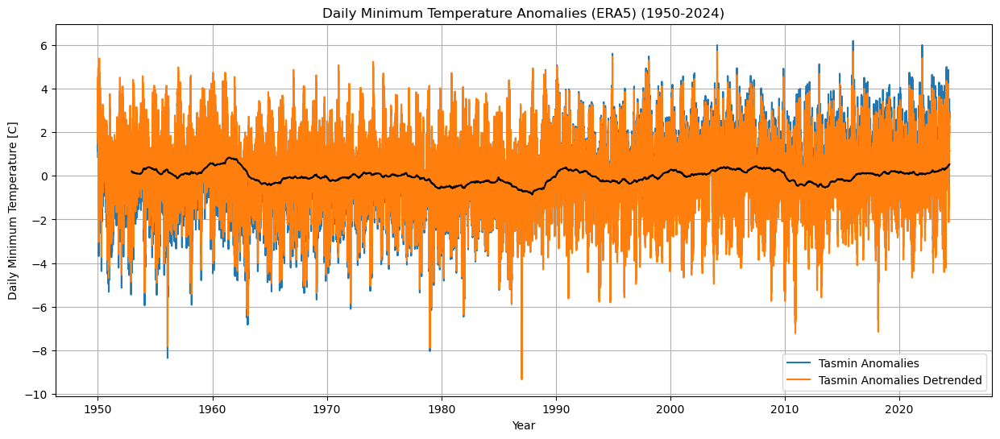

In [260]:
# Plotting the data
fig, ax = plt.subplots(figsize=(15, 6))

# Plot the cold event temperatures (mean across 'quantile' dimension if applicable)
tasmin_anom.mean(('lat', 'lon')).plot(ax=ax, label='Tasmin Anomalies', color='C0')
tasmin_anom_smoothed.plot(ax=ax, color='black')

# Plot the winter cold event temperatures (mean across 'quantile' dimension if applicable)
tasmin_anom_detrended.mean(('lat', 'lon')).plot(ax=ax, label='Tasmin Anomalies Detrended', color='C1')
tasmin_anom_detrended_smoothed.plot(ax=ax, color='black')

# Customize the plot
ax.grid(True)
ax.set_xlabel('Year')
ax.set_ylabel('Daily Minimum Temperature [C]')
ax.set_title('Daily Minimum Temperature Anomalies (ERA5) (1950-2024)')

# Add a legend
ax.legend()

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/ERA5_tasmin_Anomalies_with_smoothed_comparison_C.png', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

# 1.3 Original Baseline

In [9]:
#Set as anomalies from 1981-2010
baseline=tasmin.sel(time=slice('1981-01-01', '2010-12-30'))
#baseline.load()
climatology = baseline.groupby("time.dayofyear").mean("time")
tasminA_hist = tasmin.groupby("time.dayofyear") - climatology

In [28]:
%%time
tasminA_hist.load()

CPU times: total: 3min 27s
Wall time: 8min 50s


<xarray.DataArray 'tmin' (time: 27169, lat: 181, lon: 281)> Size: 6GB
array([[[ 2.17593384e+00,  2.06797791e+00,  2.00282288e+00, ...,
          1.01599121e+00,  9.44549561e-01,  8.50372314e-01],
        [ 2.20780945e+00,  2.08891296e+00,  1.97908020e+00, ...,
          1.34075928e+00,  1.28207397e+00,  1.22915649e+00],
        [ 1.92269897e+00,  1.81103516e+00,  1.70561218e+00, ...,
          1.59149170e+00,  1.52917480e+00,  1.47134399e+00],
        ...,
        [ 4.87762451e-01,  3.90502930e-01,  2.73437500e-01, ...,
         -1.82711792e+00, -1.83795166e+00, -1.73074341e+00],
        [ 5.20935059e-01,  4.16564941e-01,  3.03436279e-01, ...,
         -1.90228271e+00, -2.05291748e+00, -2.07754517e+00],
        [ 5.76995850e-01,  4.40490723e-01,  2.96691895e-01, ...,
         -1.91226196e+00, -1.98672485e+00, -1.82525635e+00]],

       [[-1.28541565e+00, -1.14030457e+00, -1.03349304e+00, ...,
          1.64364624e+00,  1.57550049e+00,  1.48300171e+00],
        [-1.19523621e+00, -1.07598877e+00, -9.41146851e-01, ...,
          2.16271973e+00,  2.12786865e+00,  2.09783936e+00],
        [-1.02124023e+00, -9.12506104e-01, -7.65686035e-01, ...,
          1.65301514e+00,  1.59826660e+00,  1.54971313e+00],
...
          1.95068359e+00,  2.38726807e+00,  2.44046021e+00],
        [ 1.68225098e+00,  1.66848755e+00,  1.56716919e+00, ...,
          1.45291138e+00,  1.82586670e+00,  2.65716553e+00],
        [ 1.68249512e+00,  1.55514526e+00,  1.50958252e+00, ...,
          1.57977295e+00,  2.23394775e+00,  2.23822021e+00]],

       [[-2.05638123e+00, -1.94775391e+00, -1.93218994e+00, ...,
          5.50933838e-01,  6.23474121e-01,  6.97967529e-01],
        [-2.69215393e+00, -2.62527466e+00, -2.53237915e+00, ...,
          7.70294189e-01,  8.15521240e-01,  8.60656738e-01],
        [-2.90757751e+00, -2.72706604e+00, -2.75300598e+00, ...,
          8.78753662e-01,  9.28649902e-01,  9.29382324e-01],
        ...,
        [ 1.53610229e+00,  1.81765747e+00,  1.55691528e+00, ...,
          4.78305054e+00,  4.25088501e+00,  3.42459106e+00],
        [ 1.83163452e+00,  1.81597900e+00,  1.72933960e+00, ...,
          4.64163208e+00,  3.76580811e+00,  1.99017334e+00],
        [ 2.02597046e+00,  2.05102539e+00,  1.53918457e+00, ...,
          3.73086548e+00,  2.78186035e+00,  2.96649170e+00]]],
      dtype=float32)
Coordinates:
  * time       (time) datetime64[ns] 217kB 1950-01-01T12:00:00 ... 2024-05-20...
  * lon        (lon) float64 2kB -30.0 -29.75 -29.5 -29.25 ... 39.5 39.75 40.0
  * lat        (lat) float64 1kB 75.0 74.75 74.5 74.25 ... 30.75 30.5 30.25 30.0
    dayofyear  (time) int64 217kB 1 2 3 4 5 6 7 ... 135 136 137 138 139 140 141

In [16]:
#Create some 5 year smoothed versions (60 months)
tasminA_hist=tasminA_hist.chunk(2010) #re-chunking array to avoid error on next line
tasminA_hist_smoothed=tasminA_hist.rolling(time=60,center=True).mean(dim=('time'))

In [18]:
tasminA_hist_adjusted = tasminA_hist - tasminA_hist_smoothed

In [20]:
tasminA_hist_adjusted_djf = tasminA_hist_adjusted.sel(time=tasminA_hist['time.month'].isin([12, 1, 2]))

In [22]:
tasminA_hist_adjusted_djf

<xarray.DataArray 'tmin' (time: 6738, lat: 181, lon: 281)> Size: 1GB
dask.array<getitem, shape=(6738, 181, 281), dtype=float32, chunksize=(510, 181, 281), chunktype=numpy.ndarray>
Coordinates:
  * time       (time) datetime64[ns] 54kB 1950-01-01T12:00:00 ... 2024-02-29T...
  * lon        (lon) float64 2kB -30.0 -29.75 -29.5 -29.25 ... 39.5 39.75 40.0
  * lat        (lat) float64 1kB 75.0 74.75 74.5 74.25 ... 30.75 30.5 30.25 30.0
    dayofyear  (time) int64 54kB dask.array<chunksize=(510,), meta=np.ndarray>

# 2. Calculate 10th Percentile from anomalies

In [24]:
%%time 
tasmim_10thp_adjusted = tasmin_anom_detrended.quantile(q=[0.1], dim='time', method='linear')

CPU times: total: 2.23 s
Wall time: 2.44 s


In [114]:
# Save the xarray Dataset as a NetCDF file
tasmim_10thp_adjusted.to_netcdf('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/tasmim_10thp_adjusted.nc')

print("tasmim_10thp_adjusted saved as 'tasmim_10thp_adjusted.nc'")

tasmim_10thp_adjusted saved as 'tasmim_10thp_adjusted.nc'


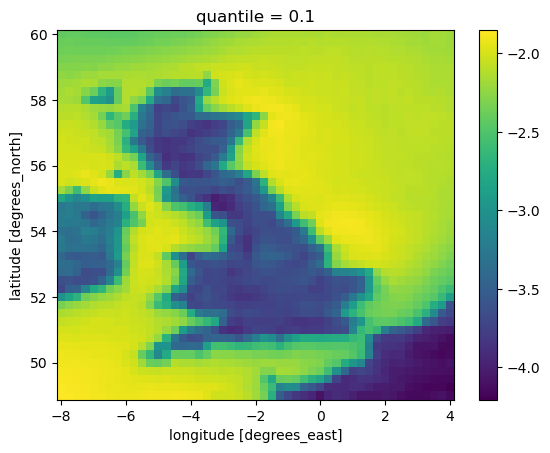

In [28]:
tasmim_10thp_adjusted.plot()

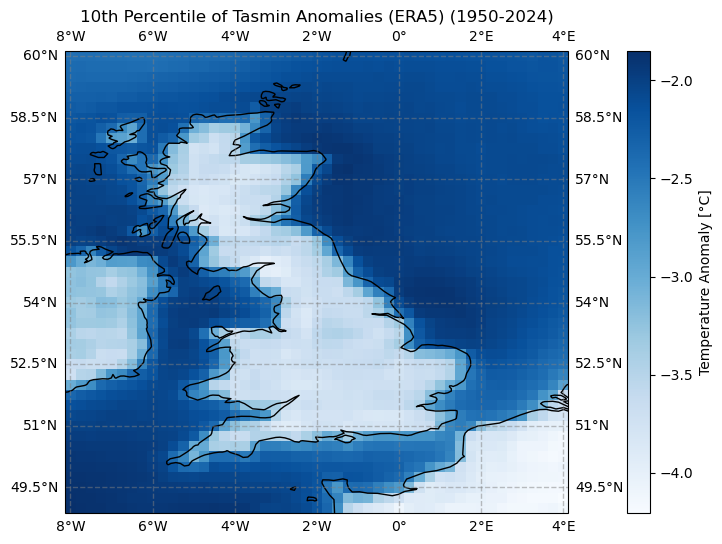

In [83]:
import cartopy.crs as ccrs

# Extract the 2D data for the quantile level (0.1)
data_2d = tasmim_10thp_adjusted.sel(quantile=0.1).values

# Get latitude and longitude values
lat = tasmim_10thp_adjusted.lat.values
lon = tasmim_10thp_adjusted.lon.values

# Create a meshgrid for plotting
lon, lat = np.meshgrid(lon, lat)

# Create a figure and an axis with Cartopy
fig, ax = plt.subplots(figsize=(15, 6), subplot_kw={'projection': ccrs.PlateCarree()})

# Plot using pcolormesh
c = ax.pcolormesh(lon, lat, data_2d, cmap='Blues', shading='auto', transform=ccrs.PlateCarree())

# Add coastlines and gridlines
ax.coastlines(resolution='50m')
ax.gridlines(draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='--')

# Add a colorbar
cbar = plt.colorbar(c, ax=ax, orientation='vertical')
cbar.set_label('Temperature Anomaly [°C]')

# Set title and labels
ax.set_title('10th Percentile of Tasmin Anomalies (ERA5) (1950-2024)')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# Optionally, save the plot to a file
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/10th_percentile_plot_blues.png', dpi=300)

# Display the plot
plt.show()


# 3. Compare all tasmin anomalies to 10th percentile

In [26]:
tasbelow10_adjusted = tasmin_anom_detrended < tasmim_10thp_adjusted

In [28]:
tasbelow10 = tasbelow10_adjusted.astype(int) 

# spatial adjustment

In [30]:
# Subset the data to only include the UK region
tasbelow10_uk = tasbelow10.sel(lat=slice(49, 60), lon=slice(-8, 4))

# 4. Calculate 10th percentile coverage and % coverage

In [44]:
%%time
tasbelow10_coverage = tasbelow10.sum(dim=('lat', 'lon'))

CPU times: total: 0 ns
Wall time: 33.3 ms


In [ ]:
tasbelow10_coverage.load()

In [46]:
tasbelow10_per_coverage = tasbelow10_coverage/(36*37)

# 5. Calculate 95th percentile coverage and % coverage

In [ ]:
%%time 
tasmim_95thp_hist_adjusted = tasminA_hist_adjusted.quantile(q=[0.95], dim='time', method='linear')

In [ ]:
tasmim_95thp_hist_adjusted.plot()

In [ ]:
tasbelow95_adjusted = tasminA_hist_adjusted < tasmim_95thp_hist_adjusted

In [ ]:
tasbelow95 = tasbelow95_adjusted.astype(int) 

In [ ]:
%%time
tasbelow95_coverage = tasbelow95.sum(dim=('lat', 'lon'))

In [ ]:
tasbelow95_coverage.load()

# 5.1 Compare below 10th percentile array to 95th coverage

In [60]:
tasbelow10_coverage

<xarray.DataArray 'tmin' (time: 27169, quantile: 1)> Size: 109kB
dask.array<sum-aggregate, shape=(27169, 1), dtype=int32, chunksize=(2010, 1), chunktype=numpy.ndarray>
Coordinates:
  * time       (time) datetime64[ns] 217kB 1950-01-01T12:00:00 ... 2024-05-20...
    dayofyear  (time) int64 217kB dask.array<chunksize=(2010,), meta=np.ndarray>
  * quantile   (quantile) float64 8B 0.1

# 6. Count of days below 10th percentile

In [32]:
tasbelow10_djf = tasbelow10.sel(time=tasbelow10['time.month'].isin([12, 1, 2]))

In [34]:
tasbelow10_djf_count = tasbelow10_djf.groupby('time.year').sum(dim='time')

In [36]:
# Reduce spatial dimensions by averaging over 'lat' and 'lon'
tasbelow10_djf_count_TS = tasbelow10_djf_count.mean(dim=['lat', 'lon'])

Text(0.5, 1.0, 'Number of days Daily Minimum Near Surface Air Temperature is below 10th percentile (DJF, ERA5) (1950-2024)')

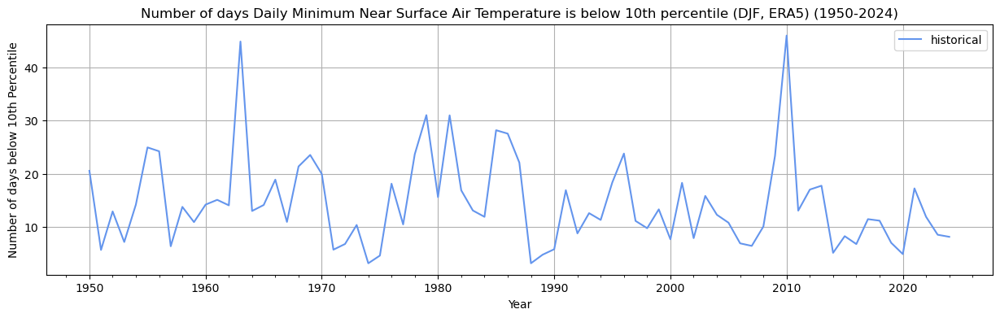

In [101]:
# Create a line plot of annual mean surface temperature anomalies over Northern Europe
fig, ax = matplotlib.pyplot.subplots(figsize=(15,4))
tasbelow10_djf_count_TS.plot(ax=ax, label='historical',color='cornflowerblue')


ax.grid()
ax.xaxis.set_minor_locator(AutoMinorLocator())   
ax.legend(loc='best') 
ax.set(xlabel='Year',ylabel='Number of days below 10th Percentile')
matplotlib.pyplot.title('Number of days Daily Minimum Near Surface Air Temperature is below 10th percentile (DJF, ERA5) (1950-2024)')


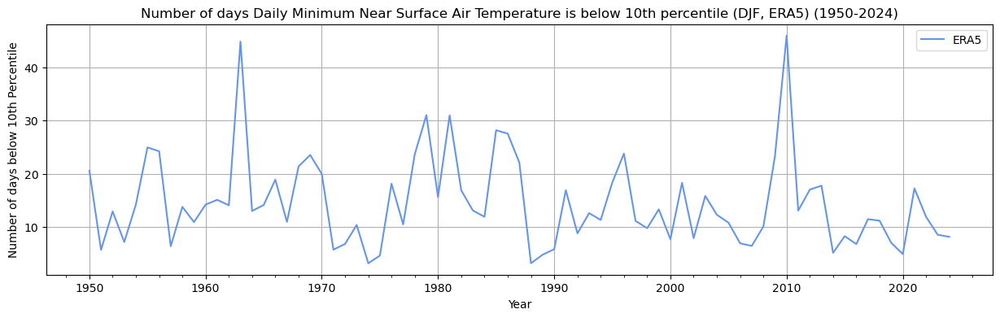

In [103]:
fig, ax = plt.subplots(figsize=(15, 4))
tasbelow10_djf_count_TS.plot(ax=ax, label='ERA5',color='cornflowerblue')

ax.grid()
ax.xaxis.set_minor_locator(AutoMinorLocator())
ax.legend(loc='best')
ax.set(xlabel='Year', ylabel='Number of days below 10th Percentile')
plt.title('Number of days Daily Minimum Near Surface Air Temperature is below 10th percentile (DJF, ERA5) (1950-2024)')

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/Tasbelow10_plot.png', dpi=300, bbox_inches='tight')

# Show the plot (optional)
plt.show()

In [40]:
print(tasbelow10_djf_count_TS)

<xarray.DataArray (year: 75, quantile: 1)> Size: 600B
array([[20.57324263],
       [ 5.68843537],
       [12.93106576],
       [ 7.18412698],
       [14.21723356],
       [24.96734694],
       [24.2399093 ],
       [ 6.3814059 ],
       [13.78639456],
       [10.92426304],
       [14.21269841],
       [15.10929705],
       [14.07573696],
       [44.87528345],
       [13.01632653],
       [14.14104308],
       [18.90657596],
       [10.95646259],
       [21.38956916],
       [23.55056689],
...
       [10.80861678],
       [ 6.93015873],
       [ 6.44761905],
       [10.09160998],
       [23.35963719],
       [45.99818594],
       [13.07755102],
       [17.0399093 ],
       [17.76553288],
       [ 5.14739229],
       [ 8.27573696],
       [ 6.79183673],
       [11.47891156],
       [11.18911565],
       [ 7.02675737],
       [ 4.91111111],
       [17.26122449],
       [11.92199546],
       [ 8.54603175],
       [ 8.15555556]])
Coordinates:
  * quantile  (quantile) float64 8B 0.1
  * year

In [105]:
tasbelow10_count_annual = tasbelow10.groupby('time.year').sum(dim='time')

In [107]:
# Reduce spatial dimensions by averaging over 'lat' and 'lon'
tasbelow10_count_annual_TS = tasbelow10_count_annual.mean(dim=['lat', 'lon'])

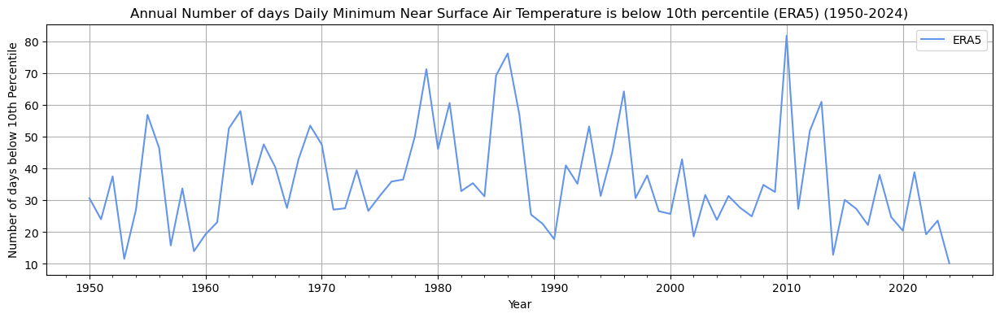

In [1151]:
fig, ax = plt.subplots(figsize=(15, 4))
tasbelow10_count_annual_TS.plot(ax=ax, label='ERA5',color='cornflowerblue')

ax.grid()
ax.xaxis.set_minor_locator(AutoMinorLocator())
ax.legend(loc='best')
ax.set(xlabel='Year', ylabel='Number of days below 10th Percentile')
plt.title('Annual Number of days Daily Minimum Near Surface Air Temperature is below 10th percentile (ERA5) (1950-2024)')

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/Tasbelow10_annual_plot.png', dpi=300, bbox_inches='tight')

# Show the plot (optional)
plt.show()

# 7. Convert to Binary data¶

In [46]:
# Convert the data to binary format 
binary_data = (tasbelow10 > 0).astype(int)

# Sum over the spatial dimensions (lat, lon) to get a 1D time series of cold days
binary_data_reduced = binary_data.sum(dim=['lat', 'lon'])

In [30]:
# Convert the xarray DataArray to a numpy array
binary_array = binary_data_reduced.values

print(binary_array)

[[111]
 [ 67]
 [  0]
 ...
 [  0]
 [  0]
 [  2]]


# 8. Calculate Consecutive days¶

In [42]:
# Ensure binary_array is 1-dimensional
if not isinstance(binary_array, np.ndarray):
    binary_array = np.array(binary_array)
elif binary_array.ndim != 1:
    binary_array = binary_array.flatten()

In [172]:
total_grid_cells = binary_data.shape[2] * binary_data.shape[3]  # Number of grid cells
threshold = int(total_grid_cells * 0.75)  # 5% of grid cells

In [174]:
# Modify how you reduce the data - consider using a threshold
#threshold = 10  # Number of grid cells that must be below the 10th percentile
binary_data_reduced = (binary_data.sum(dim=['lat', 'lon']) >= threshold).astype(int)

binary_array = binary_data_reduced.values.flatten()

# Identify periods of at least 2 consecutive cold days
periods = []
start_index = None
for i in range(len(binary_array)):
    if binary_array[i] == 1:
        if start_index is None:
            start_index = i
        end_index = i
    else:
        if start_index is not None and (end_index - start_index + 1) >= 3:
            periods.append((start_index, end_index))
        start_index = None

if start_index is not None and (end_index - start_index + 1) >= 3:
    periods.append((start_index, end_index))

print("Identified periods:", periods)

Identified periods: [(18, 31), (42, 44), (53, 60), (70, 73), (102, 106), (112, 118), (135, 139), (280, 282), (296, 304), (307, 310), (315, 321), (327, 331), (333, 339), (344, 368), (390, 394), (397, 401), (403, 406), (419, 424), (426, 436), (441, 444), (446, 454), (463, 465), (467, 477), (480, 486), (490, 497), (514, 526), (588, 592), (645, 649), (654, 663), (692, 694), (707, 711), (729, 733), (737, 742), (744, 746), (748, 761), (763, 765), (769, 773), (788, 790), (814, 823), (878, 881), (895, 897), (976, 983), (990, 995), (1000, 1004), (1006, 1011), (1013, 1025), (1040, 1043), (1045, 1074), (1077, 1083), (1090, 1094), (1096, 1104), (1106, 1110), (1116, 1119), (1128, 1143), (1156, 1160), (1162, 1164), (1168, 1171), (1187, 1195), (1198, 1200), (1208, 1211), (1224, 1228), (1248, 1253), (1395, 1397), (1421, 1423), (1460, 1463), (1465, 1468), (1483, 1506), (1508, 1511), (1516, 1523), (1527, 1529), (1533, 1537), (1556, 1558), (1570, 1572), (1578, 1582), (1645, 1649), (1686, 1689), (1723, 17

In [67]:
# Initialize variables
start_index = None
periods = []

# Identify periods of at least 3 consecutive cold days
for i in range(len(binary_array)):
    if binary_array[i] == 1:
        if start_index is None:
            start_index = i  # Start of a new period
        end_index = i
    else:
        if start_index is not None and (end_index - start_index + 1) >= 3:
            periods.append((start_index, end_index))
        start_index = None  # Reset for the next potential period

# If the last period extends to the end of the array
if start_index is not None and (end_index - start_index + 1) >= 3:
    periods.append((start_index, end_index))

In [46]:
# Initialize variables
start_index = None
end_index = None
periods = []

# Identify periods of at least 3 consecutive cold days
for i in range(len(binary_array)):
    if binary_array[i] == 1:
        if start_index is None:
            start_index = i  # Start of a new period
        end_index = i
    else:
        if start_index is not None and (end_index - start_index + 1) >= 2:
            periods.append((start_index, end_index))
        start_index = None  # Reset for the next potential period

# If the last period extends to the end of the array
if start_index is not None and (end_index - start_index + 1) >= 2:
    periods.append((start_index, end_index))

print("Identified periods:", periods)


Identified periods: [(172, 173), (2109, 2110), (2753, 2754), (2951, 2952), (9170, 9171), (9664, 9665), (9941, 9942), (11531, 11532), (13493, 13494), (16222, 16223), (16443, 16444), (18832, 18833), (19073, 19074), (19620, 19621), (20365, 20366), (24837, 24838), (27154, 27155)]


In [176]:
periods

[(18, 31),
 (42, 44),
 (53, 60),
 (70, 73),
 (102, 106),
 (112, 118),
 (135, 139),
 (280, 282),
 (296, 304),
 (307, 310),
 (315, 321),
 (327, 331),
 (333, 339),
 (344, 368),
 (390, 394),
 (397, 401),
 (403, 406),
 (419, 424),
 (426, 436),
 (441, 444),
 (446, 454),
 (463, 465),
 (467, 477),
 (480, 486),
 (490, 497),
 (514, 526),
 (588, 592),
 (645, 649),
 (654, 663),
 (692, 694),
 (707, 711),
 (729, 733),
 (737, 742),
 (744, 746),
 (748, 761),
 (763, 765),
 (769, 773),
 (788, 790),
 (814, 823),
 (878, 881),
 (895, 897),
 (976, 983),
 (990, 995),
 (1000, 1004),
 (1006, 1011),
 (1013, 1025),
 (1040, 1043),
 (1045, 1074),
 (1077, 1083),
 (1090, 1094),
 (1096, 1104),
 (1106, 1110),
 (1116, 1119),
 (1128, 1143),
 (1156, 1160),
 (1162, 1164),
 (1168, 1171),
 (1187, 1195),
 (1198, 1200),
 (1208, 1211),
 (1224, 1228),
 (1248, 1253),
 (1395, 1397),
 (1421, 1423),
 (1460, 1463),
 (1465, 1468),
 (1483, 1506),
 (1508, 1511),
 (1516, 1523),
 (1527, 1529),
 (1533, 1537),
 (1556, 1558),
 (1570, 1572),

In [177]:
len(periods)

1332

In [240]:
# Extract the time dimension from the xarray DataArray
con_days = tasbelow10['time']

In [242]:
# Initialize an empty list to store cold events
cold_events = []

# Iterate through each period and extract the data
for ind, period in enumerate(periods):
    print("Cold event", ind)
    cold_event_data = con_days.isel(time=slice(period[0], period[1] + 1)).data
    print(cold_event_data)
    cold_events.append(cold_event_data)

Cold event 0
['1950-01-19T12:00:00.000000000' '1950-01-20T12:00:00.000000000'
 '1950-01-21T12:00:00.000000000' '1950-01-22T12:00:00.000000000'
 '1950-01-23T12:00:00.000000000' '1950-01-24T12:00:00.000000000'
 '1950-01-25T12:00:00.000000000' '1950-01-26T12:00:00.000000000'
 '1950-01-27T12:00:00.000000000' '1950-01-28T12:00:00.000000000'
 '1950-01-29T12:00:00.000000000' '1950-01-30T12:00:00.000000000'
 '1950-01-31T12:00:00.000000000' '1950-02-01T12:00:00.000000000']
Cold event 1
['1950-02-12T12:00:00.000000000' '1950-02-13T12:00:00.000000000'
 '1950-02-14T12:00:00.000000000']
Cold event 2
['1950-02-23T12:00:00.000000000' '1950-02-24T12:00:00.000000000'
 '1950-02-25T12:00:00.000000000' '1950-02-26T12:00:00.000000000'
 '1950-02-27T12:00:00.000000000' '1950-02-28T12:00:00.000000000'
 '1950-03-01T12:00:00.000000000' '1950-03-02T12:00:00.000000000']
Cold event 3
['1950-03-12T12:00:00.000000000' '1950-03-13T12:00:00.000000000'
 '1950-03-14T12:00:00.000000000' '1950-03-15T12:00:00.000000000']
C

In [ ]:
con_days= binary_data.isel(time=slice(0, len(binary_array))).time

In [ ]:
con_days

# 9. Calculate Coldwaves

In [60]:
# Create a binary array marking the cold events
cold_event_dates = [date for sublist in cold_events for date in sublist]
cold_event_binary = xr.DataArray(np.isin(tasmin['time'], cold_event_dates).astype(int), dims=['time'], coords={'time': tasmin['time']})


In [62]:
# Combine tasmin with cold_event_binary
ds_combined = xr.Dataset({'tasmin': tasmin_uk, 'cold_events': cold_event_binary})

In [64]:
ds_combined_year = ds_combined.groupby("time.year").mean("time")

In [66]:
ds_combined_count = ds_combined.groupby("time.year").sum("time")

Text(0.5, 1.0, 'Annual Number of winter coldwave days (DJF, ERA5) (1950-2024)')

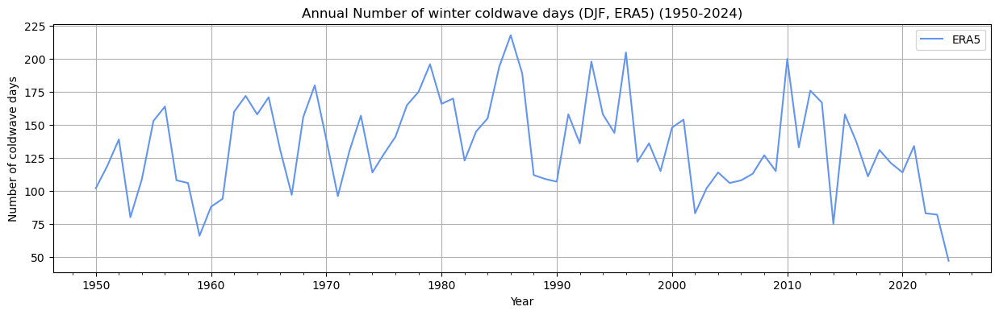

In [70]:
# Create a line plot of annual mean surface temperature anomalies over Northern Europe
fig, ax = matplotlib.pyplot.subplots(figsize=(15,4))
ds_combined_count['cold_events'].plot(ax=ax, label='ERA5',color='cornflowerblue')


ax.grid()
ax.xaxis.set_minor_locator(AutoMinorLocator())   
ax.legend(loc='best') 
ax.set(xlabel='Year',ylabel='Number of coldwave days')
matplotlib.pyplot.title('Annual Number of winter coldwave days (DJF, ERA5) (1950-2024)')

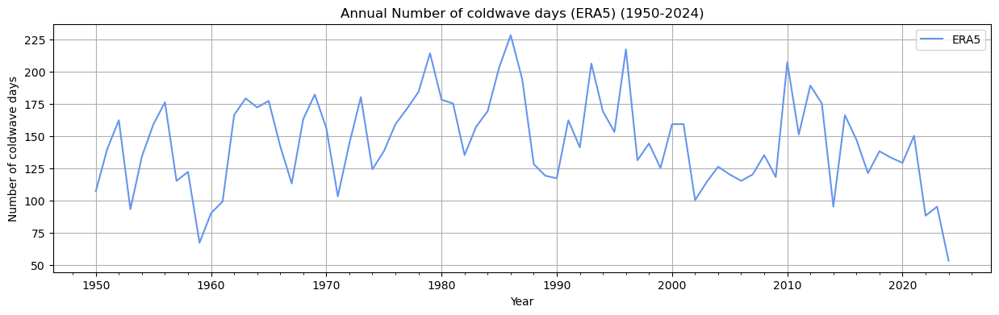

In [129]:
fig, ax = plt.subplots(figsize=(15, 4))
ds_combined_count['cold_events'].plot(ax=ax, label='ERA5',color='cornflowerblue')

ax.grid()
ax.xaxis.set_minor_locator(AutoMinorLocator())
ax.legend(loc='best')
ax.set(xlabel='Year', ylabel='Number of coldwave days')
plt.title('Annual Number of coldwave days (ERA5) (1950-2024)')

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/Annual_coldwave_days.png', dpi=300, bbox_inches='tight')

# Show the plot (optional)
plt.show()

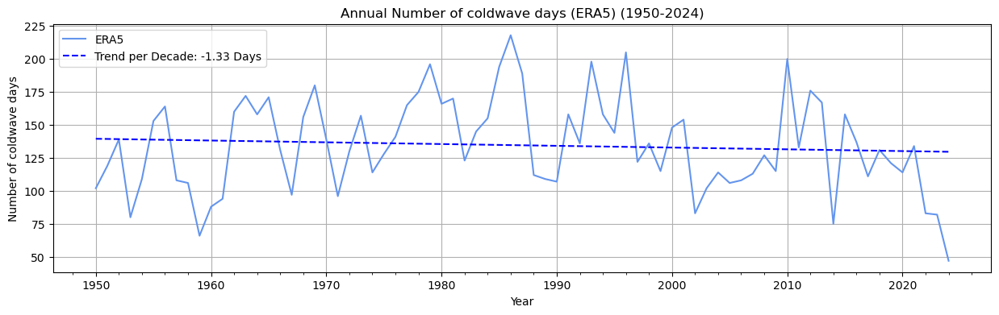

In [76]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import AutoMinorLocator

# Extract year and cold_events data
x = ds_combined_count['year'].values
y = ds_combined_count['cold_events'].values

# Perform linear regression to get the annual trendline
slope, intercept = np.polyfit(x, y, 1)

# Convert the slope to a decadal trend
decadal_slope = slope * 10
trendline = slope * x + intercept

# Plotting the data
fig, ax = plt.subplots(figsize=(15, 4))
ax.plot(x, y, label='ERA5', color='cornflowerblue')

# Plot the regression line for the annual trend
ax.plot(x, trendline, label=f'Trend per Decade: {decadal_slope:.2f} Days', color='blue', linestyle='--')

# Enhancing the plot
ax.grid()
ax.xaxis.set_minor_locator(AutoMinorLocator())
ax.legend(loc='best')
ax.set(xlabel='Year', ylabel='Number of coldwave days')
plt.title('Annual Number of coldwave days (ERA5) (1950-2024)')

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/Annual_coldwave_days_with_decadal_trend.png', dpi=300, bbox_inches='tight')

# Show the plot (optional)
plt.show()


In [78]:
ds_combined_djf = ds_combined.sel(time=tasbelow10['time.month'].isin([12, 1, 2]))

In [80]:
ds_combined_count_djf = ds_combined_djf.groupby("time.year").sum("time")

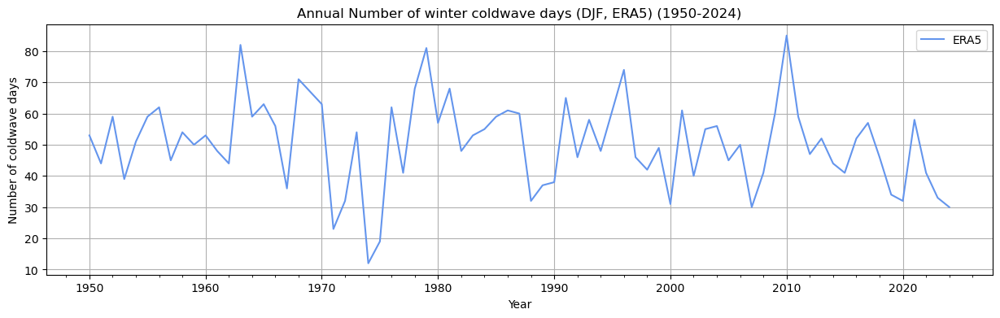

In [131]:
fig, ax = plt.subplots(figsize=(15, 4))
ds_combined_count_djf['cold_events'].plot(ax=ax, label='ERA5',color='cornflowerblue')

ax.grid()
ax.xaxis.set_minor_locator(AutoMinorLocator())
ax.legend(loc='best')
ax.set(xlabel='Year', ylabel='Number of coldwave days')
plt.title('Annual Number of winter coldwave days (DJF, ERA5) (1950-2024)')

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/Annual_winter_coldwave_days.png', dpi=300, bbox_inches='tight')

# Show the plot (optional)
plt.show()

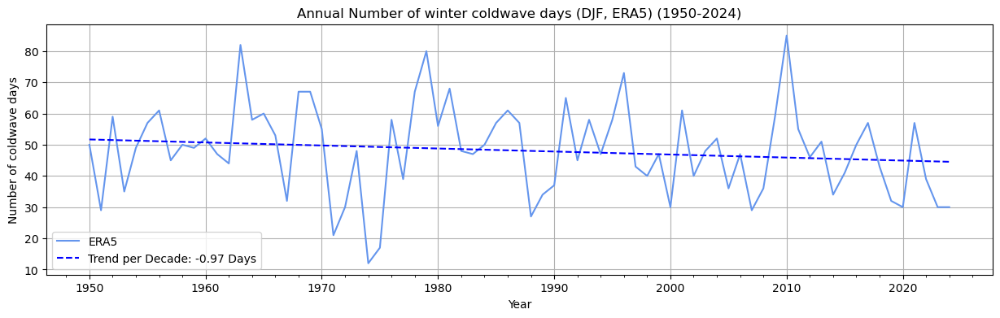

In [84]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import AutoMinorLocator

# Extract year and cold_events data
x = ds_combined_count_djf['year'].values
y = ds_combined_count_djf['cold_events'].values

# Perform linear regression to get the annual trendline
slope, intercept = np.polyfit(x, y, 1)

# Convert the slope to a decadal trend
decadal_slope = slope * 10
trendline = slope * x + intercept

# Plotting the data
fig, ax = plt.subplots(figsize=(15, 4))
ax.plot(x, y, label='ERA5', color='cornflowerblue')

# Plot the regression line for the annual trend
ax.plot(x, trendline, label=f'Trend per Decade: {decadal_slope:.2f} Days', color='blue', linestyle='--')

# Enhancing the plot
ax.grid()
ax.xaxis.set_minor_locator(AutoMinorLocator())
ax.legend(loc='best')
ax.set(xlabel='Year', ylabel='Number of coldwave days')
plt.title('Annual Number of winter coldwave days (DJF, ERA5) (1950-2024)')

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/Annual_winter_coldwave_days_with_decadal_trend.png', dpi=300, bbox_inches='tight')

# Show the plot (optional)
plt.show()


# 10. Tasmin during days below 10th percentile

In [116]:
# Convert the data to binary format 
binary_data_test = (tasbelow10 > 0).astype(int)

In [117]:
# Convert binary_array_ssp245 to boolean for masking
binary_mask = binary_data_test.astype(bool)

# Apply the mask: where binary_array_ssp245 is 0, set tasmin_ssp245_anom to NaN
masked_tasmin = tasmin_anom.where(binary_mask, other=np.nan)

In [135]:
# Reduce spatial dimensions by averaging over 'lat' and 'lon'
masked_tasmin_TS = masked_tasmin.mean(dim=['lat', 'lon'])

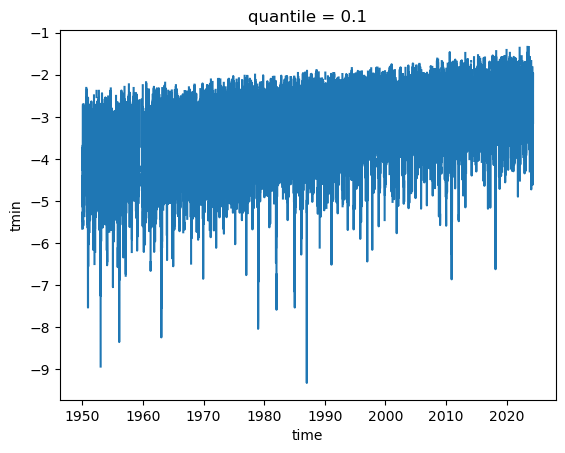

In [162]:
masked_tasmin_TS.plot()

In [119]:
masked_tasmin_djf = masked_tasmin.sel(time=tasbelow10['time.month'].isin([12, 1, 2]))

In [168]:
# Reduce spatial dimensions by averaging over 'lat' and 'lon'
masked_tasmin_djf_TS = masked_tasmin_djf.mean(dim=['lat', 'lon'])

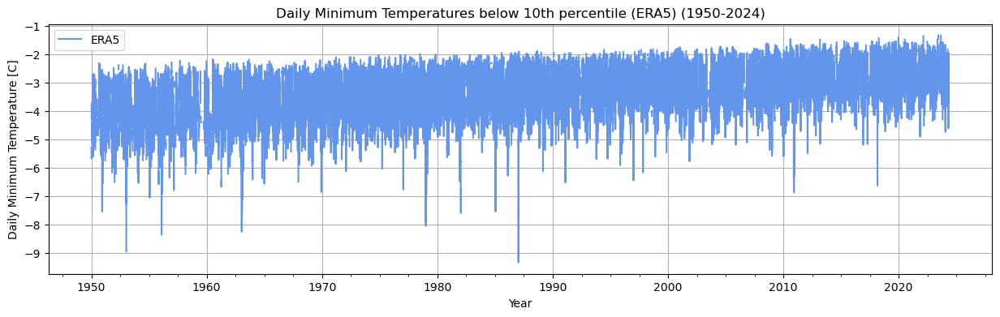

In [170]:
fig, ax = plt.subplots(figsize=(15, 4))
masked_tasmin_TS.plot(ax=ax, label='ERA5',color='cornflowerblue')

ax.grid()
ax.xaxis.set_minor_locator(AutoMinorLocator())
ax.legend(loc='best')
ax.set(xlabel='Year', ylabel='Daily Minimum Temperature [C]')
plt.title('Daily Minimum Temperatures below 10th percentile (ERA5) (1950-2024)')

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/tasbelow10_temps_plot.png', dpi=300, bbox_inches='tight')

# Show the plot (optional)
plt.show()

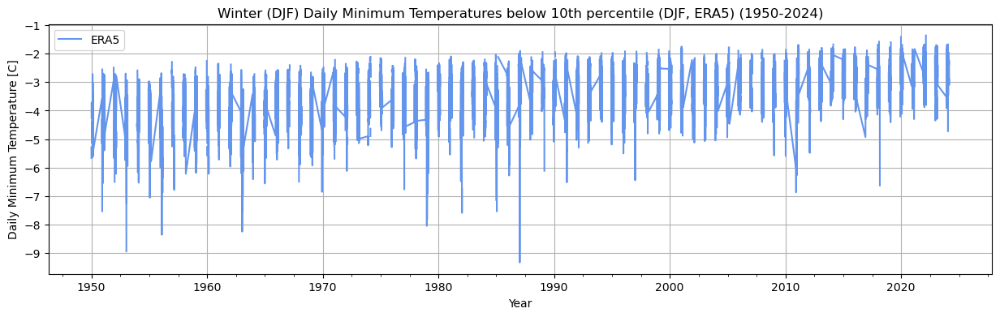

In [172]:
fig, ax = plt.subplots(figsize=(15, 4))
masked_tasmin_djf_TS.plot(ax=ax, label='ERA5',color='cornflowerblue')

ax.grid()
ax.xaxis.set_minor_locator(AutoMinorLocator())
ax.legend(loc='best')
ax.set(xlabel='Year', ylabel='Daily Minimum Temperature [C]')
plt.title('Winter (DJF) Daily Minimum Temperatures below 10th percentile (DJF, ERA5) (1950-2024)')

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/tasbelow10_temps_djf_plot.png', dpi=300, bbox_inches='tight')

# Show the plot (optional)
plt.show()

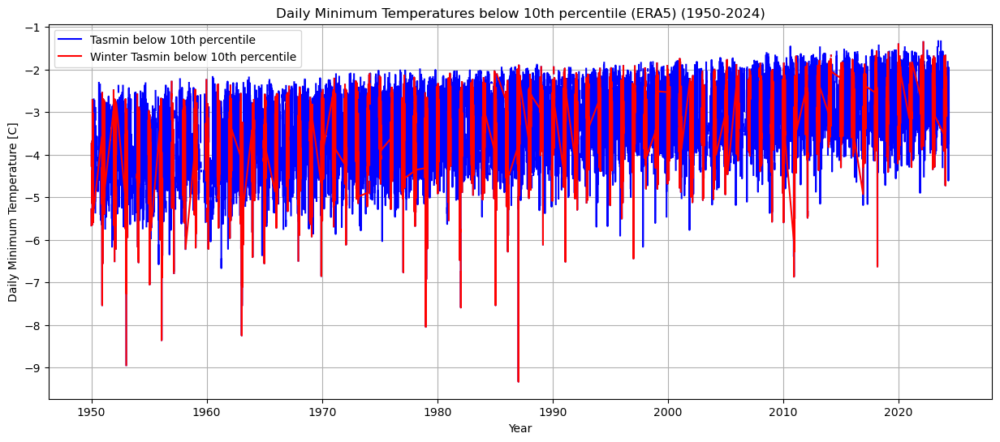

In [262]:
# Plotting the data
fig, ax = plt.subplots(figsize=(15, 6))

# Plot the cold event temperatures (mean across 'quantile' dimension if applicable)
masked_tasmin_TS.mean(dim='quantile').plot(ax=ax, label='Tasmin below 10th percentile', color='blue')

# Plot the winter cold event temperatures (mean across 'quantile' dimension if applicable)
masked_tasmin_djf_TS.mean(dim='quantile').plot(ax=ax, label='Winter Tasmin below 10th percentile', color='red')

# Customize the plot
ax.grid(True)
ax.set_xlabel('Year')
ax.set_ylabel('Daily Minimum Temperature [C]')
ax.set_title('Daily Minimum Temperatures below 10th percentile (ERA5) (1950-2024)')

# Add a legend
ax.legend()

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/ERA5_tasbelow10_comparison.png', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

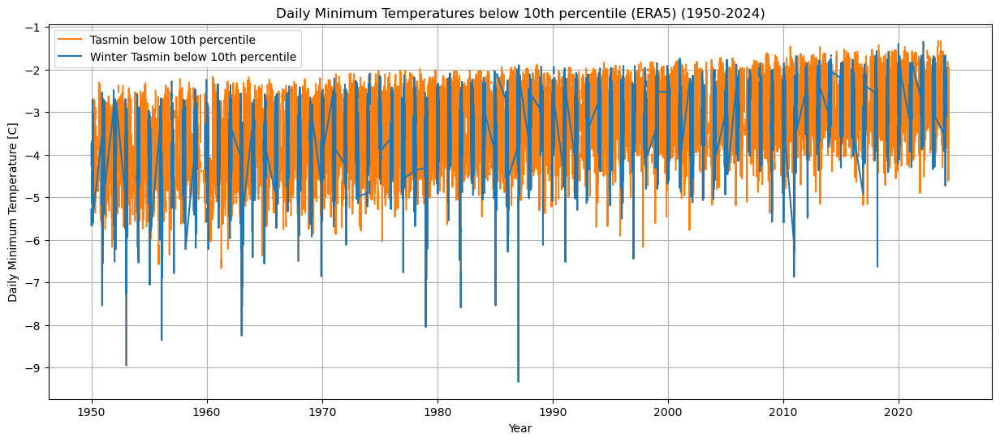

In [1156]:
# Plotting the data
fig, ax = plt.subplots(figsize=(15, 6))

# Plot the cold event temperatures (mean across 'quantile' dimension if applicable)
masked_tasmin_TS.mean(dim='quantile').plot(ax=ax, label='Tasmin below 10th percentile', color='C1')

# Plot the winter cold event temperatures (mean across 'quantile' dimension if applicable)
masked_tasmin_djf_TS.mean(dim='quantile').plot(ax=ax, label='Winter Tasmin below 10th percentile', color='C0')

# Customize the plot
ax.grid(True)
ax.set_xlabel('Year')
ax.set_ylabel('Daily Minimum Temperature [C]')
ax.set_title('Daily Minimum Temperatures below 10th percentile (ERA5) (1950-2024)')

# Add a legend
ax.legend()

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/ERA5_tasbelow10_comparison_C.png', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

# 11. Combine Coldwave days with temp data

In [122]:
# Create a boolean mask for cold events
cold_event_mask = xr.DataArray(np.isin(tasmin_uk['time'], cold_event_dates), dims=['time'], coords={'time': tasmin['time']})


In [124]:
# Filter the tasmin data using the cold event mask
cold_event_slice = tasmin.where(cold_event_mask, drop=True)

In [ ]:
# Function to filter and extract cold event temperatures
def extract_cold_event_temperatures(tasmin, cold_events):
    cold_event_slices = []
    for event in cold_events:
        # Ensure event is a list of cftime.Datetime360Day objects
        event_dates = [date for date in event if isinstance(date, cftime.Datetime360Day)]
        if event_dates:
            # Ensure dates in the event are present in the tasmin DataArray
            event_dates = [date for date in event_dates if date in tasmin['time'].values]
            if event_dates:
                # Select data for the event period
                event_slice = tasmin.sel(time=event_dates)
                # Aggregate the data (e.g., mean temperature over the period)
                event_mean = event_slice.mean(dim=['projection_y_coordinate', 'projection_x_coordinate'])
                cold_event_slices.append(event_mean)
    return cold_event_slices

In [126]:
def extract_cold_event_temperatures(tasmin, cold_events):
    cold_event_slices = []
    for event in cold_events:
        # Ensure event is a list of datetime objects
        event_dates = [date for date in event if date in tasmin['time'].values]
        if event_dates:
            # Select data for the event period
            event_slice = tasmin.sel(time=event_dates)
            # Aggregate the data (e.g., mean temperature over the period)
            event_mean = event_slice.mean(dim=['lat', 'lon'])
            cold_event_slices.append(event_mean)
    return cold_event_slices

In [128]:
# Extract the cold event temperature data
cold_event_temperatures = extract_cold_event_temperatures(masked_tasmin, cold_events)

In [129]:
# Convert the list to a single DataArray for easier plotting
cold_event_temperatures_da = xr.concat(cold_event_temperatures, dim='time')

In [132]:
# Extract the cold event temperature data
cold_event_temperatures_djf = extract_cold_event_temperatures(masked_tasmin_djf, cold_events)

In [134]:
# Convert the list to a single DataArray for easier plotting
cold_event_temperatures_da_djf = xr.concat(cold_event_temperatures_djf, dim='time')

Text(0.5, 1.0, 'Daily Minimum Near Surface Air Temperature during coldwaves (DJF, ERA5) (1950-2024)')

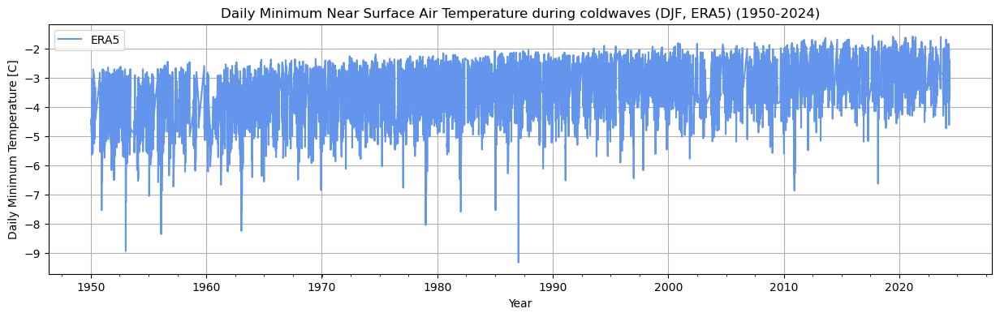

In [151]:
# Create a line plot of annual mean surface temperature anomalies over Northern Europe
fig, ax = matplotlib.pyplot.subplots(figsize=(15,4))
cold_event_temperatures_da.plot(ax=ax, label='ERA5',color='cornflowerblue')


ax.grid()
ax.xaxis.set_minor_locator(AutoMinorLocator())   
ax.legend(loc='best') 
ax.set(xlabel='Year',ylabel='Daily Minimum Temperature [C]')
matplotlib.pyplot.title('Daily Minimum Near Surface Air Temperature during coldwaves (DJF, ERA5) (1950-2024)')


Text(0.5, 1.0, 'Daily Minimum Near Surface Air Temperature during coldwaves (DJF, ERA5) (1950-2024)')

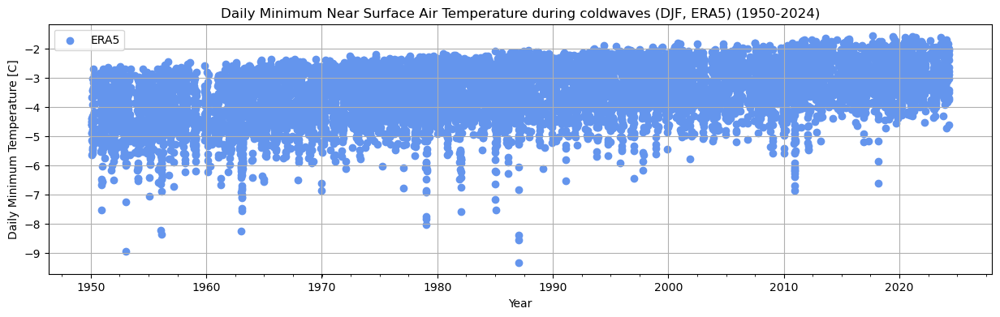

In [157]:
# Create a scatter plot of daily minimum temperature during coldwaves
fig, ax = matplotlib.pyplot.subplots(figsize=(15, 4))

# Assuming cold_event_temperatures_da is a DataArray with a datetime index or pandas Series/DataFrame
ax.scatter(cold_event_temperatures_da.time, cold_event_temperatures_da, label='ERA5', color='cornflowerblue')

ax.grid()
ax.xaxis.set_minor_locator(AutoMinorLocator())   
ax.legend(loc='best') 
ax.set(xlabel='Year', ylabel='Daily Minimum Temperature [C]')
matplotlib.pyplot.title('Daily Minimum Near Surface Air Temperature during coldwaves (DJF, ERA5) (1950-2024)')


In [158]:
cold_event_temperatures_year = cold_event_temperatures_da.groupby("time.year").mean("time")

In [159]:
cold_event_temperatures_year_djf = cold_event_temperatures_da_djf.groupby("time.year").mean("time")

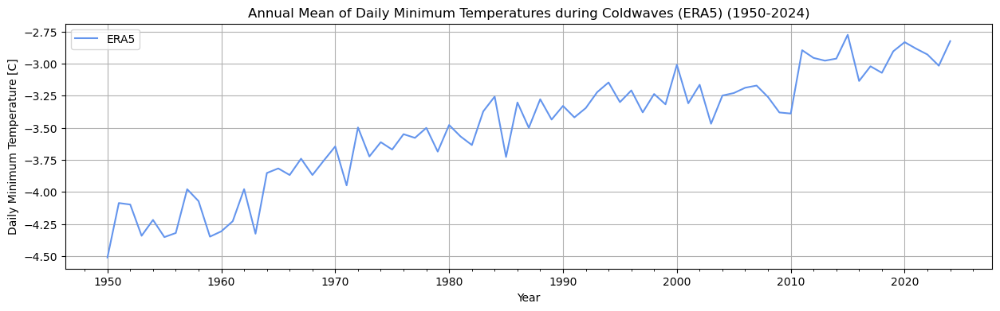

In [163]:
fig, ax = plt.subplots(figsize=(15, 4))
cold_event_temperatures_year.plot(ax=ax, label='ERA5', color='cornflowerblue')

ax.grid()
ax.xaxis.set_minor_locator(AutoMinorLocator())
ax.legend(loc='best')
ax.set(xlabel='Year', ylabel='Daily Minimum Temperature [C]')
plt.title('Annual Mean of Daily Minimum Temperatures during Coldwaves (ERA5) (1950-2024)')

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/annual_mean_tasmin_plot.png', dpi=300, bbox_inches='tight')

# Show the plot (optional)
plt.show()

In [214]:
print(cold_event_temperatures_year.coords)


Coordinates:
  * quantile  (quantile) float64 8B 0.1
  * year      (year) int64 136B 1950 1955 1957 1958 1975 ... 2003 2005 2018 2024


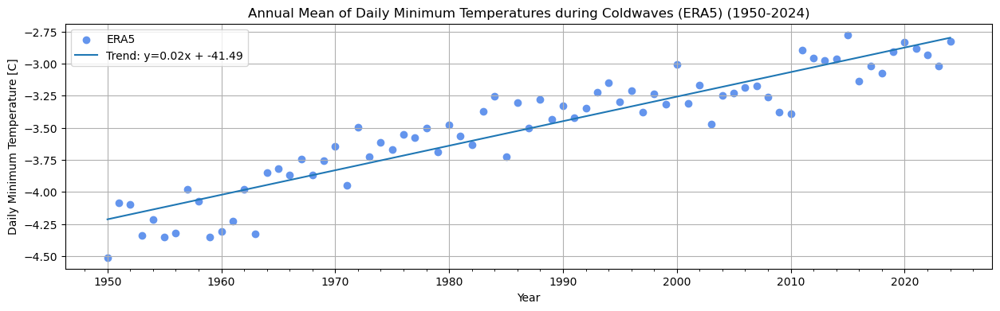

In [165]:
from matplotlib.ticker import AutoMinorLocator

# Convert to 1D arrays and flatten if needed
x = np.asarray(cold_event_temperatures_year['year']).astype(float).ravel()  # Ensure x is a 1D float array
y = np.asarray(cold_event_temperatures_year).astype(float).ravel()          # Ensure y is a 1D float array

# Perform a linear regression
slope, intercept = np.polyfit(x, y, 1)

# Calculate the regression line values
y_trend = slope * x + intercept

# Plot the scatter plot
fig, ax = plt.subplots(figsize=(15, 4))
ax.scatter(x, y, label='ERA5', color='cornflowerblue')

# Plot the regression line
ax.plot(x, y_trend, color='C0', label=f'Trend: y={slope:.2f}x + {intercept:.2f}')

ax.grid()
ax.xaxis.set_minor_locator(AutoMinorLocator())
ax.legend(loc='best')
ax.set(xlabel='Year', ylabel='Daily Minimum Temperature [C]')
plt.title('Annual Mean of Daily Minimum Temperatures during Coldwaves (ERA5) (1950-2024)')

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/annual_mean_tasmin_plot_scatter_with_trend.png', dpi=300, bbox_inches='tight')

# Show the plot (optional)
plt.show()

In [226]:
print(x.shape, y.shape)
print(x.dtype, y.dtype)


(17,) (17, 1)
float64 float64


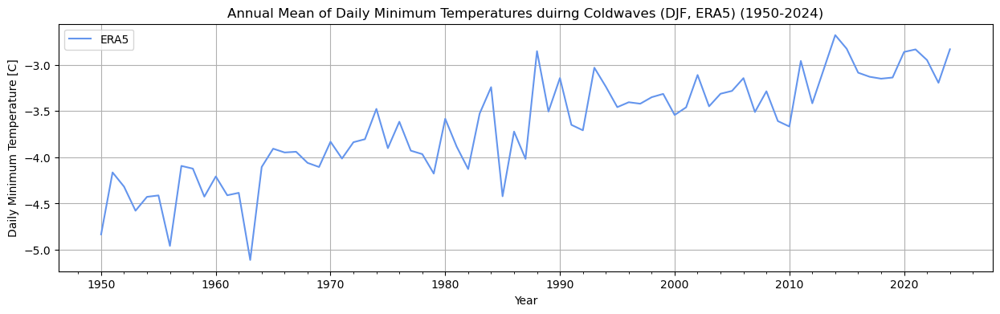

In [167]:
fig, ax = plt.subplots(figsize=(15, 4))
cold_event_temperatures_year_djf.plot(ax=ax, label='ERA5', color='cornflowerblue')

ax.grid()
ax.xaxis.set_minor_locator(AutoMinorLocator())
ax.legend(loc='best')
ax.set(xlabel='Year', ylabel='Daily Minimum Temperature [C]')
plt.title('Annual Mean of Daily Minimum Temperatures duirng Coldwaves (DJF, ERA5) (1950-2024)')

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/annual_mean_tasmin_djf_plot.png', dpi=300, bbox_inches='tight')

# Show the plot (optional)
plt.show()

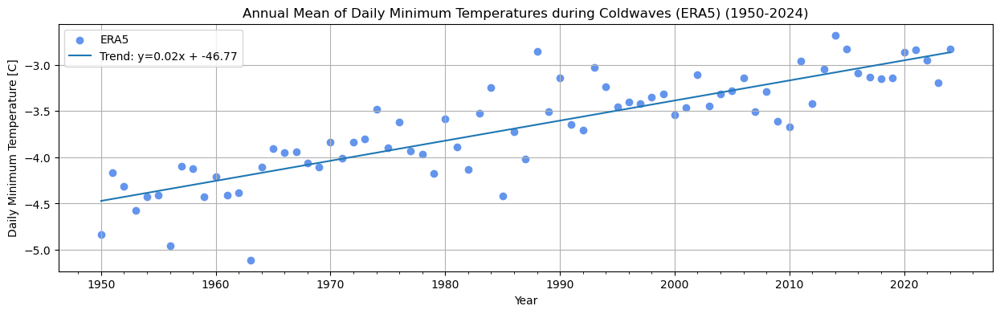

In [168]:
from matplotlib.ticker import AutoMinorLocator

# Convert to 1D arrays and flatten if needed
x = np.asarray(cold_event_temperatures_year_djf['year']).astype(float).ravel()  # Ensure x is a 1D float array
y = np.asarray(cold_event_temperatures_year_djf).astype(float).ravel()          # Ensure y is a 1D float array

# Perform a linear regression
slope, intercept = np.polyfit(x, y, 1)

# Calculate the regression line values
y_trend = slope * x + intercept

# Plot the scatter plot
fig, ax = plt.subplots(figsize=(15, 4))
ax.scatter(x, y, label='ERA5', color='cornflowerblue')

# Plot the regression line
ax.plot(x, y_trend, color='C0', label=f'Trend: y={slope:.2f}x + {intercept:.2f}')

ax.grid()
ax.xaxis.set_minor_locator(AutoMinorLocator())
ax.legend(loc='best')
ax.set(xlabel='Year', ylabel='Daily Minimum Temperature [C]')
plt.title('Annual Mean of Daily Minimum Temperatures during Coldwaves (ERA5) (1950-2024)')

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/annual_mean_tasmin_djf_plot_scatter_with_trend.png', dpi=300, bbox_inches='tight')

# Show the plot (optional)
plt.show()

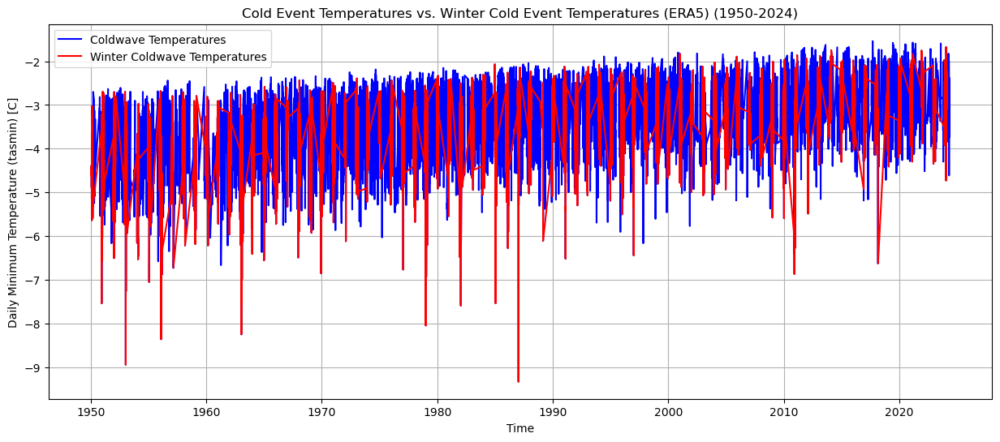

In [171]:
# Example: Align both datasets to the same time range, here we'll assume they have overlapping time periods
common_time = cold_event_temperatures_da.time
cold_event_temperatures_da_djf_aligned = cold_event_temperatures_da_djf.interp(time=common_time, method='linear')

# Plotting the data
fig, ax = plt.subplots(figsize=(15, 6))

# Plot the cold event temperatures (mean across 'quantile' dimension if applicable)
cold_event_temperatures_da.mean(dim='quantile').plot(ax=ax, label='Coldwave Temperatures', color='blue')

# Plot the winter cold event temperatures (mean across 'quantile' dimension if applicable)
cold_event_temperatures_da_djf.mean(dim='quantile').plot(ax=ax, label='Winter Coldwave Temperatures', color='red')

# Customize the plot
ax.grid(True)
ax.set_xlabel('Time')
ax.set_ylabel('Daily Minimum Temperature (tasmin) [C]')
ax.set_title('Cold Event Temperatures vs. Winter Cold Event Temperatures (ERA5) (1950-2024)')

# Add a legend
ax.legend()

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/ERA5_temperatures_comparison.png', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

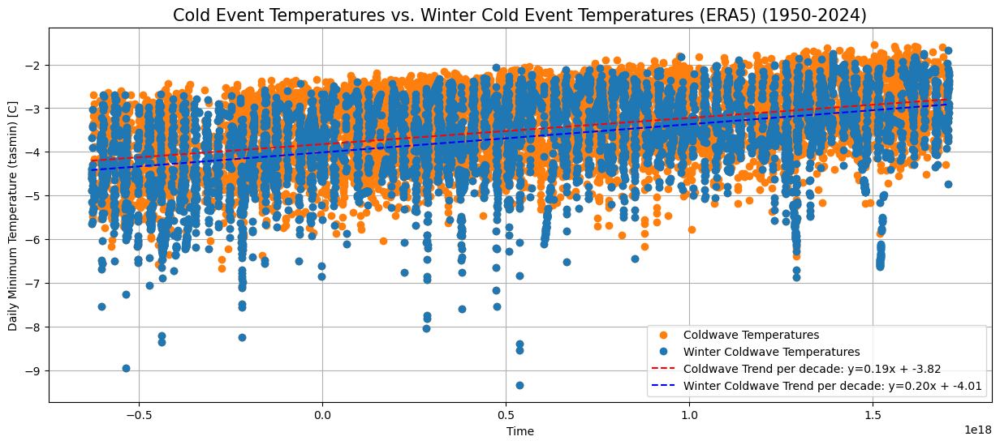

In [175]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import AutoMinorLocator

# Example: Align both datasets to the same time range
common_time = cold_event_temperatures_da.time
cold_event_temperatures_da_djf_aligned = cold_event_temperatures_da_djf.interp(time=common_time, method='linear')

# Convert DataArrays to numpy arrays and flatten if needed
x = np.asarray(common_time).astype(float).ravel()  # Ensure x is a 1D float array

# Extract values and flatten, ensuring no NaNs or infs are present
y_coldwave = np.asarray(cold_event_temperatures_da.mean(dim='quantile')).astype(float).ravel()
y_winter_coldwave = np.asarray(cold_event_temperatures_da_djf_aligned.mean(dim='quantile')).astype(float).ravel()

# Check for and handle NaN or Inf values
valid_indices = ~np.isnan(y_coldwave) & ~np.isnan(y_winter_coldwave) & ~np.isinf(y_coldwave) & ~np.isinf(y_winter_coldwave)
x = x[valid_indices]
y_coldwave = y_coldwave[valid_indices]
y_winter_coldwave = y_winter_coldwave[valid_indices]

# Ensure lengths are consistent
assert len(x) == len(y_coldwave) == len(y_winter_coldwave), "Mismatch in lengths of x and y arrays"

# Regularize or scale data if necessary
# For example, normalizing
x_mean, x_std = np.mean(x), np.std(x)
y_coldwave_mean, y_coldwave_std = np.mean(y_coldwave), np.std(y_coldwave)
y_winter_coldwave_mean, y_winter_coldwave_std = np.mean(y_winter_coldwave), np.std(y_winter_coldwave)

x_scaled = (x - x_mean) / x_std
y_coldwave_scaled = (y_coldwave - y_coldwave_mean) / y_coldwave_std
y_winter_coldwave_scaled = (y_winter_coldwave - y_winter_coldwave_mean) / y_winter_coldwave_std

# Perform linear regression
try:
    slope_coldwave, intercept_coldwave = np.polyfit(x_scaled, y_coldwave_scaled, 1)
    slope_winter, intercept_winter = np.polyfit(x_scaled, y_winter_coldwave_scaled, 1)
    
    # Unscale the results
    slope_coldwave *= y_coldwave_std / x_std
    intercept_coldwave = intercept_coldwave * y_coldwave_std + y_coldwave_mean - slope_coldwave * x_mean
    
    slope_winter *= y_winter_coldwave_std / x_std
    intercept_winter = intercept_winter * y_winter_coldwave_std + y_winter_coldwave_mean - slope_winter * x_mean

    # Calculate regression line values
    y_trend_coldwave = slope_coldwave * x + intercept_coldwave
    y_trend_winter = slope_winter * x + intercept_winter

except np.linalg.LinAlgError as e:
    print(f"Linear algebra error: {e}")
    y_trend_coldwave = np.full_like(x, np.nan)
    y_trend_winter = np.full_like(x, np.nan)

slope_coldwave_decade = slope_coldwave*365*1e+9*60*60*24*10
slope_winter_coldwave_decade = slope_winter*1e+9*365*60*60*24*10

# Plotting the data
fig, ax = plt.subplots(figsize=(15, 6))

# Plot the cold event temperatures
ax.plot(x, y_coldwave, label='Coldwave Temperatures', color='C1', linestyle='', marker='o')

# Plot the winter cold event temperatures
ax.plot(x, y_winter_coldwave, label='Winter Coldwave Temperatures', color='C0', linestyle='', marker='o')

# Plot the regression lines
if not np.all(np.isnan(y_trend_coldwave)):
    ax.plot(x, y_trend_coldwave, color='red', linestyle='--', label=f'Coldwave Trend per decade: y={slope_coldwave_decade:.2f}x + {intercept_coldwave:.2f}')
if not np.all(np.isnan(y_trend_winter)):
    ax.plot(x, y_trend_winter, color='blue', linestyle='--', label=f'Winter Coldwave Trend per decade: y={slope_winter_coldwave_decade:.2f}x + {intercept_winter:.2f}')

# Customize the plot
ax.grid(True)
ax.set_xlabel('Time')
ax.set_ylabel('Daily Minimum Temperature (tasmin) [C]')
ax.set_title('Cold Event Temperatures vs. Winter Cold Event Temperatures (ERA5) (1950-2024)', fontsize=15)

# Add a legend
ax.legend()

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/ERA5_temperatures_comparison_with_trends.png', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()


In [106]:
slope_coldwave_decade

0.23262714422848968

In [274]:
from matplotlib.ticker import AutoMinorLocator
import cftime

start = cftime.num2date(0*365,'days since 1950-01-01 00:00:00', calendar='noleap')
end = cftime.num2date(0*365,'days since 2025-01-01 00:00:00', calendar='noleap')
start_np = np.datetime64(start)
end_np = np.datetime64(end)

In [250]:
x.astype("datetime64[ns]")[0]

numpy.datetime64('1958-01-30T12:00:00.000000000')

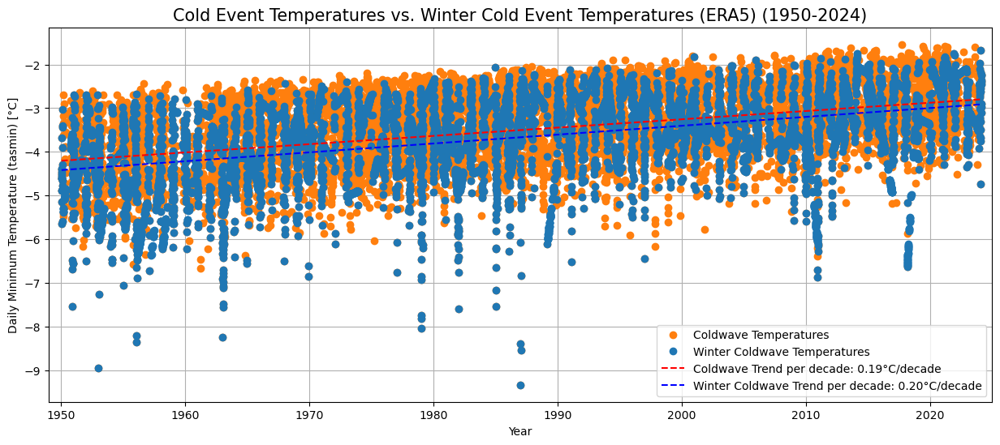

In [181]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import AutoMinorLocator
import cftime

# Example: Align both datasets to the same time range
common_time = cold_event_temperatures_da.time
cold_event_temperatures_da_djf_aligned = cold_event_temperatures_da_djf.interp(time=common_time, method='linear')

# Convert DataArrays to numpy arrays and flatten if needed
x = np.asarray(common_time).astype(float).ravel()  # Ensure x is a 1D float array

# Extract values and flatten, ensuring no NaNs or infs are present
y_coldwave = np.asarray(cold_event_temperatures_da.mean(dim='quantile')).astype(float).ravel()
y_winter_coldwave = np.asarray(cold_event_temperatures_da_djf_aligned.mean(dim='quantile')).astype(float).ravel()

# Check for and handle NaN or Inf values
valid_indices = ~np.isnan(y_coldwave) & ~np.isnan(y_winter_coldwave) & ~np.isinf(y_coldwave) & ~np.isinf(y_winter_coldwave)
x = x[valid_indices]
y_coldwave = y_coldwave[valid_indices]
y_winter_coldwave = y_winter_coldwave[valid_indices]

# Ensure lengths are consistent
assert len(x) == len(y_coldwave) == len(y_winter_coldwave), "Mismatch in lengths of x and y arrays"

# Regularize or scale data if necessary
x_mean, x_std = np.mean(x), np.std(x)
y_coldwave_mean, y_coldwave_std = np.mean(y_coldwave), np.std(y_coldwave)
y_winter_coldwave_mean, y_winter_coldwave_std = np.mean(y_winter_coldwave), np.std(y_winter_coldwave)

x_scaled = (x - x_mean) / x_std
y_coldwave_scaled = (y_coldwave - y_coldwave_mean) / y_coldwave_std
y_winter_coldwave_scaled = (y_winter_coldwave - y_winter_coldwave_mean) / y_winter_coldwave_std

# Perform linear regression
try:
    slope_coldwave, intercept_coldwave = np.polyfit(x_scaled, y_coldwave_scaled, 1)
    slope_winter, intercept_winter = np.polyfit(x_scaled, y_winter_coldwave_scaled, 1)
    
    # Unscale the results
    slope_coldwave *= y_coldwave_std / x_std
    intercept_coldwave = intercept_coldwave * y_coldwave_std + y_coldwave_mean - slope_coldwave * x_mean
    
    slope_winter *= y_winter_coldwave_std / x_std
    intercept_winter = intercept_winter * y_winter_coldwave_std + y_winter_coldwave_mean - slope_winter * x_mean
    
    # Calculate regression line values
    y_trend_coldwave = slope_coldwave * x + intercept_coldwave
    y_trend_winter = slope_winter * x + intercept_winter

except np.linalg.LinAlgError as e:
    print(f"Linear algebra error: {e}")
    y_trend_coldwave = np.full_like(x, np.nan)
    y_trend_winter = np.full_like(x, np.nan)

slope_coldwave_decade = slope_coldwave*365*1e+9*60*60*24*10
slope_winter_coldwave_decade = slope_winter*365*1e+9*60*60*24*10

# Plotting the data
fig, ax = plt.subplots(figsize=(15, 6))

# Plot the cold event temperatures
ax.plot(x.astype("datetime64[ns]"), y_coldwave, label='Coldwave Temperatures', color='C1', linestyle='', marker='o')

# Plot the winter cold event temperatures
ax.plot(x.astype("datetime64[ns]"), y_winter_coldwave, label='Winter Coldwave Temperatures', color='C0', linestyle='', marker='o')

# Plot the regression lines
if not np.all(np.isnan(y_trend_coldwave)):
    ax.plot(x.astype("datetime64[ns]"), y_trend_coldwave, color='red', linestyle='--', label=f'Coldwave Trend per decade: {slope_coldwave_decade:.2f}°C/decade')
if not np.all(np.isnan(y_trend_winter)):
    ax.plot(x.astype("datetime64[ns]"), y_trend_winter, color='blue', linestyle='--', label=f'Winter Coldwave Trend per decade: {slope_winter_coldwave_decade:.2f}°C/decade')

# Customize the plot
ax.grid(True)
ax.set_xlabel('Year')
ax.set_ylabel('Daily Minimum Temperature (tasmin) [°C]')
ax.set_title('Cold Event Temperatures vs. Winter Cold Event Temperatures (ERA5) (1950-2024)', fontsize=15)

# Set x-axis limits to the range of years
start = cftime.num2date(0*365,'days since 1949-01-01 00:00:00', calendar='noleap')
end = cftime.num2date(0*365,'days since 2025-01-01 00:00:00', calendar='noleap')
start_np = np.datetime64(start)
end_np = np.datetime64(end)

ax.set_xlim([start_np, end_np])
#ax.xaxis.set_major_locator(plt.MaxNLocator(integer=True))
#ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: int(x)))

# Add a legend
ax.legend()

# Save the figure
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/ERA5_temperatures_comparison_with_trends.png', dpi=300, bbox_inches='tight')


# Show the plot
plt.show()


# 12. Coldwave Duration (Lengths)

In [136]:
# Extract the cold_events data
cold_events = ds_combined['cold_events'].values  # This is your binary array

In [138]:
# Initialize an empty list to store coldwave periods
coldwave_periods = []
start_idx = None

# Iterate over the cold_events array to find coldwave periods
for i in range(len(cold_events)):
    if cold_events[i] == 1:
        if start_idx is None:
            start_idx = i
    elif start_idx is not None:
        coldwave_periods.append((start_idx, i - 1))
        start_idx = None

# If the last period extends to the end of the array
if start_idx is not None:
    coldwave_periods.append((start_idx, len(cold_events) - 1))

# Calculate the lengths of each coldwave
coldwave_lengths = [(end - start + 1) for start, end in coldwave_periods]

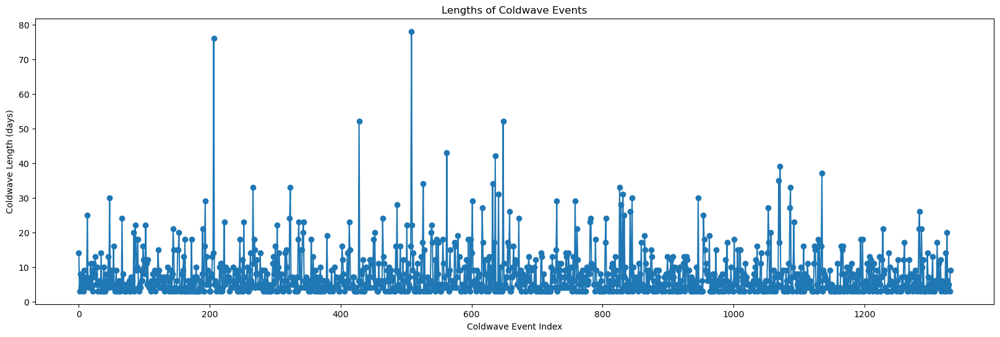

In [140]:
# Plot the lengths of each coldwave
plt.figure(figsize=(20, 6))
plt.plot(coldwave_lengths, marker='o')
plt.xlabel('Coldwave Event Index')
plt.ylabel('Coldwave Length (days)')
plt.title('Lengths of Coldwave Events')
plt.show()


In [180]:
# Extract the time coordinate
time = ds_combined['time'].values  # This gives us the time values corresponding to the indices

In [182]:
# Initialize lists to store start and end dates of each coldwave period
coldwave_start_dates = []
coldwave_end_dates = []

# Iterate over the coldwave periods to get the corresponding start and end dates
for start_idx, end_idx in coldwave_periods:
    coldwave_start_dates.append(time[start_idx])
    coldwave_end_dates.append(time[end_idx])


In [184]:
def pad_to_length(da, target_length, pad_value=np.nan):
    current_length = da.sizes['time']
    if current_length >= target_length:
        return da.isel(time=slice(0, target_length))
    
    padding_length = target_length - current_length
    padding_array = np.full((padding_length, da.sizes['quantile']), pad_value, dtype=da.dtype)
    
    padding_da = xr.DataArray(
        padding_array, 
        dims=['time', 'quantile'], 
        coords={
            'time': np.arange(current_length, target_length), 
            'quantile': da.coords['quantile']
        }
    )
    
    padded_da = xr.concat([da, padding_da], dim='time')
    return padded_da

In [186]:
len(cold_event_temperatures_da)

10093

In [188]:
cold_event_temperatures_da_padded = pad_to_length(cold_event_temperatures_da,1332)

In [190]:
# Convert the list to a 1D numpy array
cold_event_temperatures_da_flatten = np.array(cold_event_temperatures_da_padded).flatten()

In [191]:
# Debugging: Print lengths of lists
print("Length of start dates:", len(coldwave_start_dates))
print("Length of end dates:", len(coldwave_end_dates))
print("Length of lengths:", len(coldwave_lengths))
print("Length of tasmin:", len(cold_event_temperatures_da_flatten))

Length of start dates: 1332
Length of end dates: 1332
Length of lengths: 1332
Length of tasmin: 1332


In [192]:
# Create a DataFrame to hold the coldwave data
coldwave_data_intial = pd.DataFrame({
    'start_date': coldwave_start_dates,
    'end_date': coldwave_end_dates,
    'length': coldwave_lengths,
    'tasmin': cold_event_temperatures_da_flatten
})

# Convert the DataFrame to an xarray.Dataset
coldwave_dataset_intial = xr.Dataset.from_dataframe(coldwave_data_intial)

# Optionally, set the start_date as the coordinate
coldwave_dataset_intial = coldwave_dataset_intial.set_coords('start_date')


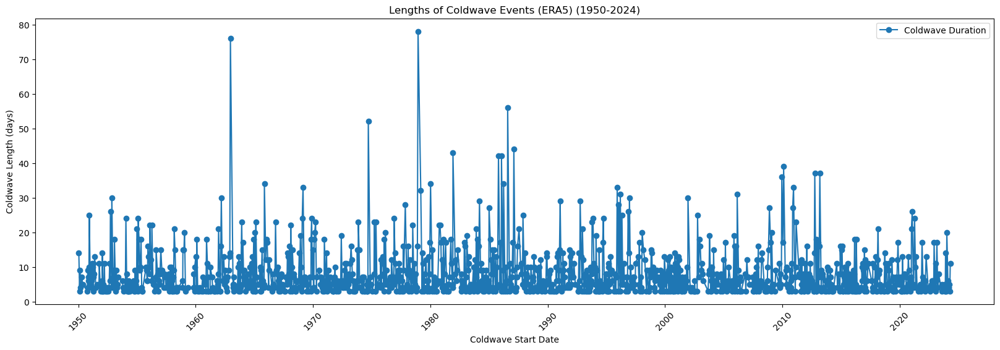

<xarray.Dataset> Size: 49kB
Dimensions:     (index: 1373)
Coordinates:
    start_date  (index) datetime64[ns] 11kB 1950-01-19T12:00:00 ... 2024-04-1...
  * index       (index) int64 11kB 0 1 2 3 4 5 ... 1367 1368 1369 1370 1371 1372
Data variables:
    end_date    (index) datetime64[ns] 11kB 1950-02-01T12:00:00 ... 2024-04-2...
    length      (index) int64 11kB 14 3 9 4 5 7 5 3 9 4 ... 14 3 20 6 4 4 5 3 11
    tasmin      (index) float32 5kB -4.597 -4.607 -4.4 ... -5.236 -3.072 -5.174


In [220]:
# Plot the lengths of each coldwave
plt.figure(figsize=(20, 6))
plt.plot(coldwave_dataset_intial['start_date'], coldwave_dataset_intial['length'], linestyle='-', marker='o', label='Coldwave Duration')
plt.xlabel('Coldwave Start Date')
plt.ylabel('Coldwave Length (days)')
plt.title('Lengths of Coldwave Events (ERA5) (1950-2024)')
plt.xticks(rotation=45)
plt.legend()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_Duration_points_plot.png', dpi=300)

plt.show()

print(coldwave_dataset_intial)

# 13. Coldwave severity 

In [196]:
temperature_data = cold_event_temperatures_da.values  # Extract temperature data

In [198]:
from scipy.integrate import quad

# Define temperature function
def temperature_function(t, base_temp):
    return base_temp  # Temperature is constant

# Calculate severities using numerical integration
def calculate_severity(base_temp, duration):
    result, _ = quad(temperature_function, 0, duration, args=(base_temp,))
    return result

# Calculate unnormalized severities
severities = np.array([calculate_severity(temp, length) for temp, length in zip(cold_event_temperatures_da, coldwave_lengths)])

# Debugging: Print unnormalized severities
print("Unnormalized Severities:")
for i, severity in enumerate(severities):
    print(f"Coldwave {i+1}: {severity:.3f}")

# Take absolute value for normalization
abs_severities = np.abs(severities)

# Find the maximum severity for normalization
max_severity = np.max(abs_severities)
print(f"Maximum Severity for Normalization: {max_severity:.3f}")

# Calculate normalized severities
normalized_severities = abs_severities / max_severity

# Debugging: Print normalized severities
print("Normalized Severities:")
for i, normalized_severity in enumerate(normalized_severities):
    print(f"Coldwave {i+1}: {normalized_severity:.3f}")


Unnormalized Severities:
Coldwave 1: -64.365
Coldwave 2: -13.820
Coldwave 3: -35.199
Coldwave 4: -18.394
Coldwave 5: -22.844
Coldwave 6: -31.401
Coldwave 7: -24.447
Coldwave 8: -13.137
Coldwave 9: -40.141
Coldwave 10: -18.121
Coldwave 11: -36.060
Coldwave 12: -24.435
Coldwave 13: -25.698
Coldwave 14: -140.938
Coldwave 15: -23.850
Coldwave 16: -23.347
Coldwave 17: -12.091
Coldwave 18: -20.407
Coldwave 19: -37.882
Coldwave 20: -15.637
Coldwave 21: -38.647
Coldwave 22: -16.768
Coldwave 23: -59.204
Coldwave 24: -36.390
Coldwave 25: -43.444
Coldwave 26: -41.231
Coldwave 27: -16.692
Coldwave 28: -18.127
Coldwave 29: -27.020
Coldwave 30: -8.678
Coldwave 31: -17.980
Coldwave 32: -23.564
Coldwave 33: -29.476
Coldwave 34: -15.746
Coldwave 35: -43.759
Coldwave 36: -12.562
Coldwave 37: -23.628
Coldwave 38: -12.540
Coldwave 39: -41.584
Coldwave 40: -15.507
Coldwave 41: -15.263
Coldwave 42: -33.819
Coldwave 43: -23.344
Coldwave 44: -16.619
Coldwave 45: -21.243
Coldwave 46: -58.191
Coldwave 47: -12.2

In [200]:
temperature_data = cold_event_temperatures_da.values  # Extract temperature data
coldwave_start_date = coldwave_dataset_intial['start_date']
coldwave_end_date = coldwave_dataset_intial['end_date']

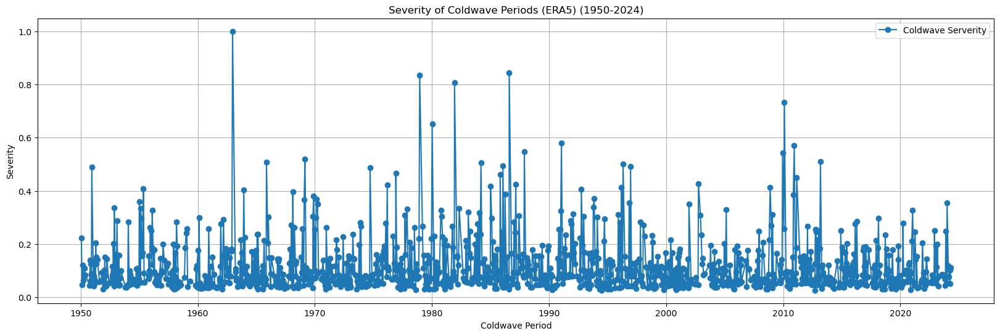

In [202]:
plt.figure(figsize=(20, 6))
plt.plot(coldwave_start_dates, normalized_severities, linestyle='-', marker='o', label='Coldwave Serverity')
plt.xlabel('Coldwave Period')
plt.ylabel('Severity')
plt.title('Severity of Coldwave Periods (ERA5) (1950-2024)')
plt.grid(True)
plt.legend()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_severity_points_plot.png', dpi=300)

plt.show()

# 14. Coldwave temperature extremes (largest magnitude of minimum temps)


In [204]:
# Extract the minimum temperatures
min_temperatures = cold_event_temperatures_da.values

# Find the largest magnitude of these minimum temperatures
# Note: The magnitude refers to the absolute value
largest_magnitude_of_min_temperatures = np.max(np.abs(min_temperatures))

# Print results
#print(f'Minimum temperatures for each coldwave: {min_temperatures}')
print(f'Largest magnitude of minimum temperatures: {largest_magnitude_of_min_temperatures}')

Largest magnitude of minimum temperatures: 9.331819534301758


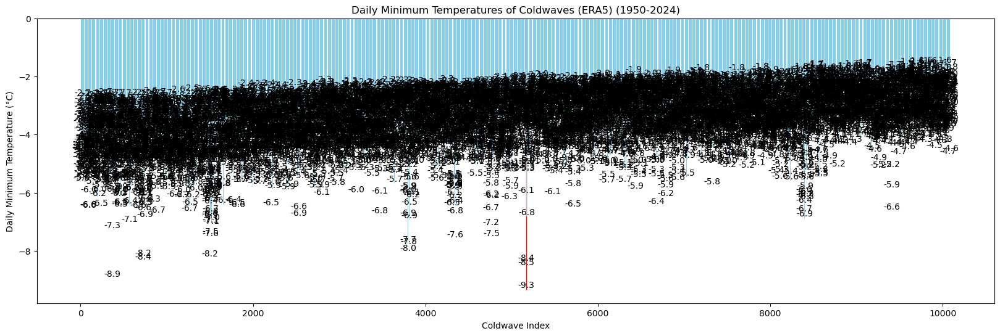

In [206]:
min_temperatures = cold_event_temperatures_da.values

# Identify the index of the coldwave with the lowest temperature
min_temp_index = min_temperatures.argmin()

# Flatten min_temperatures
min_temperatures = min_temperatures.flatten()

# Plotting
plt.figure(figsize=(20, 6))

# Bar chart for minimum temperatures
bars = plt.bar(range(len(min_temperatures)), min_temperatures, color='skyblue')

# Highlight the bar with the lowest temperature
bars[min_temp_index].set_color('red')

# Add labels and title
plt.xlabel('Coldwave Index')
plt.ylabel('Daily Minimum Temperature (°C)')
plt.title('Daily Minimum Temperatures of Coldwaves (ERA5) (1950-2024)')

# Add annotations
for i, value in enumerate(min_temperatures):
    plt.text(i, value, f'{value:.1f}', ha='center', va='bottom', color='black')

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_tasmin_bar_plot.png', dpi=300)

# Show plot
plt.show()

In [207]:
# Function to calculate mean daily minimum temperature for each coldwave
def calculate_mean_daily_min_temps(start_dates, lengths, temperatures):
    mean_temps = []
    current_index = 0
    
    for length in lengths:
        # Extract temperatures for the current coldwave
        coldwave_temps = temperatures[current_index:current_index + length]
        mean_temp = np.mean(coldwave_temps)
        mean_temps.append(mean_temp)
        current_index += length
    
    return mean_temps


In [208]:
# Calculate mean daily minimum temperature for each coldwave
mean_daily_min_temps = calculate_mean_daily_min_temps(coldwave_start_dates, coldwave_lengths, min_temperatures)


In [209]:
# Calculate the minimum temperature for each coldwave
min_temps = cold_event_temperatures_da.min(dim='time')

# Combine minimum temperatures with their durations
coldwave_durations = coldwave_dataset_intial['length']

# Create a DataArray with minimum temperatures and durations
coldwave_info = xr.Dataset({
    'min_temperature': min_temps,
    'duration': coldwave_durations
})

In [240]:
# Find the top N coldest coldwaves (e.g., top 5 coldwaves)
N = 2
coldest_coldwaves = coldwave_info.sortby('min_temperature').isel(index=slice(N))

print("Top N Coldest Coldwaves:")
print(coldest_coldwaves)

# Extract details of the coldest coldwaves
coldest_coldwave_indices = coldest_coldwaves['index'].values
coldest_coldwave_details = cold_event_temperatures_da.sel(time=coldwave_dataset_intial['start_date'][coldest_coldwave_indices])

print("Details of the Top N Coldest Coldwaves:")
print(coldest_coldwave_details)

Top N Coldest Coldwaves:
<xarray.Dataset> Size: 60B
Dimensions:          (quantile: 1, index: 2)
Coordinates:
  * quantile         (quantile) float64 8B 0.1
    start_date       (index) datetime64[ns] 16B 1950-01-19T12:00:00 1950-02-1...
  * index            (index) int64 16B 0 1
Data variables:
    min_temperature  (quantile) float32 4B -9.332
    duration         (index) int64 16B 14 3
Details of the Top N Coldest Coldwaves:
<xarray.DataArray 'tmin' (index: 2, quantile: 1)> Size: 8B
array([[-4.5974784],
       [-4.7700386]], dtype=float32)
Coordinates:
    time        (index) datetime64[ns] 16B 1950-01-19T12:00:00 1950-02-12T12:...
    dayofyear   (index) int64 16B 19 43
  * quantile    (quantile) float64 8B 0.1
    start_date  (index) datetime64[ns] 16B 1950-01-19T12:00:00 1950-02-12T12:...
  * index       (index) int64 16B 0 1


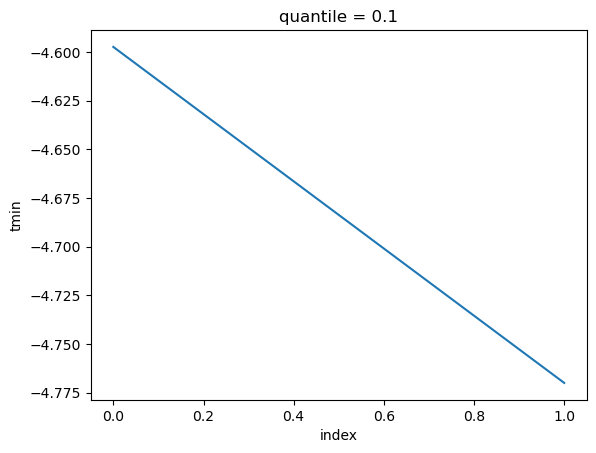

In [242]:
coldest_coldwave_details.plot()

In [210]:
# Initialize lists to hold minimum temperatures and corresponding coldwave indices
min_temperatures = []
coldwave_ids = []

# Iterate over each coldwave in the DataFrame
for idx, row in coldwave_data_intial.iterrows():
    start_date = row['start_date']
    end_date = row['end_date']
    
    # Define the time range for the current coldwave
    time_range = slice(start_date, end_date)
    
    # Extract temperature data within the time range
    coldwave_temp = cold_event_temperatures_da.sel(time=time_range)
    
    # Check if the slice is empty to avoid errors
    if not coldwave_temp.size:
        min_temp = float('nan')  # Or another placeholder for no data
    else:
        # Find the minimum temperature for this coldwave
        min_temp = coldwave_temp.min().values
    
    # Append the result
    min_temperatures.append(min_temp)
    coldwave_ids.append(idx)

In [216]:
# Create a DataFrame to hold the coldwave data
coldwave_data_initial = pd.DataFrame({
    'start_date': coldwave_start_dates,
    'end_date': coldwave_end_dates,
    'length': coldwave_lengths,
    'tasmin': cold_event_temperatures_da_flatten,
    'min_temperature': min_temperatures
})


In [218]:
# Print the updated DataFrame with minimum temperatures
print(coldwave_data_initial[['start_date', 'end_date', 'min_temperature']])

              start_date            end_date      min_temperature
0    1950-01-19 12:00:00 1950-02-01 12:00:00   -5.637523651123047
1    1950-02-12 12:00:00 1950-02-14 12:00:00   -4.770038604736328
2    1950-02-23 12:00:00 1950-03-02 12:00:00   -5.589410305023193
3    1950-03-12 12:00:00 1950-03-15 12:00:00  -3.6253015995025635
4    1950-04-13 12:00:00 1950-04-17 12:00:00    -5.24869966506958
...                  ...                 ...                  ...
1327 2024-02-05 12:00:00 2024-02-10 12:00:00  -2.9652864933013916
1328 2024-02-22 12:00:00 2024-02-25 12:00:00  -3.0983352661132812
1329 2024-03-25 12:00:00 2024-03-29 12:00:00  -3.3987600803375244
1330 2024-04-03 12:00:00 2024-04-05 12:00:00   -2.177443742752075
1331 2024-04-20 12:00:00 2024-04-28 12:00:00   -4.612339973449707

[1332 rows x 3 columns]


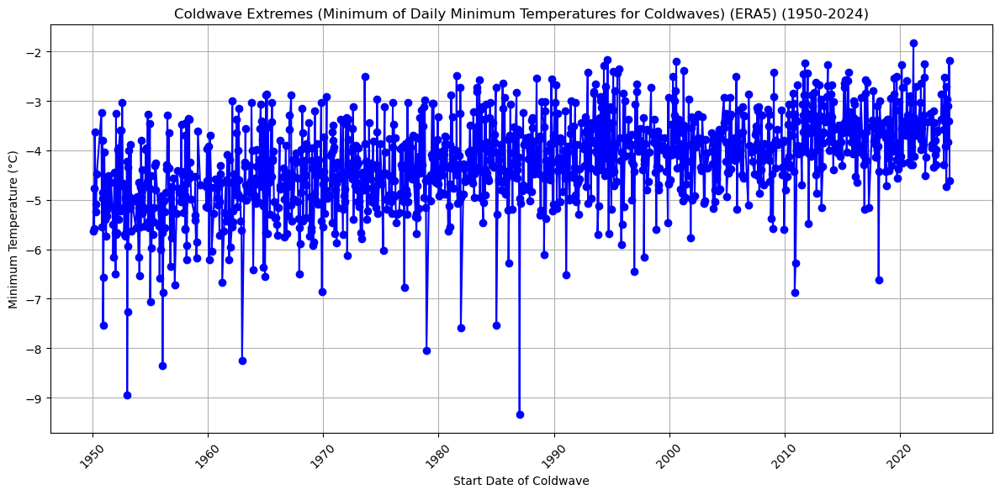

In [250]:
# Plot the results
plt.figure(figsize=(12, 6))

# Plot minimum temperatures
plt.plot(coldwave_data_initial['start_date'], coldwave_data_initial['min_temperature'], marker='o', linestyle='-', color='b')

# Format the plot
plt.title('Coldwave Extremes (Minimum of Daily Minimum Temperatures for Coldwaves) (ERA5) (1950-2024)')
plt.xlabel('Start Date of Coldwave')
plt.ylabel('Minimum Temperature (°C)')
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_extremes_plot.png', dpi=300)

plt.show()

# 15. Combining into one dataset

In [220]:
# Initialize a list to store temperature DataArrays for each coldwave event
cold_event_temps = []

# Iterate through coldwave_start_dates to extract corresponding temperature DataArrays
for start_date in coldwave_start_dates:
    # Find the index corresponding to start_date in cold_event_temperatures_da['time']
    idx = np.where(cold_event_temperatures_da['time'] == start_date)[0][0]
    
    # Extract temperature DataArray for the current coldwave event
    temp_data = cold_event_temperatures_da.isel(time=idx)
    
    # Append to the list
    cold_event_temps.append(temp_data)

# Concatenate temperature DataArrays along the 'time' dimension
combined_temperatures = xr.concat(cold_event_temps, dim='time')

In [221]:
# Debugging: Print lengths of lists
print("Length of start dates:", len(coldwave_start_dates))
print("Length of end dates:", len(coldwave_end_dates))
print("Length of lengths:", len(coldwave_lengths))
print("Length of severities:", len(normalized_severities))
print("Length of tasmin:", len(combined_temperatures))
print("Length of min temps:", len(min_temperatures))

Length of start dates: 1332
Length of end dates: 1332
Length of lengths: 1332
Length of severities: 1332
Length of tasmin: 1332
Length of min temps: 1332


In [224]:
# Convert the list to a 1D numpy array
combined_temperatures = np.array(cold_event_temps).flatten()

In [226]:
# Create a DataFrame to hold the coldwave data
coldwave_data = pd.DataFrame({
    'start_date': coldwave_start_dates,
    'end_date': coldwave_end_dates,
    'length': coldwave_lengths,
    'severity': normalized_severities,
    'tasmin': combined_temperatures,
    'mean_tasmin': mean_daily_min_temps,
    'min_temps': min_temperatures
})

In [228]:
# Add a column to flag the minimum temperature
coldwave_data['min_temp_flag'] = coldwave_data.index == min_temp_index

In [230]:
# Convert the DataFrame to an xarray.Dataset
coldwave_dataset = xr.Dataset.from_dataframe(coldwave_data)

# Optionally, set the start_date as the coordinate
coldwave_dataset = coldwave_dataset.set_coords('start_date')

In [232]:
# Save the xarray Dataset as a NetCDF file
coldwave_dataset.to_netcdf('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_dataset.nc')

print("Coldwave dataset saved as 'coldwave_dataset.nc'")

PermissionError: [Errno 13] Permission denied: 'C:\\Users\\harry\\OneDrive - University College London\\Documents\\Uni\\Masters\\Dissertation\\plots\\python plots\\ERA5\\coldwave_dataset.nc'

In [5]:
coldwave_dataset_file = ('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_dataset.nc')

In [7]:
coldwave_dataset = xr.open_mfdataset(paths=[coldwave_dataset_file], combine="by_coords")

In [8]:
print(coldwave_dataset)

<xarray.Dataset> Size: 78kB
Dimensions:        (index: 1373)
Coordinates:
    start_date     (index) datetime64[ns] 11kB dask.array<chunksize=(1373,), meta=np.ndarray>
  * index          (index) int64 11kB 0 1 2 3 4 5 ... 1368 1369 1370 1371 1372
Data variables:
    end_date       (index) datetime64[ns] 11kB dask.array<chunksize=(1373,), meta=np.ndarray>
    length         (index) int64 11kB dask.array<chunksize=(1373,), meta=np.ndarray>
    severity       (index) float64 11kB dask.array<chunksize=(1373,), meta=np.ndarray>
    tasmin         (index) float32 5kB dask.array<chunksize=(1373,), meta=np.ndarray>
    mean_tasmin    (index) float32 5kB dask.array<chunksize=(1373,), meta=np.ndarray>
    min_temps      (index) float64 11kB dask.array<chunksize=(1373,), meta=np.ndarray>
    min_temp_flag  (index) bool 1kB dask.array<chunksize=(1373,), meta=np.ndarray>


In [11]:
coldwave_start_dates = coldwave_dataset['start_date']
coldwave_end_dates = coldwave_dataset['end_date']

In [23]:
tasmin_values = coldwave_dataset['tasmin'].values

In [24]:
# Identify the index of the coldwave with the lowest temperature
min_temp_index = np.argmin(tasmin_values)

# Plotting
plt.figure(figsize=(30, 6))

# Bar chart for minimum temperatures
bars = plt.bar(coldwave_data.index, coldwave_data['min_temps'], color='skyblue')

# Highlight the bar with the lowest temperature
bars[min_temp_index].set_color('red')

# Add labels and title
plt.xlabel('Coldwave Index')
plt.ylabel('Daily Minimum Temperature (°C)')
plt.title('Average Daily Minimum Temperatures of Coldwaves (ERA5) (1950-2024)')

# Add annotations
for i, value in enumerate(coldwave_data['tasmin']):
    plt.text(i, value, f'{value:.1f}', ha='center', va='bottom', color='black')

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_average_tasmin_plot.png', dpi=300)

# Show plot
plt.show()

NameError: name 'coldwave_data' is not defined

<Figure size 3000x600 with 0 Axes>

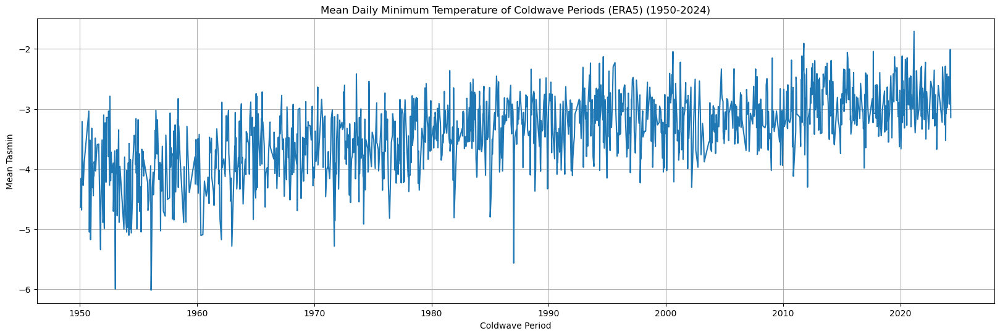

In [276]:
plt.figure(figsize=(20, 6))
plt.plot(coldwave_start_dates, coldwave_data['mean_tasmin'])
plt.xlabel('Coldwave Period')
plt.ylabel('Mean Tasmin')
plt.title('Mean Daily Minimum Temperature of Coldwave Periods (ERA5) (1950-2024)')
plt.grid(True)

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_mean_tasmin_plot.png', dpi=300)

plt.show()

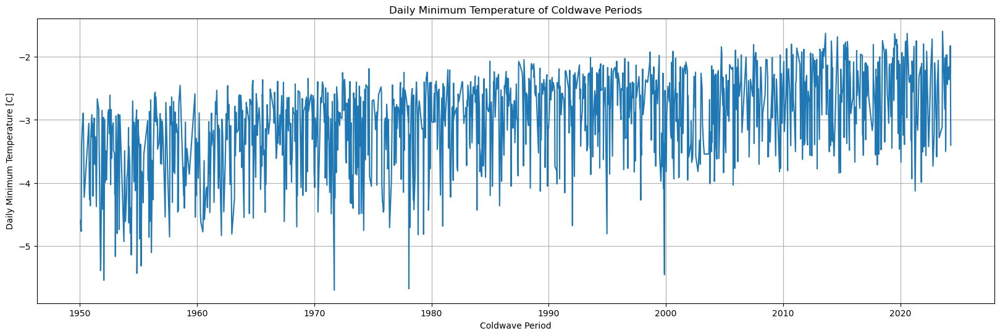

In [277]:
plt.figure(figsize=(20, 6))
plt.plot(coldwave_start_dates, coldwave_dataset['tasmin'])
plt.xlabel('Coldwave Period')
plt.ylabel('Daily Minimum Temperature [C]')
plt.title('Daily Minimum Temperature of Coldwave Periods')
plt.grid(True)
plt.show()

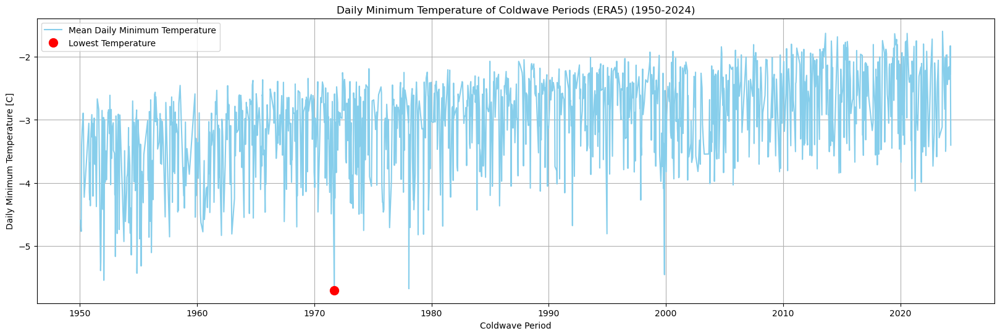

In [283]:
# Identify the index of the coldwave with the lowest temperature
min_temp_index = np.argmin(tasmin_values)

plt.figure(figsize=(20, 6))
plt.plot(coldwave_start_dates, coldwave_dataset['tasmin'], linestyle='-', color='skyblue', label='Mean Daily Minimum Temperature')
plt.plot(coldwave_start_dates[min_temp_index], tasmin_values[min_temp_index], 'ro', markersize=10, label='Lowest Temperature')
plt.xlabel('Coldwave Period')
plt.ylabel('Daily Minimum Temperature [C]')
plt.title('Daily Minimum Temperature of Coldwave Periods (ERA5) (1950-2024)')
plt.grid(True)
plt.legend()
#plt.tight_layout()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_tasmin_plot_clear.png', dpi=300)

plt.show()

In [291]:
import datetime

# Unix epoch start date
epoch_start_date = datetime.date(1970, 1, 1)

# Function to convert nanosecond timestamp to datetime.date
def convert_timestamp_to_date(timestamp):
    try:
        if timestamp >= 0:
            # For timestamps after 1970
            return datetime.datetime.utcfromtimestamp(timestamp / 1e9).date()
        else:
            # For timestamps before 1970, manually calculate the date
            days_offset = timestamp // (1e9 * 86400)  # Convert nanoseconds to days
            return epoch_start_date + datetime.timedelta(days=days_offset)
    except Exception as e:
        print(f"Error converting timestamp {timestamp}: {e}")
        return None  # or handle the error as appropriate

In [293]:
# Convert integer timestamps to datetime.date objects
coldwave_start_dates_converted = np.array([convert_timestamp_to_date(ts) for ts in coldwave_start_dates])

# Check if conversion was successful
print("Converted dates:", coldwave_start_dates_converted)

# Filter out None values (in case any timestamps failed to convert)
coldwave_start_dates_converted = np.array([date for date in coldwave_start_dates_converted if date is not None])

Error converting timestamp 1950-01-19T12:00:00.000000000: ufunc 'greater_equal' did not contain a loop with signature matching types (<class 'numpy.dtypes.DateTime64DType'>, <class 'numpy.dtypes.Int32DType'>) -> None
Error converting timestamp 1950-02-12T12:00:00.000000000: ufunc 'greater_equal' did not contain a loop with signature matching types (<class 'numpy.dtypes.DateTime64DType'>, <class 'numpy.dtypes.Int32DType'>) -> None
Error converting timestamp 1950-02-23T12:00:00.000000000: ufunc 'greater_equal' did not contain a loop with signature matching types (<class 'numpy.dtypes.DateTime64DType'>, <class 'numpy.dtypes.Int32DType'>) -> None
Error converting timestamp 1950-03-12T12:00:00.000000000: ufunc 'greater_equal' did not contain a loop with signature matching types (<class 'numpy.dtypes.DateTime64DType'>, <class 'numpy.dtypes.Int32DType'>) -> None
Error converting timestamp 1950-04-13T12:00:00.000000000: ufunc 'greater_equal' did not contain a loop with signature matching types

In [295]:
# Convert dates to ordinal numbers
coldwave_start_dates_ordinal = np.array([date.toordinal() for date in coldwave_start_dates_converted])

# Initialize and fit the model
model = LinearRegression()
model.fit(coldwave_start_dates_ordinal.reshape(-1, 1), tasmin_values)

# Predict using the model
trend_line = model.predict(coldwave_start_dates_ordinal.reshape(-1, 1))

# Plotting
plt.figure(figsize=(20, 6))
plt.plot(coldwave_start_dates_converted, tasmin_values, linestyle='-', color='skyblue', marker='o', label='Mean Daily Minimum Temperature')
plt.plot(coldwave_start_dates_converted[min_temp_index], tasmin_values[min_temp_index], 'ro', markersize=10, label='Lowest Temperature')
plt.plot(coldwave_start_dates_converted, trend_line, 'g--', label='Linear Trend')
plt.xlabel('Coldwave Period')
plt.ylabel('Daily Minimum Temperature [C]')
plt.title('Daily Minimum Temperature of Coldwave Periods (ERA5) (1950-2024)')
plt.grid(True)
plt.legend()
# plt.tight_layout()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_tasmin_plot_trend.png', dpi=300)

plt.show()

NameError: name 'LinearRegression' is not defined

In [17]:
# Initialize lists to store start and end dates of each coldwave period
coldwave_start_dates = []
coldwave_end_dates = []

# Iterate over the coldwave periods to get the corresponding start and end dates
for start_idx, end_idx in coldwave_periods:
    coldwave_start_dates.append(time[start_idx])
    coldwave_end_dates.append(time[end_idx])

NameError: name 'coldwave_periods' is not defined

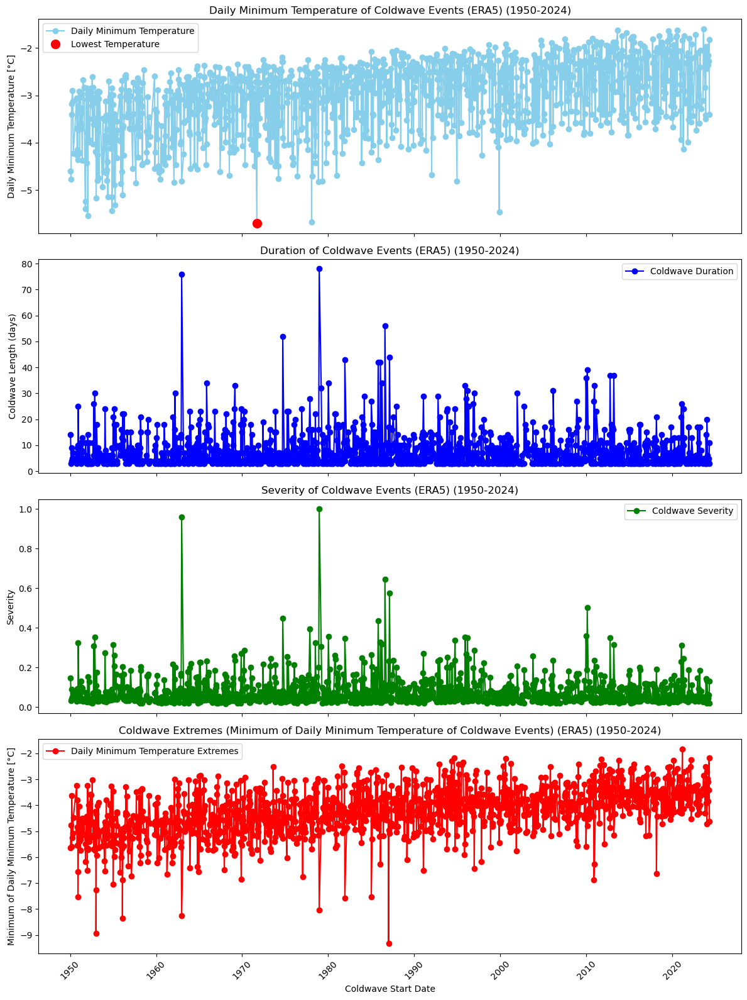

In [27]:
# Create figure and subplots
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(12, 16), sharex=True)

# Plot the tasmin of each coldwave on ax1
ax1.plot(coldwave_dataset['start_date'], coldwave_dataset['tasmin'], linestyle='-', color='skyblue', marker='o', label='Daily Minimum Temperature')
ax1.plot(coldwave_start_dates[min_temp_index], tasmin_values[min_temp_index], 'ro', markersize=10, label='Lowest Temperature')
ax1.set_ylabel('Daily Minimum Temperature [°C]')
ax1.set_title('Daily Minimum Temperature of Coldwave Events (ERA5) (1950-2024)')
ax1.legend()
ax1.tick_params(axis='x', rotation=45)

# Plot the lengths of each coldwave on ax2
ax2.plot(coldwave_dataset['start_date'], coldwave_dataset['length'], linestyle='-', color='b', marker='o', label='Coldwave Duration')
ax2.set_ylabel('Coldwave Length (days)')
ax2.set_title('Duration of Coldwave Events (ERA5) (1950-2024)')
ax2.legend()
ax2.tick_params(axis='x', rotation=45)

# Plot the severity of each coldwave on ax3
ax3.plot(coldwave_dataset['start_date'], coldwave_dataset['severity'], linestyle='-', color='g', marker='o', label='Coldwave Severity')
#ax3.set_xlabel('Coldwave Start Date')
ax3.set_ylabel('Severity')
ax3.set_title('Severity of Coldwave Events (ERA5) (1950-2024)')
ax3.legend()
ax3.tick_params(axis='x', rotation=45)

# Plot the extremes of each coldwave on ax4
ax4.plot(coldwave_dataset['start_date'], coldwave_dataset['min_temps'], linestyle='-', color='red', marker='o', label='Daily Minimum Temperature Extremes')
ax4.set_xlabel('Coldwave Start Date')
ax4.set_ylabel('Minimum of Daily Minimum Temperature [°C]')
ax4.set_title('Coldwave Extremes (Minimum of Daily Minimum Temperature of Coldwave Events) (ERA5) (1950-2024)')
ax4.legend()
ax4.tick_params(axis='x', rotation=45)


# Adjust layout and save plot
plt.tight_layout()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_events_points_plot.png', dpi=300)

# Show the plot
plt.show()

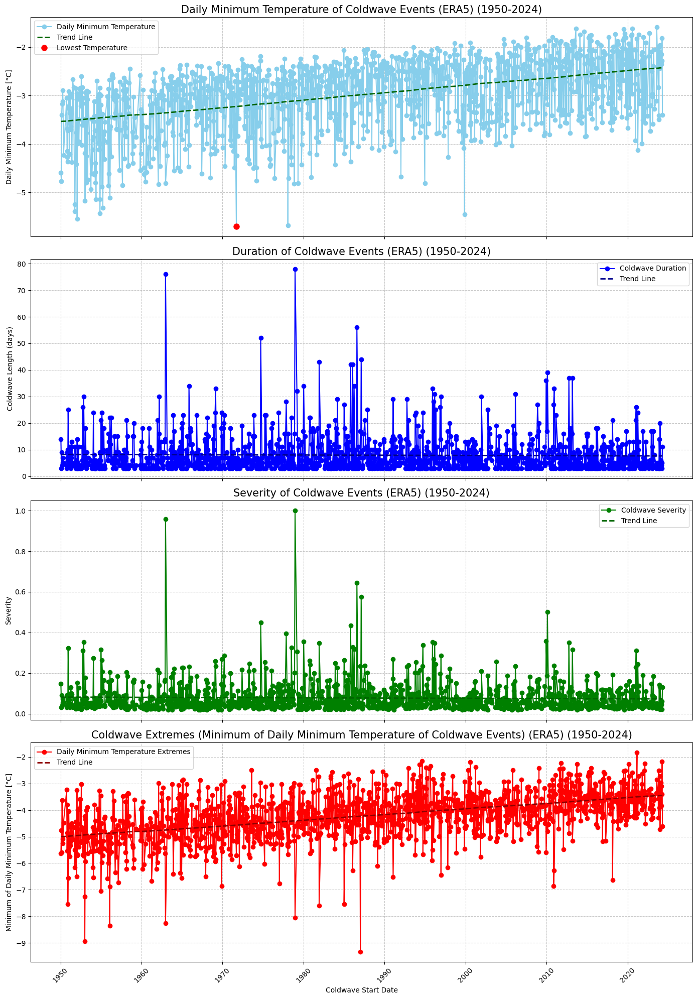

In [299]:
from sklearn.linear_model import LinearRegression

# Convert DataArrays to numpy arrays
tasmin_values = coldwave_dataset['tasmin'].values
length_values = coldwave_dataset['length'].values
severity_values = coldwave_dataset['severity'].values
min_temps_values = coldwave_dataset['min_temps'].values

# Numeric index representation
num_indices = np.arange(len(coldwave_dataset['start_date']))

# Initialize the linear regression model
model = LinearRegression()

# Create figure and subplots
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14, 20), sharex=True)

# Plot for Daily Minimum Temperature
ax1.plot(coldwave_dataset['start_date'], tasmin_values, linestyle='-', color='skyblue', marker='o', label='Daily Minimum Temperature', markersize=6)
model.fit(num_indices.reshape(-1, 1), tasmin_values)
trend_line_tasmin = model.predict(num_indices.reshape(-1, 1))
ax1.plot(coldwave_dataset['start_date'], trend_line_tasmin, color='darkgreen', linestyle='--', linewidth=2, label='Trend Line')
min_temp_index = np.argmin(tasmin_values)
ax1.plot(coldwave_dataset['start_date'].values[min_temp_index], tasmin_values[min_temp_index], 'ro', markersize=8, label='Lowest Temperature')
ax1.set_ylabel('Daily Minimum Temperature [°C]')
ax1.set_title('Daily Minimum Temperature of Coldwave Events (ERA5) (1950-2024)', fontsize=15)
ax1.legend()
ax1.grid(True, linestyle='--', alpha=0.7)
ax1.tick_params(axis='x', rotation=45)

# Plot for Coldwave Duration
ax2.plot(coldwave_dataset['start_date'], length_values, linestyle='-', color='b', marker='o', label='Coldwave Duration', markersize=6)
model.fit(num_indices.reshape(-1, 1), length_values)
trend_line_length = model.predict(num_indices.reshape(-1, 1))
ax2.plot(coldwave_dataset['start_date'], trend_line_length, color='darkblue', linestyle='--', linewidth=2, label='Trend Line')
ax2.set_ylabel('Coldwave Length (days)')
ax2.set_title('Duration of Coldwave Events (ERA5) (1950-2024)', fontsize=15)
ax2.legend()
ax2.grid(True, linestyle='--', alpha=0.7)
ax2.tick_params(axis='x', rotation=45)

# Plot for Coldwave Severity
ax3.plot(coldwave_dataset['start_date'], severity_values, linestyle='-', color='g', marker='o', label='Coldwave Severity', markersize=6)
model.fit(num_indices.reshape(-1, 1), severity_values)
trend_line_severity = model.predict(num_indices.reshape(-1, 1))
ax3.plot(coldwave_dataset['start_date'], trend_line_severity, color='darkgreen', linestyle='--', linewidth=2, label='Trend Line')
ax3.set_ylabel('Severity')
ax3.set_title('Severity of Coldwave Events (ERA5) (1950-2024)', fontsize=15)
ax3.legend()
ax3.grid(True, linestyle='--', alpha=0.7)
ax3.tick_params(axis='x', rotation=45)

# Plot for Minimum Temperature Extremes
ax4.plot(coldwave_dataset['start_date'], min_temps_values, linestyle='-', color='red', marker='o', label='Daily Minimum Temperature Extremes', markersize=6)
model.fit(num_indices.reshape(-1, 1), min_temps_values)
trend_line_min_temps = model.predict(num_indices.reshape(-1, 1))
ax4.plot(coldwave_dataset['start_date'], trend_line_min_temps, color='darkred', linestyle='--', linewidth=2, label='Trend Line')
ax4.set_xlabel('Coldwave Start Date')
ax4.set_ylabel('Minimum of Daily Minimum Temperature [°C]')
ax4.set_title('Coldwave Extremes (Minimum of Daily Minimum Temperature of Coldwave Events) (ERA5) (1950-2024)', fontsize=15)
ax4.legend()
ax4.grid(True, linestyle='--', alpha=0.7)
ax4.tick_params(axis='x', rotation=45)

# Adjust layout and save plot
plt.tight_layout()
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_events_points_plot_trends.png', dpi=300)
plt.show()


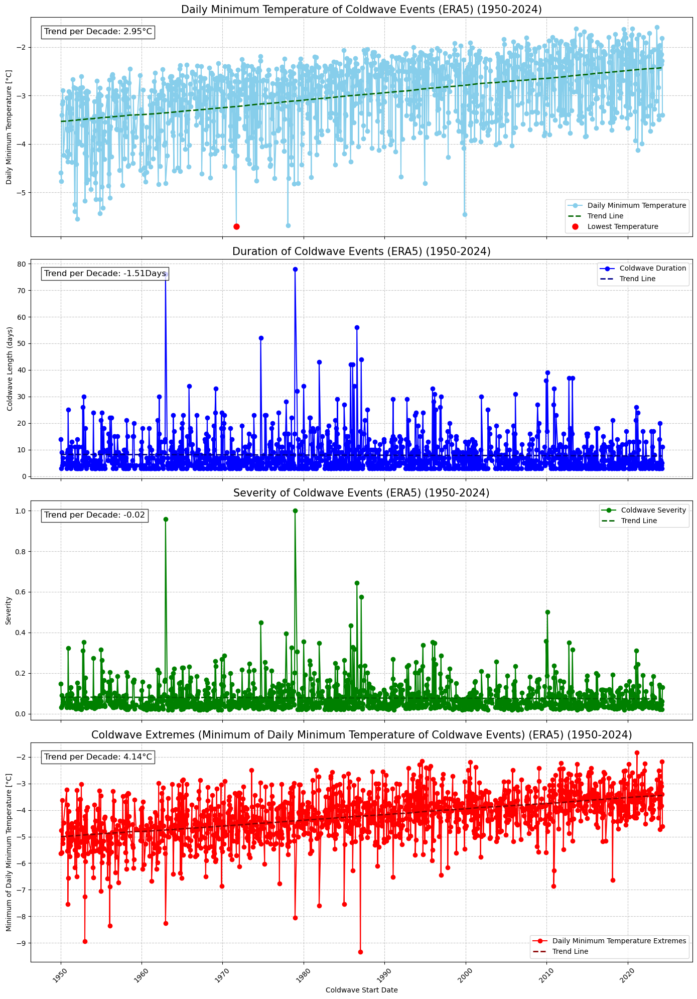

In [323]:
from sklearn.linear_model import LinearRegression
import numpy as np
import matplotlib.pyplot as plt

# Convert DataArrays to numpy arrays
tasmin_values = coldwave_dataset['tasmin'].values
length_values = coldwave_dataset['length'].values
severity_values = coldwave_dataset['severity'].values
min_temps_values = coldwave_dataset['min_temps'].values

# Numeric index representation
num_indices = np.arange(len(coldwave_dataset['start_date']))

# Calculate number of years in the dataset
start_year = coldwave_dataset['start_date'].dt.year[0]
end_year = coldwave_dataset['start_date'].dt.year[-1]
num_years = (end_year - start_year) + 1

# Initialize the linear regression model
model = LinearRegression()

# Create figure and subplots
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14, 20), sharex=True)

# Function to add trend annotation
def add_trend_annotation(ax, slope, num_days_per_decade=3652.5):
    trend_per_decade = float(slope) * num_days_per_decade  # Ensure slope is a scalar and convert it to per-decade trend
    ax.text(0.02, 0.95, f'Trend per Decade: {trend_per_decade:.2f}°C', 
            transform=ax.transAxes, fontsize=12, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.8))

def add_trend_annotation_days(ax, slope, num_days_per_decade=3652.5):
    trend_per_decade = float(slope) * num_days_per_decade  # Ensure slope is a scalar and convert it to per-decade trend
    ax.text(0.02, 0.95, f'Trend per Decade: {trend_per_decade:.2f}Days', 
            transform=ax.transAxes, fontsize=12, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.8))
    
def add_trend_annotation_severity(ax, slope, num_days_per_decade=3652.5):
    trend_per_decade = float(slope) * num_days_per_decade  # Ensure slope is a scalar and convert it to per-decade trend
    ax.text(0.02, 0.95, f'Trend per Decade: {trend_per_decade:.2f}', 
            transform=ax.transAxes, fontsize=12, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.8))


# Plot for Daily Minimum Temperature
ax1.plot(coldwave_dataset['start_date'], tasmin_values, linestyle='-', color='skyblue', marker='o', label='Daily Minimum Temperature', markersize=6)
model.fit(num_indices.reshape(-1, 1), tasmin_values)
trend_line_tasmin = model.predict(num_indices.reshape(-1, 1))
ax1.plot(coldwave_dataset['start_date'], trend_line_tasmin, color='darkgreen', linestyle='--', linewidth=2, label='Trend Line')
min_temp_index = np.argmin(tasmin_values)
ax1.plot(coldwave_dataset['start_date'].values[min_temp_index], tasmin_values[min_temp_index], 'ro', markersize=8, label='Lowest Temperature')
ax1.set_ylabel('Daily Minimum Temperature [°C]')
ax1.set_title('Daily Minimum Temperature of Coldwave Events (ERA5) (1950-2024)', fontsize=15)
ax1.legend(loc='lower right')  # Adjusted legend location
ax1.grid(True, linestyle='--', alpha=0.7)
ax1.tick_params(axis='x', rotation=45)
add_trend_annotation(ax1, model.coef_[0])

# Plot for Coldwave Duration
ax2.plot(coldwave_dataset['start_date'], length_values, linestyle='-', color='b', marker='o', label='Coldwave Duration', markersize=6)
model.fit(num_indices.reshape(-1, 1), length_values)
trend_line_length = model.predict(num_indices.reshape(-1, 1))
ax2.plot(coldwave_dataset['start_date'], trend_line_length, color='darkblue', linestyle='--', linewidth=2, label='Trend Line')
ax2.set_ylabel('Coldwave Length (days)')
ax2.set_title('Duration of Coldwave Events (ERA5) (1950-2024)', fontsize=15)
ax2.legend()
ax2.grid(True, linestyle='--', alpha=0.7)
ax2.tick_params(axis='x', rotation=45)
add_trend_annotation_days(ax2, model.coef_[0])

# Plot for Coldwave Severity
ax3.plot(coldwave_dataset['start_date'], severity_values, linestyle='-', color='g', marker='o', label='Coldwave Severity', markersize=6)
model.fit(num_indices.reshape(-1, 1), severity_values)
trend_line_severity = model.predict(num_indices.reshape(-1, 1))
ax3.plot(coldwave_dataset['start_date'], trend_line_severity, color='darkgreen', linestyle='--', linewidth=2, label='Trend Line')
ax3.set_ylabel('Severity')
ax3.set_title('Severity of Coldwave Events (ERA5) (1950-2024)', fontsize=15)
ax3.legend()
ax3.grid(True, linestyle='--', alpha=0.7)
ax3.tick_params(axis='x', rotation=45)
add_trend_annotation_severity(ax3, model.coef_[0])

# Plot for Minimum Temperature Extremes
ax4.plot(coldwave_dataset['start_date'], min_temps_values, linestyle='-', color='red', marker='o', label='Daily Minimum Temperature Extremes', markersize=6)
model.fit(num_indices.reshape(-1, 1), min_temps_values)
trend_line_min_temps = model.predict(num_indices.reshape(-1, 1))
ax4.plot(coldwave_dataset['start_date'], trend_line_min_temps, color='darkred', linestyle='--', linewidth=2, label='Trend Line')
ax4.set_xlabel('Coldwave Start Date')
ax4.set_ylabel('Minimum of Daily Minimum Temperature [°C]')
ax4.set_title('Coldwave Extremes (Minimum of Daily Minimum Temperature of Coldwave Events) (ERA5) (1950-2024)', fontsize=15)
ax4.legend(loc='lower right')  # Adjusted legend location
ax4.grid(True, linestyle='--', alpha=0.7)
ax4.tick_params(axis='x', rotation=45)
add_trend_annotation(ax4, model.coef_[0])

# Adjust layout and save plot
plt.tight_layout()
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_events_points_plot_trends_perdecade.png', dpi=300)
plt.show()


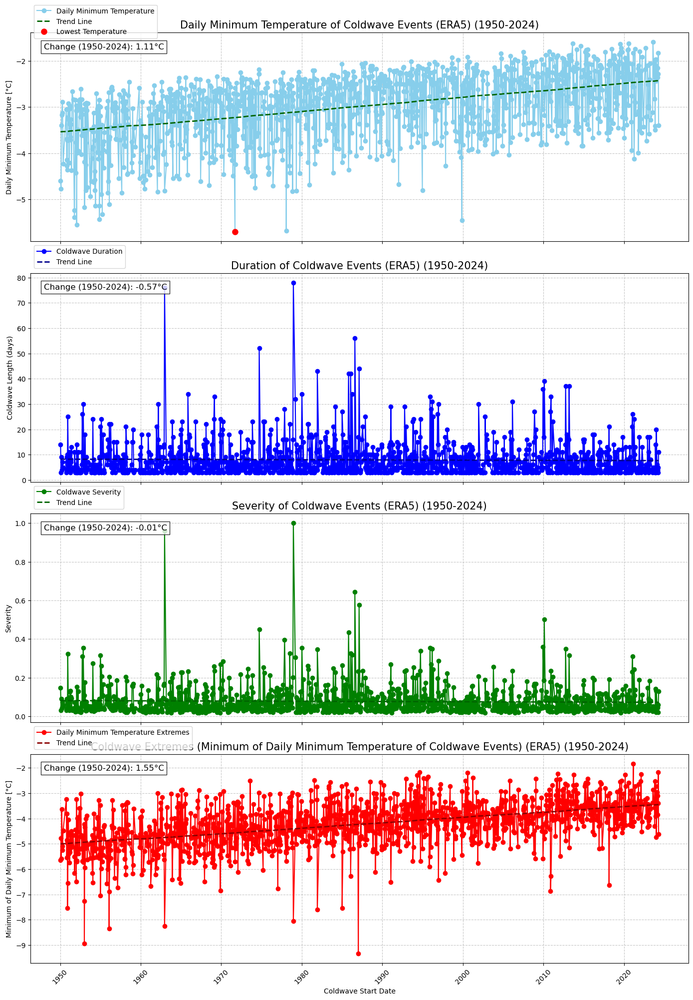

In [71]:
from sklearn.linear_model import LinearRegression
import numpy as np
import matplotlib.pyplot as plt

# Convert DataArrays to numpy arrays
tasmin_values = coldwave_dataset['tasmin'].values
length_values = coldwave_dataset['length'].values
severity_values = coldwave_dataset['severity'].values
min_temps_values = coldwave_dataset['min_temps'].values

# Numeric index representation
num_indices = np.arange(len(coldwave_dataset['start_date']))

# Initialize the linear regression model
model = LinearRegression()

# Create figure and subplots
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14, 20), sharex=True)

# Function to add trend annotation
def add_change_annotation(ax, start_value, end_value):
    change = end_value - start_value
    ax.text(0.02, 0.95, f'Change (1950-2024): {change:.2f}°C', 
            transform=ax.transAxes, fontsize=12, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.8))

# Plot for Daily Minimum Temperature
ax1.plot(coldwave_dataset['start_date'], tasmin_values, linestyle='-', color='skyblue', marker='o', label='Daily Minimum Temperature', markersize=6)
model.fit(num_indices.reshape(-1, 1), tasmin_values)
trend_line_tasmin = model.predict(num_indices.reshape(-1, 1))
ax1.plot(coldwave_dataset['start_date'], trend_line_tasmin, color='darkgreen', linestyle='--', linewidth=2, label='Trend Line')
min_temp_index = np.argmin(tasmin_values)
ax1.plot(coldwave_dataset['start_date'].values[min_temp_index], tasmin_values[min_temp_index], 'ro', markersize=8, label='Lowest Temperature')
ax1.set_ylabel('Daily Minimum Temperature [°C]')
ax1.set_title('Daily Minimum Temperature of Coldwave Events (ERA5) (1950-2024)', fontsize=15)
ax1.legend(loc='upper left', bbox_to_anchor=(0, 1.15))
ax1.grid(True, linestyle='--', alpha=0.7)
ax1.tick_params(axis='x', rotation=45)
# Calculate and display the change
start_index = 0
end_index = len(num_indices) - 1
start_value_tasmin = trend_line_tasmin[start_index]
end_value_tasmin = trend_line_tasmin[end_index]
add_change_annotation(ax1, start_value_tasmin, end_value_tasmin)

# Plot for Coldwave Duration
ax2.plot(coldwave_dataset['start_date'], length_values, linestyle='-', color='b', marker='o', label='Coldwave Duration', markersize=6)
model.fit(num_indices.reshape(-1, 1), length_values)
trend_line_length = model.predict(num_indices.reshape(-1, 1))
ax2.plot(coldwave_dataset['start_date'], trend_line_length, color='darkblue', linestyle='--', linewidth=2, label='Trend Line')
ax2.set_ylabel('Coldwave Length (days)')
ax2.set_title('Duration of Coldwave Events (ERA5) (1950-2024)', fontsize=15)
ax2.legend(loc='upper left', bbox_to_anchor=(0, 1.15))
ax2.grid(True, linestyle='--', alpha=0.7)
ax2.tick_params(axis='x', rotation=45)
# Calculate and display the change
start_value_length = trend_line_length[start_index]
end_value_length = trend_line_length[end_index]
add_change_annotation(ax2, start_value_length, end_value_length)

# Plot for Coldwave Severity
ax3.plot(coldwave_dataset['start_date'], severity_values, linestyle='-', color='g', marker='o', label='Coldwave Severity', markersize=6)
model.fit(num_indices.reshape(-1, 1), severity_values)
trend_line_severity = model.predict(num_indices.reshape(-1, 1))
ax3.plot(coldwave_dataset['start_date'], trend_line_severity, color='darkgreen', linestyle='--', linewidth=2, label='Trend Line')
ax3.set_ylabel('Severity')
ax3.set_title('Severity of Coldwave Events (ERA5) (1950-2024)', fontsize=15)
ax3.legend(loc='upper left', bbox_to_anchor=(0, 1.15))
ax3.grid(True, linestyle='--', alpha=0.7)
ax3.tick_params(axis='x', rotation=45)
# Calculate and display the change
start_value_severity = trend_line_severity[start_index]
end_value_severity = trend_line_severity[end_index]
add_change_annotation(ax3, start_value_severity, end_value_severity)

# Plot for Minimum Temperature Extremes
ax4.plot(coldwave_dataset['start_date'], min_temps_values, linestyle='-', color='red', marker='o', label='Daily Minimum Temperature Extremes', markersize=6)
model.fit(num_indices.reshape(-1, 1), min_temps_values)
trend_line_min_temps = model.predict(num_indices.reshape(-1, 1))
ax4.plot(coldwave_dataset['start_date'], trend_line_min_temps, color='darkred', linestyle='--', linewidth=2, label='Trend Line')
ax4.set_xlabel('Coldwave Start Date')
ax4.set_ylabel('Minimum of Daily Minimum Temperature [°C]')
ax4.set_title('Coldwave Extremes (Minimum of Daily Minimum Temperature of Coldwave Events) (ERA5) (1950-2024)', fontsize=15)
ax4.legend(loc='upper left', bbox_to_anchor=(0, 1.15))
ax4.grid(True, linestyle='--', alpha=0.7)
ax4.tick_params(axis='x', rotation=45)
# Calculate and display the change
start_value_min_temps = trend_line_min_temps[start_index]
end_value_min_temps = trend_line_min_temps[end_index]
add_change_annotation(ax4, start_value_min_temps, end_value_min_temps)

# Adjust layout and save plot
plt.tight_layout()
#plt.savefig('path_to_save.png', dpi=300)
plt.show()


In [77]:
num_decades = 74/10

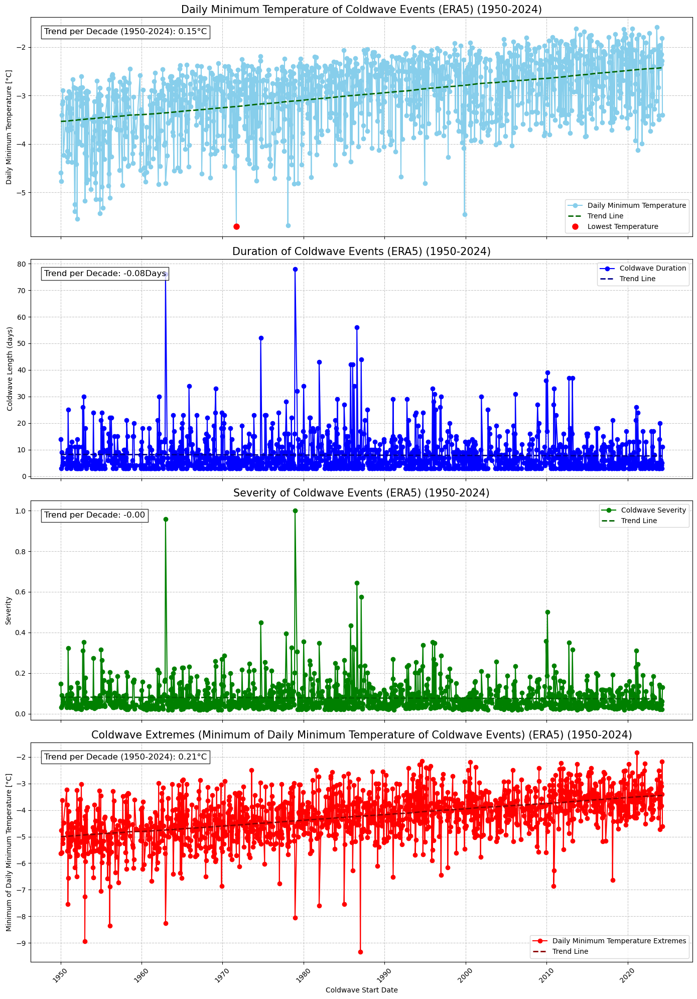

In [107]:
from sklearn.linear_model import LinearRegression
import numpy as np
import matplotlib.pyplot as plt

# Convert DataArrays to numpy arrays
tasmin_values = coldwave_dataset['tasmin'].values
length_values = coldwave_dataset['length'].values
severity_values = coldwave_dataset['severity'].values
min_temps_values = coldwave_dataset['min_temps'].values

# Numeric index representation
num_indices = np.arange(len(coldwave_dataset['start_date']))

# Initialize the linear regression model
model = LinearRegression()

# Create figure and subplots
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14, 20), sharex=True)

# Function to add change annotation
def add_change_annotation(ax, start_value, end_value):
    change = end_value - start_value
    trend_per_decade = change / num_decades
    ax.text(0.02, 0.95, f'Trend per Decade (1950-2024): {trend_per_decade:.2f}°C', 
            transform=ax.transAxes, fontsize=12, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.8)) 

def add_trend_annotation_days(ax, start_value, end_value):
    change = end_value - start_value
    trend_per_decade = change / num_decades
    ax.text(0.02, 0.95, f'Trend per Decade: {trend_per_decade:.2f}Days', 
            transform=ax.transAxes, fontsize=12, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.8))
    
def add_trend_annotation_severity(ax, start_value, end_value):
    change = end_value - start_value
    trend_per_decade = change / num_decades
    ax.text(0.02, 0.95, f'Trend per Decade: {trend_per_decade:.2f}', 
            transform=ax.transAxes, fontsize=12, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.8)) 

# Plot for Daily Minimum Temperature
ax1.plot(coldwave_dataset['start_date'], tasmin_values, linestyle='-', color='skyblue', marker='o', label='Daily Minimum Temperature', markersize=6)
model.fit(num_indices.reshape(-1, 1), tasmin_values)
trend_line_tasmin = model.predict(num_indices.reshape(-1, 1))
ax1.plot(coldwave_dataset['start_date'], trend_line_tasmin, color='darkgreen', linestyle='--', linewidth=2, label='Trend Line')
min_temp_index = np.argmin(tasmin_values)
ax1.plot(coldwave_dataset['start_date'].values[min_temp_index], tasmin_values[min_temp_index], 'ro', markersize=8, label='Lowest Temperature')
ax1.set_ylabel('Daily Minimum Temperature [°C]')
ax1.set_title('Daily Minimum Temperature of Coldwave Events (ERA5) (1950-2024)', fontsize=15)
ax1.legend(loc='lower right')
ax1.grid(True, linestyle='--', alpha=0.7)
ax1.tick_params(axis='x', rotation=45)
# Calculate and display the change
start_value_tasmin = trend_line_tasmin[0]  # Start of trend line
end_value_tasmin = trend_line_tasmin[-1]  # End of trend line
add_change_annotation(ax1, start_value_tasmin, end_value_tasmin)

# Plot for Coldwave Duration
ax2.plot(coldwave_dataset['start_date'], length_values, linestyle='-', color='b', marker='o', label='Coldwave Duration', markersize=6)
model.fit(num_indices.reshape(-1, 1), length_values)
trend_line_length = model.predict(num_indices.reshape(-1, 1))
ax2.plot(coldwave_dataset['start_date'], trend_line_length, color='darkblue', linestyle='--', linewidth=2, label='Trend Line')
ax2.set_ylabel('Coldwave Length (days)')
ax2.set_title('Duration of Coldwave Events (ERA5) (1950-2024)', fontsize=15)
ax2.legend(loc='upper right')
ax2.grid(True, linestyle='--', alpha=0.7)
ax2.tick_params(axis='x', rotation=45)
# Calculate and display the change
start_value_length = trend_line_length[0]  # Start of trend line
end_value_length = trend_line_length[-1]  # End of trend line
add_trend_annotation_days(ax2, start_value_length, end_value_length)

# Plot for Coldwave Severity
ax3.plot(coldwave_dataset['start_date'], severity_values, linestyle='-', color='g', marker='o', label='Coldwave Severity', markersize=6)
model.fit(num_indices.reshape(-1, 1), severity_values)
trend_line_severity = model.predict(num_indices.reshape(-1, 1))
ax3.plot(coldwave_dataset['start_date'], trend_line_severity, color='darkgreen', linestyle='--', linewidth=2, label='Trend Line')
ax3.set_ylabel('Severity')
ax3.set_title('Severity of Coldwave Events (ERA5) (1950-2024)', fontsize=15)
ax3.legend(loc='upper right')
ax3.grid(True, linestyle='--', alpha=0.7)
ax3.tick_params(axis='x', rotation=45)
# Calculate and display the change
start_value_severity = trend_line_severity[0]  # Start of trend line
end_value_severity = trend_line_severity[-1]  # End of trend line
add_trend_annotation_severity(ax3, start_value_severity, end_value_severity)

# Plot for Minimum Temperature Extremes
ax4.plot(coldwave_dataset['start_date'], min_temps_values, linestyle='-', color='red', marker='o', label='Daily Minimum Temperature Extremes', markersize=6)
model.fit(num_indices.reshape(-1, 1), min_temps_values)
trend_line_min_temps = model.predict(num_indices.reshape(-1, 1))
ax4.plot(coldwave_dataset['start_date'], trend_line_min_temps, color='darkred', linestyle='--', linewidth=2, label='Trend Line')
ax4.set_xlabel('Coldwave Start Date')
ax4.set_ylabel('Minimum of Daily Minimum Temperature [°C]')
ax4.set_title('Coldwave Extremes (Minimum of Daily Minimum Temperature of Coldwave Events) (ERA5) (1950-2024)', fontsize=15)
ax4.legend(loc='lower right')
ax4.grid(True, linestyle='--', alpha=0.7)
ax4.tick_params(axis='x', rotation=45)
# Calculate and display the change
start_value_min_temps = trend_line_min_temps[0]  # Start of trend line
end_value_min_temps = trend_line_min_temps[-1]  # End of trend line
add_change_annotation(ax4, start_value_min_temps, end_value_min_temps)

# Adjust layout and save plot
plt.tight_layout()
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_events_metrics_plot_trends_perdecade.png', dpi=300)
plt.show()


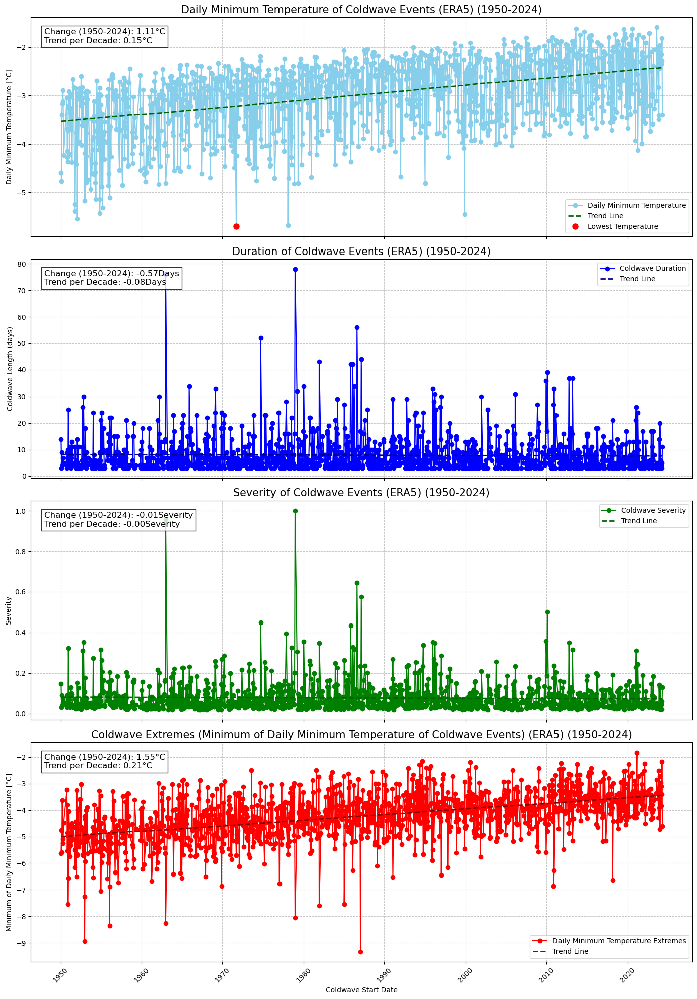

In [103]:
from sklearn.linear_model import LinearRegression
import numpy as np
import matplotlib.pyplot as plt

# Convert DataArrays to numpy arrays
tasmin_values = coldwave_dataset['tasmin'].values
length_values = coldwave_dataset['length'].values
severity_values = coldwave_dataset['severity'].values
min_temps_values = coldwave_dataset['min_temps'].values

# Numeric index representation
num_indices = np.arange(len(coldwave_dataset['start_date']))

# Initialize the linear regression model
model = LinearRegression()

# Create figure and subplots
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14, 20), sharex=True)

# Function to add change and trend per decade annotation
def add_change_and_trend_annotation(ax, start_value, end_value, units='°C'):
    # Calculate change
    change = end_value - start_value
    
    # Calculate trend per decade
    trend_per_decade = change / num_decades
    
    # Format and display annotations
    ax.text(0.02, 0.95, f'Change (1950-2024): {change:.2f}{units}\n'
                         f'Trend per Decade: {trend_per_decade:.2f}{units}', 
            transform=ax.transAxes, fontsize=12, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.8))


# Function to add change and trend per decade annotation
def add_change_and_trend_annotation_days(ax, start_value, end_value, units='Days'):
    # Calculate change
    change = end_value - start_value
    
    # Calculate trend per decade
    trend_per_decade = change / num_decades
    
    # Format and display annotations
    ax.text(0.02, 0.95, f'Change (1950-2024): {change:.2f}{units}\n'
                         f'Trend per Decade: {trend_per_decade:.2f}{units}', 
            transform=ax.transAxes, fontsize=12, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.8))

# Function to add change and trend per decade annotation
def add_change_and_trend_annotation_severity(ax, start_value, end_value, units='Severity'):
    # Calculate change
    change = end_value - start_value
    
    # Calculate trend per decade
    trend_per_decade = change / num_decades
    
    # Format and display annotations
    ax.text(0.02, 0.95, f'Change (1950-2024): {change:.2f}{units}\n'
                         f'Trend per Decade: {trend_per_decade:.2f}{units}', 
            transform=ax.transAxes, fontsize=12, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.8))


# Plot for Daily Minimum Temperature
ax1.plot(coldwave_dataset['start_date'], tasmin_values, linestyle='-', color='skyblue', marker='o', label='Daily Minimum Temperature', markersize=6)
model.fit(num_indices.reshape(-1, 1), tasmin_values)
trend_line_tasmin = model.predict(num_indices.reshape(-1, 1))
ax1.plot(coldwave_dataset['start_date'], trend_line_tasmin, color='darkgreen', linestyle='--', linewidth=2, label='Trend Line')
min_temp_index = np.argmin(tasmin_values)
ax1.plot(coldwave_dataset['start_date'].values[min_temp_index], tasmin_values[min_temp_index], 'ro', markersize=8, label='Lowest Temperature')
ax1.set_ylabel('Daily Minimum Temperature [°C]')
ax1.set_title('Daily Minimum Temperature of Coldwave Events (ERA5) (1950-2024)', fontsize=15)
ax1.legend(loc='lower right')
ax1.grid(True, linestyle='--', alpha=0.7)
ax1.tick_params(axis='x', rotation=45)
# Calculate and display the change
start_value_tasmin = trend_line_tasmin[0]  # Start of trend line
end_value_tasmin = trend_line_tasmin[-1]  # End of trend line
add_change_and_trend_annotation(ax1, start_value_tasmin, end_value_tasmin)


# Plot for Coldwave Duration
ax2.plot(coldwave_dataset['start_date'], length_values, linestyle='-', color='b', marker='o', label='Coldwave Duration', markersize=6)
model.fit(num_indices.reshape(-1, 1), length_values)
trend_line_length = model.predict(num_indices.reshape(-1, 1))
ax2.plot(coldwave_dataset['start_date'], trend_line_length, color='darkblue', linestyle='--', linewidth=2, label='Trend Line')
ax2.set_ylabel('Coldwave Length (days)')
ax2.set_title('Duration of Coldwave Events (ERA5) (1950-2024)', fontsize=15)
ax2.legend(loc='upper right')
ax2.grid(True, linestyle='--', alpha=0.7)
ax2.tick_params(axis='x', rotation=45)
# Calculate and display the change
start_value_length = trend_line_length[0]  # Start of trend line
end_value_length = trend_line_length[-1]  # End of trend line
add_change_and_trend_annotation_days(ax2, start_value_length, end_value_length)


# Plot for Coldwave Severity
ax3.plot(coldwave_dataset['start_date'], severity_values, linestyle='-', color='g', marker='o', label='Coldwave Severity', markersize=6)
model.fit(num_indices.reshape(-1, 1), severity_values)
trend_line_severity = model.predict(num_indices.reshape(-1, 1))
ax3.plot(coldwave_dataset['start_date'], trend_line_severity, color='darkgreen', linestyle='--', linewidth=2, label='Trend Line')
ax3.set_ylabel('Severity')
ax3.set_title('Severity of Coldwave Events (ERA5) (1950-2024)', fontsize=15)
ax3.legend(loc='upper right')
ax3.grid(True, linestyle='--', alpha=0.7)
ax3.tick_params(axis='x', rotation=45)
# Calculate and display the change
start_value_severity = trend_line_severity[0]  # Start of trend line
end_value_severity = trend_line_severity[-1]  # End of trend line
add_change_and_trend_annotation_severity(ax3, start_value_severity, end_value_severity)

# Plot for Minimum Temperature Extremes
ax4.plot(coldwave_dataset['start_date'], min_temps_values, linestyle='-', color='red', marker='o', label='Daily Minimum Temperature Extremes', markersize=6)
model.fit(num_indices.reshape(-1, 1), min_temps_values)
trend_line_min_temps = model.predict(num_indices.reshape(-1, 1))
ax4.plot(coldwave_dataset['start_date'], trend_line_min_temps, color='darkred', linestyle='--', linewidth=2, label='Trend Line')
ax4.set_xlabel('Coldwave Start Date')
ax4.set_ylabel('Minimum of Daily Minimum Temperature [°C]')
ax4.set_title('Coldwave Extremes (Minimum of Daily Minimum Temperature of Coldwave Events) (ERA5) (1950-2024)', fontsize=15)
ax4.legend(loc='lower right')
ax4.grid(True, linestyle='--', alpha=0.7)
ax4.tick_params(axis='x', rotation=45)
# Calculate and display the change
start_value_min_temps = trend_line_min_temps[0]  # Start of trend line
end_value_min_temps = trend_line_min_temps[-1]  # End of trend line
add_change_and_trend_annotation(ax4, start_value_min_temps, end_value_min_temps)

# Adjust layout and save plot
plt.tight_layout()
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_events_metrics_plot_trends_change_perdecade.png', dpi=300)
plt.show()


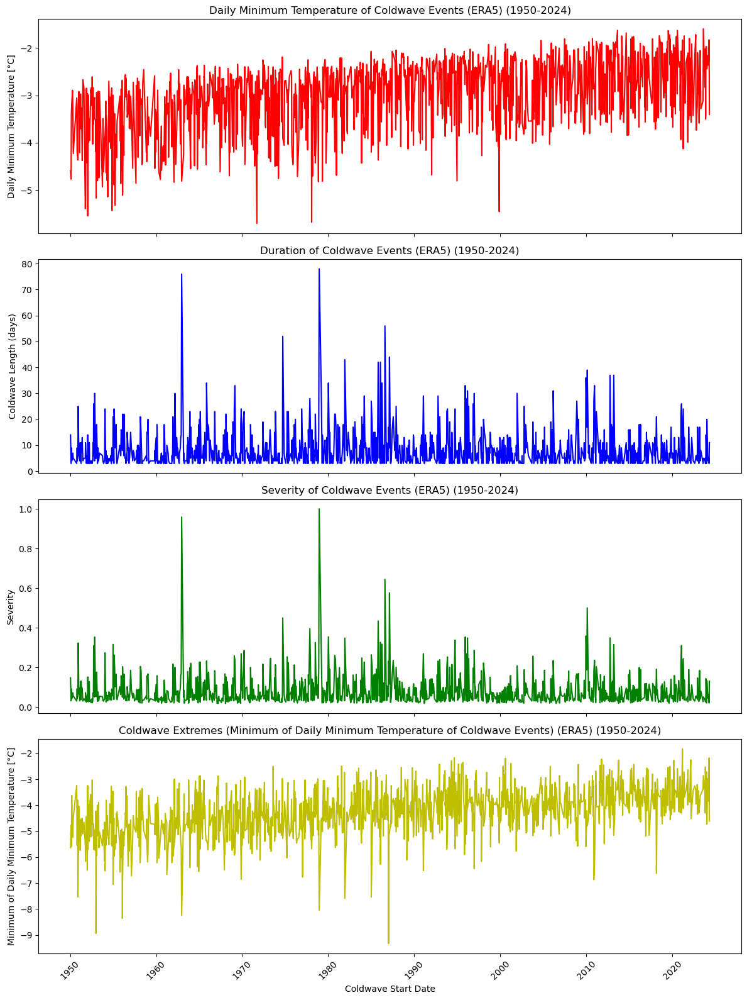

In [325]:
# Create figure and subplots
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(12, 16), sharex=True)

# Plot the tasmin of each coldwave on ax1
ax1.plot(coldwave_dataset['start_date'], coldwave_dataset['tasmin'], linestyle='-', color='r')
ax1.set_ylabel('Daily Minimum Temperature [°C]')
ax1.set_title('Daily Minimum Temperature of Coldwave Events (ERA5) (1950-2024)')
ax1.tick_params(axis='x', rotation=45)

# Plot the lengths of each coldwave on ax2
ax2.plot(coldwave_dataset['start_date'], coldwave_dataset['length'], linestyle='-', color='b')
ax2.set_ylabel('Coldwave Length (days)')
ax2.set_title('Duration of Coldwave Events (ERA5) (1950-2024)')
ax2.tick_params(axis='x', rotation=45)

# Plot the severity of each coldwave on ax3
ax3.plot(coldwave_dataset['start_date'], coldwave_dataset['severity'], linestyle='-', color='g')
#ax3.set_xlabel('Coldwave Start Date')
ax3.set_ylabel('Severity')
ax3.set_title('Severity of Coldwave Events (ERA5) (1950-2024)')
ax3.tick_params(axis='x', rotation=45)

# Plot the extremes of each coldwave on ax4
ax4.plot(coldwave_dataset['start_date'], coldwave_dataset['min_temps'], linestyle='-', color='y')
ax4.set_xlabel('Coldwave Start Date')
ax4.set_ylabel('Minimum of Daily Minimum Temperature [°C]')
ax4.set_title('Coldwave Extremes (Minimum of Daily Minimum Temperature of Coldwave Events) (ERA5) (1950-2024)')
#ax4.legend()
ax4.tick_params(axis='x', rotation=45)

# Adjust layout and save plot
plt.tight_layout()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_events_plot.png', dpi=300)

# Show the plot
plt.show()

# 16. Spatial plots (Tasmin)

In [471]:
print(ds_combined)

<xarray.Dataset> Size: 240MB
Dimensions:      (time: 27169, lon: 49, lat: 45)
Coordinates:
  * time         (time) datetime64[ns] 217kB 1950-01-01T12:00:00 ... 2024-05-...
  * lon          (lon) float64 392B -8.0 -7.75 -7.5 -7.25 ... 3.25 3.5 3.75 4.0
  * lat          (lat) float64 360B 60.0 59.75 59.5 59.25 ... 49.5 49.25 49.0
Data variables:
    tasmin       (time, lat, lon) float32 240MB 280.9 280.9 ... 281.7 281.3
    cold_events  (time) int32 109kB 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0


In [329]:
# Define the time periods using datetime64
start_period1 = np.datetime64('1950-01-01')
end_period1 = np.datetime64('1970-12-30')
start_period2 = np.datetime64('2000-01-01')
end_period2 = np.datetime64('2020-12-30')

# Extract the data for the two periods
data_period1 = ds_combined.sel(time=slice(start_period1, end_period1))
data_period2 = ds_combined.sel(time=slice(start_period2, end_period2))

In [330]:
# Calculate the average anomalies for each period
mean_period1 = data_period1.mean(dim='time')
mean_period2 = data_period2.mean(dim='time')

# Calculate the difference between the two periods
difference = mean_period2 - mean_period1

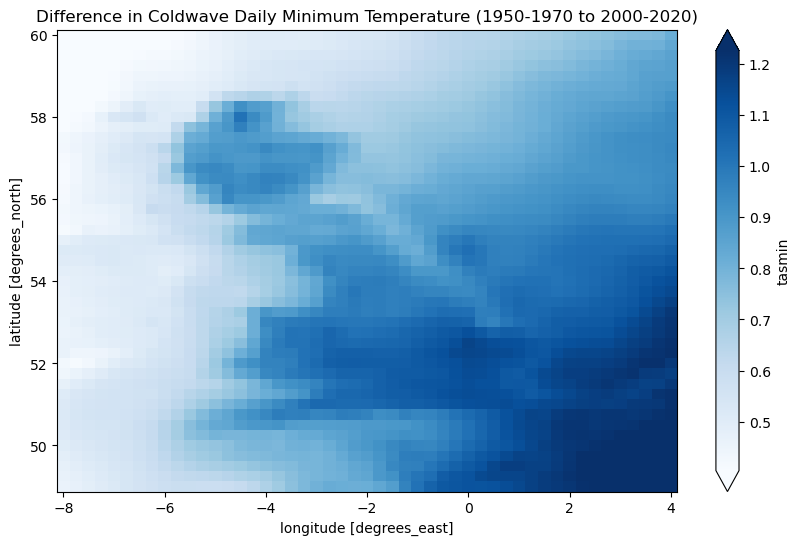

In [333]:
# Plot the difference
plt.figure(figsize=(10, 6))
ax = plt.gca()  # Get the current axis
difference['tasmin'].plot(ax=ax, cmap='Blues', robust=True)

# Set the title separately
plt.title('Difference in Coldwave Daily Minimum Temperature (1950-1970 to 2000-2020)')

plt.show()

In [334]:
mean_period1_C = mean_period1 - 273.15
mean_period2_C = mean_period2 - 273.15

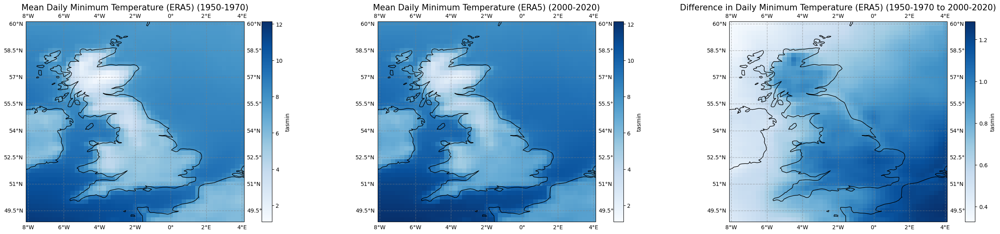

In [339]:
import cartopy.crs as ccrs

# Combine data from all temperature datasets to compute standardized colorbar limits
mean_period1_data = mean_period1_C['tasmin'].values.flatten()
mean_period2_data = mean_period2_C['tasmin'].values.flatten()
temperature_data = np.concatenate([mean_period1_data, mean_period2_data])

# Compute global vmin and vmax for temperature maps
temperature_vmin = np.min(temperature_data)
temperature_vmax = np.max(temperature_data)

# Compute vmin and vmax for the difference map
difference_data = difference['tasmin'].values.flatten()
difference_vmin = np.min(difference_data)
difference_vmax = np.max(difference_data)

# Create a figure and a set of subplots
fig, axes = plt.subplots(1, 3, figsize=(30, 6), subplot_kw={'projection': ccrs.PlateCarree()})

# Common settings for all subplots
for ax in axes:
    ax.coastlines(resolution='50m')
    ax.gridlines(draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='--')
    

# Plot the first map
c1 = mean_period1_C['tasmin'].plot(ax=axes[0], cmap='Blues', vmin=temperature_vmin, vmax=temperature_vmax, transform=ccrs.PlateCarree())
axes[0].set_title('Mean Daily Minimum Temperature (ERA5) (1950-1970)', fontsize=15)

# Plot the second map
c2 = mean_period2_C['tasmin'].plot(ax=axes[1], cmap='Blues', vmin=temperature_vmin, vmax=temperature_vmax, transform=ccrs.PlateCarree())
axes[1].set_title('Mean Daily Minimum Temperature (ERA5) (2000-2020)', fontsize=15)

# Plot the third map
c3 = difference['tasmin'].plot(ax=axes[2], cmap='Blues', vmin=difference_vmin, vmax=difference_vmax, transform=ccrs.PlateCarree())
axes[2].set_title('Difference in Daily Minimum Temperature (ERA5) (1950-1970 to 2000-2020)', fontsize=15)

# Adjust layout to prevent overlap
plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust for colorbar space

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/tasmin_maps_1950_2000.png', dpi=300)

# Show the combined figure
plt.show()

In [341]:
# Define the time periods using datetime64
start_period1950 = np.datetime64('1950-01-01')
end_period1980 = np.datetime64('1980-12-30')
start_period1990 = np.datetime64('1990-01-01')
end_period2020 = np.datetime64('2020-12-30')

# Extract the data for the two periods
data_period1950 = ds_combined.sel(time=slice(start_period1950, end_period1980))
data_period2020 = ds_combined.sel(time=slice(start_period1990, end_period2020))

In [342]:
# Calculate the average anomalies for each period
mean_period1950 = data_period1950.mean(dim='time')
mean_period2020 = data_period2020.mean(dim='time')

# Calculate the difference between the two periods
difference_1950_2020 = mean_period2020 - mean_period1950

In [344]:
mean_period_1950_C = mean_period1950 - 273.15
mean_period_2020_C = mean_period2020 - 273.15

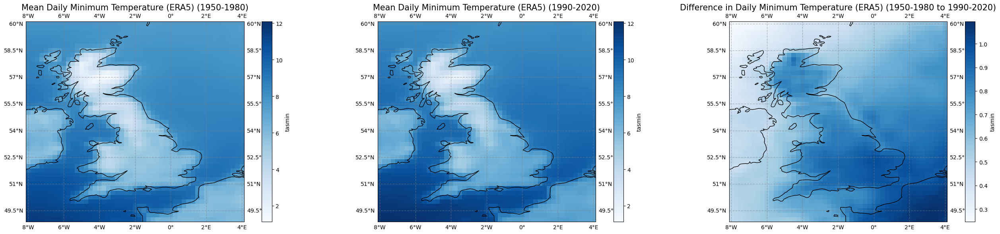

In [347]:
# Compute global vmin and vmax for the mean temperature maps
mean_temp_data = np.concatenate([
    mean_period_1950_C['tasmin'].values.flatten(),
    mean_period_2020_C['tasmin'].values.flatten()
])

mean_temp_vmin = np.min(mean_temp_data)
mean_temp_vmax = np.max(mean_temp_data)

# Compute global vmin and vmax for the difference map
difference_data = difference_1950_2020['tasmin'].values.flatten()
difference_vmin = np.min(difference_data)
difference_vmax = np.max(difference_data)

# Create a figure and a set of subplots
fig, axes = plt.subplots(1, 3, figsize=(30, 6), subplot_kw={'projection': ccrs.PlateCarree()})

# Common settings for all subplots
for ax in axes:
    ax.coastlines(resolution='50m')
    ax.gridlines(draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='--')

# Plot the first map
c1 = mean_period_1950_C['tasmin'].plot(ax=axes[0], cmap='Blues', vmin=mean_temp_vmin, vmax=mean_temp_vmax, transform=ccrs.PlateCarree())
axes[0].set_title('Mean Daily Minimum Temperature (ERA5) (1950-1980)', fontsize=15)

# Plot the second map
c2 = mean_period_2020_C['tasmin'].plot(ax=axes[1], cmap='Blues', vmin=mean_temp_vmin, vmax=mean_temp_vmax, transform=ccrs.PlateCarree())
axes[1].set_title('Mean Daily Minimum Temperature (ERA5) (1990-2020)', fontsize=15)

# Plot the third map
c3 = difference_1950_2020['tasmin'].plot(ax=axes[2], cmap='Blues', vmin=difference_vmin, vmax=difference_vmax, transform=ccrs.PlateCarree())
axes[2].set_title('Difference in Daily Minimum Temperature (ERA5) (1950-1980 to 1990-2020)', fontsize=15)

# Adjust layout for better spacing
plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust for colorbar space

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/tasmin_maps_1950_1990.png', dpi=300)

# Show the combined figure
plt.show()

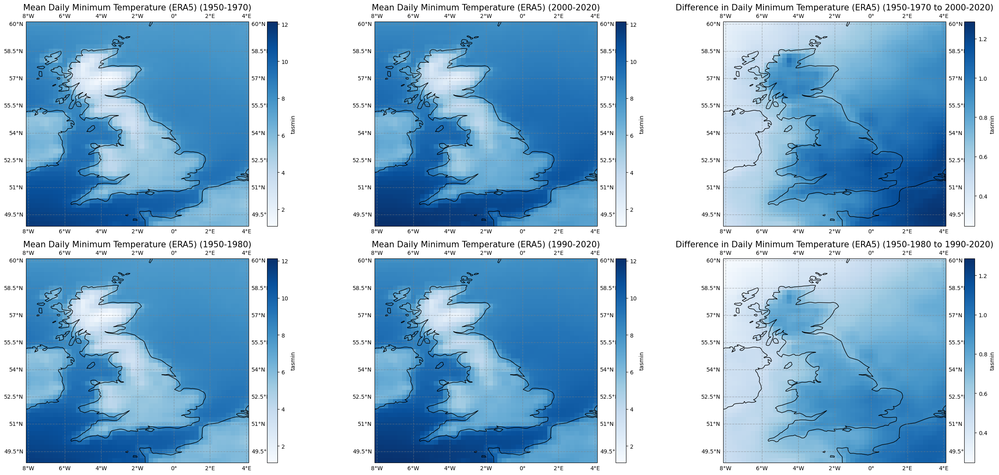

In [1137]:
# Compute global vmin and vmax for the mean temperature maps
mean_temp_data = np.concatenate([
    mean_period_1950_C['tasmin'].values.flatten(),
    mean_period_2020_C['tasmin'].values.flatten(),
    mean_period1_C['tasmin'].values.flatten(),
    mean_period2_C['tasmin'].values.flatten()
])

mean_temp_vmin = np.min(mean_temp_data)
mean_temp_vmax = np.max(mean_temp_data)

# Compute global vmin and vmax for the difference maps
difference_data = np.concatenate([
    difference_1950_2020['tasmin'].values.flatten(),
    difference['tasmin'].values.flatten()
])

difference_vmin = np.min(difference_data)
difference_vmax = np.max(difference_data)

# Create a figure and a set of subplots with 2 rows and 3 columns
fig, axes = plt.subplots(2, 3, figsize=(30, 12), subplot_kw={'projection': ccrs.PlateCarree()})

# Common settings for all subplots
for ax in axes.flatten():
    ax.coastlines(resolution='50m')
    ax.gridlines(draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='--')

# First row of plots
# Plot the first map
mean_period1_C['tasmin'].plot(ax=axes[0, 0], cmap='Blues', vmin=mean_temp_vmin, vmax=mean_temp_vmax)
axes[0, 0].set_title('Mean Daily Minimum Temperature (ERA5) (1950-1970)', fontsize=15)

# Plot the second map
mean_period2_C['tasmin'].plot(ax=axes[0, 1], cmap='Blues', vmin=mean_temp_vmin, vmax=mean_temp_vmax)
axes[0, 1].set_title('Mean Daily Minimum Temperature (ERA5) (2000-2020)', fontsize=15)

# Plot the third map
difference['tasmin'].plot(ax=axes[0, 2], cmap='Blues', vmin=difference_vmin, vmax=difference_vmax)
axes[0, 2].set_title('Difference in Daily Minimum Temperature (ERA5) (1950-1970 to 2000-2020)', fontsize=15)

# Second row of plots
# Plot the first map
mean_period_1950_C['tasmin'].plot(ax=axes[1, 0], cmap='Blues', vmin=mean_temp_vmin, vmax=mean_temp_vmax)
axes[1, 0].set_title('Mean Daily Minimum Temperature (ERA5) (1950-1980)', fontsize=15)

# Plot the second map
mean_period_2020_C['tasmin'].plot(ax=axes[1, 1], cmap='Blues', vmin=mean_temp_vmin, vmax=mean_temp_vmax)
axes[1, 1].set_title('Mean Daily Minimum Temperature (ERA5) (1990-2020)', fontsize=15)

# Plot the third map
difference_1950_2020['tasmin'].plot(ax=axes[1, 2], cmap='Blues', vmin=difference_vmin, vmax=difference_vmax)
axes[1, 2].set_title('Difference in Daily Minimum Temperature (ERA5) (1950-1980 to 1990-2020)', fontsize=15)

# Adjust layout to prevent overlap
plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust for colorbar space

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/combined_tasmin_maps.png', dpi=300)

# Show the combined figure
plt.show()


# 17. Coldwave Spatial

In [236]:
def extract_cold_event_temperatures_spatial(tasmin_uk, cold_events):
    cold_event_slices = []
    for event in cold_events:
        # Ensure event is a list of datetime objects
        event_dates = [date for date in event if date in tasmin_uk['time'].values]
        if event_dates:
            # Select data for the event period
            event_slice = tasmin_uk.sel(time=event_dates)
            # Append the event slice without aggregating
            cold_event_slices.append(event_slice)
    
    # Concatenate all event slices along a new 'event' dimension
    if cold_event_slices:
        cold_event_temperatures_da = xr.concat(cold_event_slices, dim='event')
    else:
        cold_event_temperatures_da = xr.DataArray()  # or handle empty case as needed
    
    return cold_event_temperatures_da

In [246]:
import xarray as xr

def extract_cold_event_temperatures_spatial(tasmin_uk, cold_events):
    # Ensure the dataset is backed by Dask
    tasmin_uk = tasmin_uk.chunk({'time': -1})  # Adjust chunking as appropriate for your data
    
    cold_event_slices = []
    for event in cold_events:
        # Ensure event is a list of datetime objects
        event_dates = [date for date in event if date in tasmin_uk['time'].values]
        if event_dates:
            # Select data for the event period
            event_slice = tasmin_uk.sel(time=event_dates)
            # Append the event slice without aggregating
            cold_event_slices.append(event_slice)
    
    # Concatenate all event slices along a new 'event' dimension
    if cold_event_slices:
        cold_event_temperatures_da = xr.concat(cold_event_slices, dim='event')
    else:
        cold_event_temperatures_da = xr.DataArray()  # or handle empty case as needed
    
    return cold_event_temperatures_da


In [393]:
tasmin_1950 = tasmin_uk.sel(time=slice('1950-01-01', '1980-12-30'))


In [248]:
# Extract the cold event temperature data
cold_event_temperatures_spatial = extract_cold_event_temperatures_spatial(tasmin_uk, cold_events)

In [562]:
cold_event_temperatures_spatial_TS = cold_event_temperatures_spatial.mean(dim=['lat', 'lon'])

In [572]:
mean_temp = cold_event_temperatures_spatial.mean(dim='event')


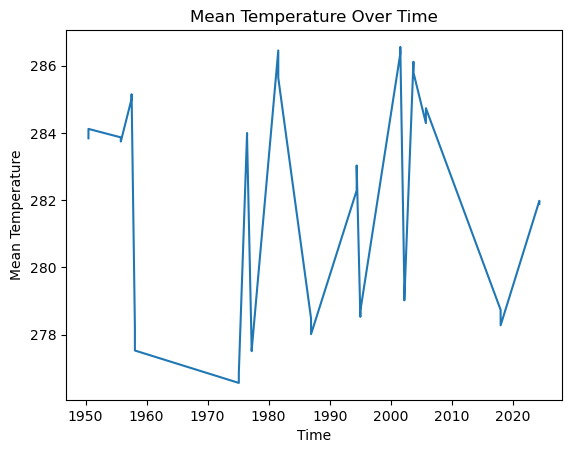

In [574]:
mean_temp = cold_event_temperatures_spatial.mean(dim=['event', 'lat', 'lon'])
plt.plot(mean_temp.time, mean_temp)
plt.xlabel('Time')
plt.ylabel('Mean Temperature')
plt.title('Mean Temperature Over Time')
plt.show()


# 17.1 Coldwave Spatial Plots

In [250]:
# Define the time periods using datetime64
start_period1 = np.datetime64('1950-01-01')
end_period1 = np.datetime64('1980-12-30')
start_period2 = np.datetime64('1990-01-01')
end_period2 = np.datetime64('2020-12-30')

# Extract the data for the two periods
data_period1 = cold_event_temperatures_spatial.sel(time=slice(start_period1, end_period1))
data_period2 = cold_event_temperatures_spatial.sel(time=slice(start_period2, end_period2))

In [252]:
# Define the time periods using datetime64
start_period1 = np.datetime64('1950-01-01')
end_period1 = np.datetime64('1970-12-30')
start_period2 = np.datetime64('2000-01-01')
end_period2 = np.datetime64('2020-12-30')

# Extract the data for the two periods
data_period1 = cold_event_temperatures_spatial.sel(time=slice(start_period1, end_period1))
data_period2 = cold_event_temperatures_spatial.sel(time=slice(start_period2, end_period2))

In [254]:
# Define the time periods using datetime64
start_period1950 = np.datetime64('1950-01-01')
end_period1999 = np.datetime64('1999-12-30')


# Extract the data for the two periods
data_period1950_1999 = cold_event_temperatures_spatial.sel(time=slice(start_period1950, end_period1999))

In [256]:
# Compute the mean temperature over the specified time period
mean_temperature = data_period1.mean(dim='time')
# Assuming mean_temperature has dimensions: (lat, lon)
if len(mean_temperature.shape) > 2:
    temperature = mean_temperature.squeeze()  # Remove any singleton dimensions
else:
    temperature = mean_temperature

# Compute the mean temperature over the specified time period
mean_temperature_2 = data_period2.mean(dim='time')
# Assuming mean_temperature has dimensions: (lat, lon)
if len(mean_temperature_2.shape) > 2:
    temperature = mean_temperature_2.squeeze()  # Remove any singleton dimensions
else:
    temperature = mean_temperature_2


In [258]:
# Compute the mean temperature over the specified time period
mean_temperature_1999 = data_period1950_1999.mean(dim='time')
# Assuming mean_temperature has dimensions: (lat, lon)
if len(mean_temperature_1999.shape) > 2:
    temperature = mean_temperature_1999.squeeze()  # Remove any singleton dimensions
else:
    temperature = mean_temperature_1999


In [260]:
mean_period1_C = mean_temperature - 273.15
mean_period2_C = mean_temperature_2 - 273.15

In [262]:
mean_period1999_C = mean_temperature_1999 - 273.15

In [264]:
# Compute the mean across the 'event' and 'quantile' dimensions
mean_temperature_2d = mean_period1_C.mean(dim=['event'])

# Compute the mean across the 'event' and 'quantile' dimensions
mean_temperature_2d_2 = mean_period2_C.mean(dim=['event'])


In [417]:
# Compute the mean across the 'event' and 'quantile' dimensions
mean_temperature_2d_1999 = mean_period1999_C.mean(dim=['event'])
temperature_1999 = mean_temperature_2d_1999.values

KeyboardInterrupt: 

In [266]:
# Calculate the difference between the two periods
temperature_difference_2d = mean_temperature_2d_2 - mean_temperature_2d

In [268]:
# Extract latitude, longitude, and mean temperature values
latitudes = mean_temperature.lat.values
longitudes = mean_temperature.lon.values
temperature = mean_temperature_2d.values

# Create a meshgrid for latitude and longitude
lon, lat = np.meshgrid(longitudes, latitudes)

# Extract latitude, longitude, and mean temperature values
latitudes = mean_temperature.lat.values
longitudes = mean_temperature.lon.values
temperature_2 = mean_temperature_2.values

# Create a meshgrid for latitude and longitude
lon, lat = np.meshgrid(longitudes, latitudes)

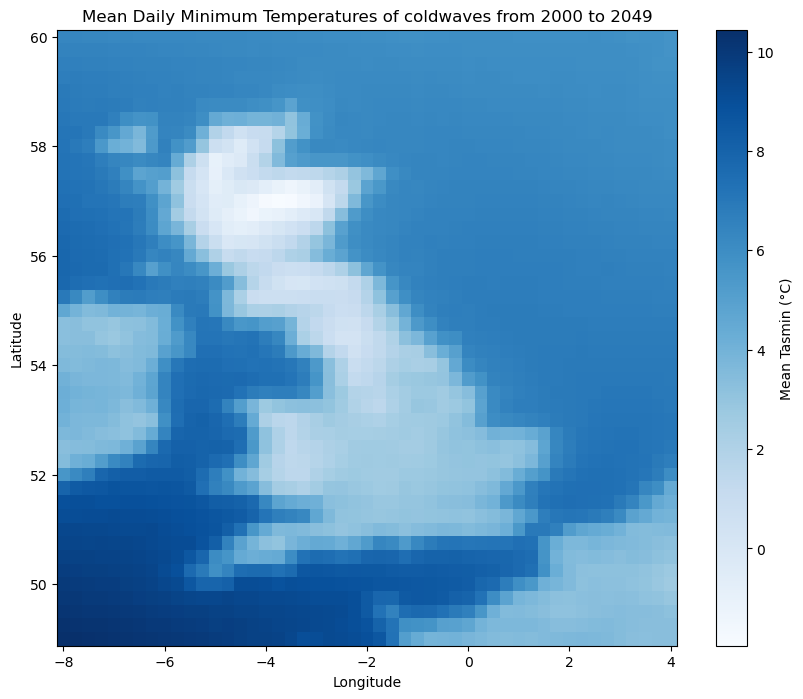

In [425]:
# Plot the data
fig, ax = plt.subplots(figsize=(10, 8))
c = ax.pcolormesh(lon, lat, temperature, cmap='Blues', shading='auto')

# Add a colorbar with label
cbar = plt.colorbar(c, ax=ax, orientation='vertical')
cbar.set_label('Mean Tasmin (°C)')

# Add title and labels
plt.title('Mean Daily Minimum Temperatures of coldwaves from 2000 to 2049')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Show the plot
plt.show()

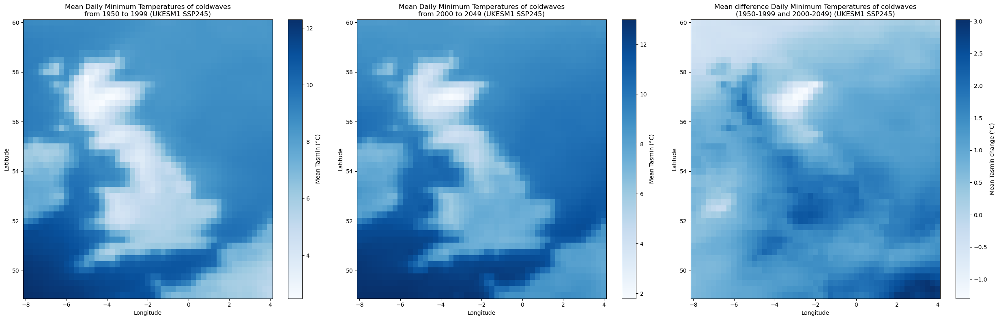

In [775]:
# Create a figure with 3 subplots (1 row, 3 columns)
fig, axes = plt.subplots(1, 3, figsize=(25, 8))

# First subplot: Mean Daily Minimum Temperatures of coldwaves from 2000 to 2049
c1 = axes[0].pcolormesh(lon, lat, mean_temperature_2d, cmap='Blues')
cbar1 = plt.colorbar(c1, ax=axes[0], orientation='vertical')
cbar1.set_label('Mean Tasmin (°C)')
axes[0].set_title('Mean Daily Minimum Temperatures of coldwaves\nfrom 1950 to 1999 (UKESM1 SSP245)')
axes[0].set_xlabel('Longitude')
axes[0].set_ylabel('Latitude')

# Second subplot: Mean Daily Minimum Temperatures of coldwaves from 2050 to 2099
c2 = axes[1].pcolormesh(lon, lat, mean_temperature_2d_2, cmap='Blues')
cbar2 = plt.colorbar(c2, ax=axes[1], orientation='vertical')
cbar2.set_label('Mean Tasmin (°C)')
axes[1].set_title('Mean Daily Minimum Temperatures of coldwaves\nfrom 2000 to 2049 (UKESM1 SSP245)')
axes[1].set_xlabel('Longitude')
axes[1].set_ylabel('Latitude')

# Third subplot: Mean difference Daily Minimum Temperatures of coldwaves (2000-2049 and 2050-2099)
c3 = axes[2].pcolormesh(lon, lat, temperature_difference_2d, cmap='Blues')
cbar3 = plt.colorbar(c3, ax=axes[2], orientation='vertical')
cbar3.set_label('Mean Tasmin change (°C)')
axes[2].set_title('Mean difference Daily Minimum Temperatures of coldwaves\n(1950-1999 and 2000-2049) (UKESM1 SSP245)')
axes[2].set_xlabel('Longitude')
axes[2].set_ylabel('Latitude')

# Adjust layout to prevent overlap
plt.tight_layout()

# Save the plot before showing it
#plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/UKESM1 SSP585/coldwave_mean_tasmin_maps_1950_2000.png', dpi=300)

# Show the combined figure
plt.show()

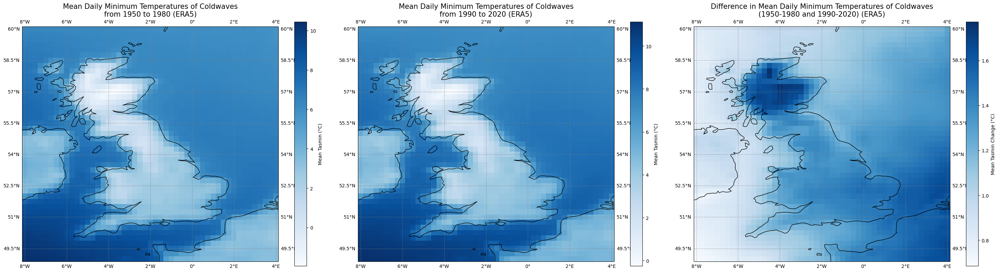

In [276]:
import cartopy.crs as ccrs

# Create a figure with 3 subplots (1 row, 3 columns)
fig, axes = plt.subplots(1, 3, figsize=(30, 8), subplot_kw={'projection': ccrs.PlateCarree()})

# Common settings for all subplots
for ax in axes:
    ax.coastlines(resolution='50m')
    ax.gridlines(draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='--')
    

# First subplot: Mean Daily Minimum Temperatures of coldwaves from 1950 to 1999
c1 = axes[0].pcolormesh(lon, lat, mean_temperature_2d, cmap='Blues', transform=ccrs.PlateCarree())
cbar1 = plt.colorbar(c1, ax=axes[0], orientation='vertical')
cbar1.set_label('Mean Tasmin (°C)')
axes[0].set_title('Mean Daily Minimum Temperatures of Coldwaves\nfrom 1950 to 1980 (ERA5)', fontsize=15)
axes[0].set_xlabel('Longitude')
axes[0].set_ylabel('Latitude')

# Second subplot: Mean Daily Minimum Temperatures of coldwaves from 2000 to 2049
c2 = axes[1].pcolormesh(lon, lat, mean_temperature_2d_2, cmap='Blues', transform=ccrs.PlateCarree())
cbar2 = plt.colorbar(c2, ax=axes[1], orientation='vertical')
cbar2.set_label('Mean Tasmin (°C)')
axes[1].set_title('Mean Daily Minimum Temperatures of Coldwaves\nfrom 1990 to 2020 (ERA5)', fontsize=15)
axes[1].set_xlabel('Longitude')
axes[1].set_ylabel('Latitude')

# Third subplot: Mean difference Daily Minimum Temperatures of coldwaves (1950-1999 and 2000-2049)
c3 = axes[2].pcolormesh(lon, lat, temperature_difference_2d, cmap='Blues', transform=ccrs.PlateCarree())
cbar3 = plt.colorbar(c3, ax=axes[2], orientation='vertical')
cbar3.set_label('Mean Tasmin Change (°C)')
axes[2].set_title('Difference in Mean Daily Minimum Temperatures of Coldwaves\n(1950-1980 and 1990-2020) (ERA5)', fontsize=15)
axes[2].set_xlabel('Longitude')
axes[2].set_ylabel('Latitude')

# Adjust layout to prevent overlap
plt.tight_layout(rect=[0, 0, 1, 0.95])

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_mean_tasmin_maps_1950_1990_blues.png', dpi=300)

# Show the combined figure
plt.show()

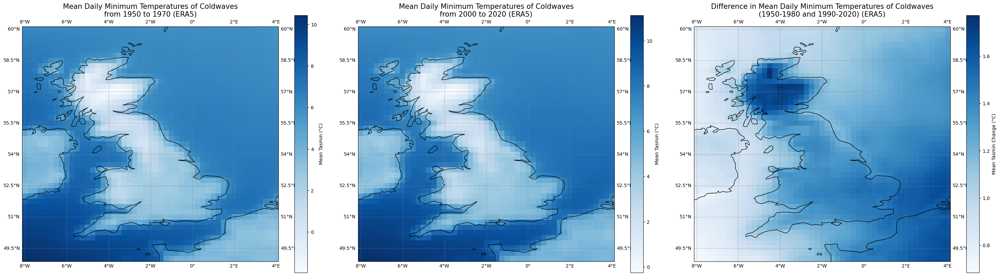

In [429]:
# Create a figure with 3 subplots (1 row, 3 columns)
fig, axes = plt.subplots(1, 3, figsize=(30, 8), subplot_kw={'projection': ccrs.PlateCarree()})

# Common settings for all subplots
for ax in axes:
    ax.coastlines(resolution='50m')
    ax.gridlines(draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='--')
    

# First subplot: Mean Daily Minimum Temperatures of coldwaves from 1950 to 1999
c1 = axes[0].pcolormesh(lon, lat, mean_temperature_2d, cmap='Blues', transform=ccrs.PlateCarree())
cbar1 = plt.colorbar(c1, ax=axes[0], orientation='vertical')
cbar1.set_label('Mean Tasmin (°C)')
axes[0].set_title('Mean Daily Minimum Temperatures of Coldwaves\nfrom 1950 to 1970 (ERA5)', fontsize=15)
axes[0].set_xlabel('Longitude')
axes[0].set_ylabel('Latitude')

# Second subplot: Mean Daily Minimum Temperatures of coldwaves from 2000 to 2049
c2 = axes[1].pcolormesh(lon, lat, mean_temperature_2d_2, cmap='Blues', transform=ccrs.PlateCarree())
cbar2 = plt.colorbar(c2, ax=axes[1], orientation='vertical')
cbar2.set_label('Mean Tasmin (°C)')
axes[1].set_title('Mean Daily Minimum Temperatures of Coldwaves\nfrom 2000 to 2020 (ERA5)', fontsize=15)
axes[1].set_xlabel('Longitude')
axes[1].set_ylabel('Latitude')

# Third subplot: Mean difference Daily Minimum Temperatures of coldwaves (1950-1999 and 2000-2049)
c3 = axes[2].pcolormesh(lon, lat, temperature_difference_2d, cmap='Blues', transform=ccrs.PlateCarree())
cbar3 = plt.colorbar(c3, ax=axes[2], orientation='vertical')
cbar3.set_label('Mean Tasmin Change (°C)')
axes[2].set_title('Difference in Mean Daily Minimum Temperatures of Coldwaves\n(1950-1980 and 1990-2020) (ERA5)', fontsize=15)
axes[2].set_xlabel('Longitude')
axes[2].set_ylabel('Latitude')

# Adjust layout to prevent overlap
plt.tight_layout()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_mean_tasmin_maps_1950_2000_blues.png', dpi=300)

# Show the combined figure
plt.show()

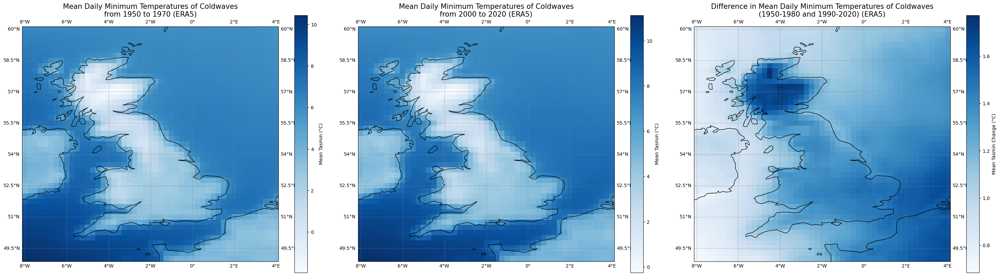

In [433]:
# Create a figure with 3 subplots (1 row, 3 columns)
fig, axes = plt.subplots(1, 3, figsize=(30, 8), subplot_kw={'projection': ccrs.PlateCarree()})

# Common settings for all subplots
for ax in axes:
    ax.coastlines(resolution='50m')
    ax.gridlines(draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='--')
    

# First subplot: Mean Daily Minimum Temperatures of coldwaves from 1950 to 1999
c1 = axes[0].pcolormesh(lon, lat, mean_temperature_2d, cmap='Blues', transform=ccrs.PlateCarree())
cbar1 = plt.colorbar(c1, ax=axes[0], orientation='vertical')
cbar1.set_label('Mean Tasmin (°C)')
axes[0].set_title('Mean Daily Minimum Temperatures of Coldwaves\nfrom 1950 to 1970 (ERA5)', fontsize=15)
axes[0].set_xlabel('Longitude')
axes[0].set_ylabel('Latitude')

# Second subplot: Mean Daily Minimum Temperatures of coldwaves from 2000 to 2049
c2 = axes[1].pcolormesh(lon, lat, mean_temperature_2d_2, cmap='Blues', transform=ccrs.PlateCarree())
cbar2 = plt.colorbar(c2, ax=axes[1], orientation='vertical')
cbar2.set_label('Mean Tasmin (°C)')
axes[1].set_title('Mean Daily Minimum Temperatures of Coldwaves\nfrom 2000 to 2020 (ERA5)', fontsize=15)
axes[1].set_xlabel('Longitude')
axes[1].set_ylabel('Latitude')

# Third subplot: Mean difference Daily Minimum Temperatures of coldwaves (1950-1999 and 2000-2049)
c3 = axes[2].pcolormesh(lon, lat, temperature_difference_2d, cmap='Blues', transform=ccrs.PlateCarree())
cbar3 = plt.colorbar(c3, ax=axes[2], orientation='vertical')
cbar3.set_label('Mean Tasmin Change (°C)')
axes[2].set_title('Difference in Mean Daily Minimum Temperatures of Coldwaves\n(1950-1980 and 1990-2020) (ERA5)', fontsize=15)
axes[2].set_xlabel('Longitude')
axes[2].set_ylabel('Latitude')

# Adjust layout to prevent overlap
plt.tight_layout()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_mean_tasmin_maps_1950_2000_blues.png', dpi=300)

# Show the combined figure
plt.show()

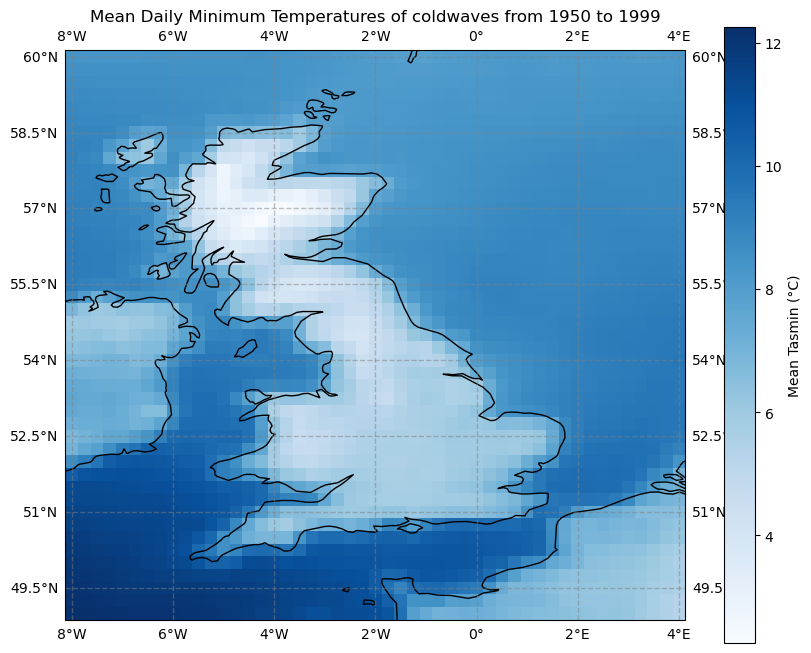

In [805]:
# Plot the data
fig, ax = plt.subplots(figsize=(10, 8), subplot_kw={'projection': ccrs.PlateCarree()})

c = ax.pcolormesh(lon, lat, temperature_1999, cmap='Blues')

ax.coastlines(resolution='50m')
ax.gridlines(draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='--')

# Add a colorbar with label
cbar = plt.colorbar(c, ax=ax, orientation='vertical')
cbar.set_label('Mean Tasmin (°C)')

# Add title and labels
plt.title('Mean Daily Minimum Temperatures of coldwaves from 1950 to 1999')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_mean_tasmin_map_1950_1999.png', dpi=300)

# Show the plot
plt.show()

In [431]:
# Calculate the common vmin and vmax for the colorbars
vmin_temp = min(np.min(mean_temperature_2d_3_interp), np.min(mean_temperature_2d_interp), np.min(mean_temperature_2d_2_interp))
vmax_temp = max(np.max(mean_temperature_2d_3_interp), np.max(mean_temperature_2d_interp), np.max(mean_temperature_2d_2_interp))

vmin_diff = min(np.min(temperature_difference_2d), np.min(temperature_difference_2d))
vmax_diff = max(np.max(temperature_difference_2d), np.max(temperature_difference_2d))

# Create a figure with 2 rows and 3 columns
fig, axes = plt.subplots(2, 3, figsize=(30, 16), subplot_kw={'projection': ccrs.PlateCarree()})

# Common settings for all subplots
for ax in axes.flatten():
    ax.coastlines(resolution='50m')
    ax.gridlines(draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='--')
    

# First row of plots
# First subplot: Mean Daily Minimum Temperatures of coldwaves from 1950 to 1999
c1 = axes[0, 0].pcolormesh(lon, lat, mean_temperature_2d_3_interp, cmap='Blues', vmin=vmin_temp, vmax=vmax_temp, transform=ccrs.PlateCarree())
cbar1 = plt.colorbar(c1, ax=axes[0, 0], orientation='vertical')
cbar1.set_label('Mean Tasmin (°C)')
axes[0, 0].set_title('Mean Daily Minimum Temperatures of Coldwaves\nfrom 1950 to 1999 (ERA5)')
axes[0, 0].set_xlabel('Longitude')
axes[0, 0].set_ylabel('Latitude')

# Second subplot: Mean Daily Minimum Temperatures of coldwaves from 2000 to 2049
c2 = axes[0, 1].pcolormesh(lon, lat, mean_temperature_2d_interp, cmap='Blues', vmin=vmin_temp, vmax=vmax_temp, transform=ccrs.PlateCarree())
cbar2 = plt.colorbar(c2, ax=axes[0, 1], orientation='vertical')
cbar2.set_label('Mean Tasmin (°C)')
axes[0, 1].set_title('Mean Daily Minimum Temperatures of Coldwaves\nfrom 2000 to 2049 (ERA5)')
axes[0, 1].set_xlabel('Longitude')
axes[0, 1].set_ylabel('Latitude')

# Third subplot: Mean difference Daily Minimum Temperatures of coldwaves (1950-1999 and 2000-2049)
c3 = axes[0, 2].pcolormesh(lon, lat, temperature_difference_2d_2_interp, cmap='Blues', vmin=vmin_diff, vmax=vmax_diff, transform=ccrs.PlateCarree())
cbar3 = plt.colorbar(c3, ax=axes[0, 2], orientation='vertical')
cbar3.set_label('Mean Tasmin Change (°C)')
axes[0, 2].set_title('Mean Difference in Daily Minimum Temperatures of Coldwaves\n(1950-1999 and 2000-2049) (ERA5)')
axes[0, 2].set_xlabel('Longitude')
axes[0, 2].set_ylabel('Latitude')

# Second row of plots
# First subplot: Mean Daily Minimum Temperatures of coldwaves from 2000 to 2049
c4 = axes[1, 0].pcolormesh(lon, lat, mean_temperature_2d, cmap='Blues', vmin=vmin_temp, vmax=vmax_temp, transform=ccrs.PlateCarree())
cbar4 = plt.colorbar(c4, ax=axes[1, 0], orientation='vertical')
cbar4.set_label('Mean Tasmin (°C)')
axes[1, 0].set_title('Mean Daily Minimum Temperatures of Coldwaves\nfrom 1950-1980 (ERA5)')
axes[1, 0].set_xlabel('Longitude')
axes[1, 0].set_ylabel('Latitude')

# Second subplot: Mean Daily Minimum Temperatures of coldwaves from 2050 to 2099
c5 = axes[1, 1].pcolormesh(lon, lat, mean_temperature_2d_2, cmap='Blues', vmin=vmin_temp, vmax=vmax_temp, transform=ccrs.PlateCarree())
cbar5 = plt.colorbar(c5, ax=axes[1, 1], orientation='vertical')
cbar5.set_label('Mean Tasmin (°C)')
axes[1, 1].set_title('Mean Daily Minimum Temperatures of Coldwaves\nfrom 1999-2020 (ERA5)')
axes[1, 1].set_xlabel('Longitude')
axes[1, 1].set_ylabel('Latitude')

# Third subplot: Mean difference Daily Minimum Temperatures of coldwaves (2000-2049 and 2050-2099)
c6 = axes[1, 2].pcolormesh(lon, lat, temperature_difference_2d, cmap='Blues', vmin=vmin_diff, vmax=vmax_diff, transform=ccrs.PlateCarree())
cbar6 = plt.colorbar(c6, ax=axes[1, 2], orientation='vertical')
cbar6.set_label('Mean Tasmin Change (°C)')
axes[1, 2].set_title('Mean Difference in Daily Minimum Temperatures of Coldwaves\n(1950-1980 and 1999-2020) (ERA5)')
axes[1, 2].set_xlabel('Longitude')
axes[1, 2].set_ylabel('Latitude')

# Adjust layout to prevent overlap
plt.tight_layout()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/combined_coldwave_mean_tasmin_maps(standard_colourbar).png', dpi=300)

# Show the combined figure
plt.show()


NameError: name 'mean_temperature_2d_3_interp' is not defined

In [270]:
# Calculate the common vmin and vmax for the colorbars
vmin_temp = min(np.min(mean_temperature_2d_3), np.min(mean_temperature_2d), np.min(mean_temperature_2d_2))
vmax_temp = max(np.max(mean_temperature_2d_3), np.max(mean_temperature_2d), np.max(mean_temperature_2d_2))

vmin_diff = min(np.min(temperature_difference_2d), np.min(temperature_difference_2d))
vmax_diff = max(np.max(temperature_difference_2d), np.max(temperature_difference_2d))

# Create a figure with 2 rows and 3 columns
fig, axes = plt.subplots(2, 3, figsize=(30, 16), subplot_kw={'projection': ccrs.PlateCarree()})

# Common settings for all subplots
for ax in axes.flatten():
    ax.coastlines(resolution='50m')
    ax.gridlines(draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='--')
    

# First row of plots
# First subplot: Mean Daily Minimum Temperatures of coldwaves from 1950 to 1999
c1 = axes[0, 0].pcolormesh(lon, lat, mean_temperature_2d_3, cmap='Blues', vmin=vmin_temp, vmax=vmax_temp, transform=ccrs.PlateCarree())
cbar1 = plt.colorbar(c1, ax=axes[0, 0], orientation='vertical')
cbar1.set_label('Mean Tasmin (°C)')
axes[0, 0].set_title('Mean Daily Minimum Temperatures of Coldwaves\nfrom 1950 to 1999 (ERA5)')
axes[0, 0].set_xlabel('Longitude')
axes[0, 0].set_ylabel('Latitude')

# Second subplot: Mean Daily Minimum Temperatures of coldwaves from 2000 to 2049
c2 = axes[0, 1].pcolormesh(lon, lat, mean_temperature_2d, cmap='Blues', vmin=vmin_temp, vmax=vmax_temp, transform=ccrs.PlateCarree())
cbar2 = plt.colorbar(c2, ax=axes[0, 1], orientation='vertical')
cbar2.set_label('Mean Tasmin (°C)')
axes[0, 1].set_title('Mean Daily Minimum Temperatures of Coldwaves\nfrom 2000 to 2049 (ERA5)')
axes[0, 1].set_xlabel('Longitude')
axes[0, 1].set_ylabel('Latitude')

# Third subplot: Mean difference Daily Minimum Temperatures of coldwaves (1950-1999 and 2000-2049)
c3 = axes[0, 2].pcolormesh(lon, lat, temperature_difference_2d_2, cmap='Blues', vmin=vmin_diff, vmax=vmax_diff, transform=ccrs.PlateCarree())
cbar3 = plt.colorbar(c3, ax=axes[0, 2], orientation='vertical')
cbar3.set_label('Mean Tasmin Change (°C)')
axes[0, 2].set_title('Mean Difference in Daily Minimum Temperatures of Coldwaves\n(1950-1999 and 2000-2049) (ERA5)')
axes[0, 2].set_xlabel('Longitude')
axes[0, 2].set_ylabel('Latitude')

# Second row of plots
# First subplot: Mean Daily Minimum Temperatures of coldwaves from 2000 to 2049
c4 = axes[1, 0].pcolormesh(lon, lat, mean_temperature_2d, cmap='Blues', vmin=vmin_temp, vmax=vmax_temp, transform=ccrs.PlateCarree())
cbar4 = plt.colorbar(c4, ax=axes[1, 0], orientation='vertical')
cbar4.set_label('Mean Tasmin (°C)')
axes[1, 0].set_title('Mean Daily Minimum Temperatures of Coldwaves\nfrom 1950-1980 (ERA5)')
axes[1, 0].set_xlabel('Longitude')
axes[1, 0].set_ylabel('Latitude')

# Second subplot: Mean Daily Minimum Temperatures of coldwaves from 2050 to 2099
c5 = axes[1, 1].pcolormesh(lon, lat, mean_temperature_2d_2, cmap='Blues', vmin=vmin_temp, vmax=vmax_temp, transform=ccrs.PlateCarree())
cbar5 = plt.colorbar(c5, ax=axes[1, 1], orientation='vertical')
cbar5.set_label('Mean Tasmin (°C)')
axes[1, 1].set_title('Mean Daily Minimum Temperatures of Coldwaves\nfrom 1999-2020 (ERA5)')
axes[1, 1].set_xlabel('Longitude')
axes[1, 1].set_ylabel('Latitude')

# Third subplot: Mean difference Daily Minimum Temperatures of coldwaves (2000-2049 and 2050-2099)
c6 = axes[1, 2].pcolormesh(lon, lat, temperature_difference_2d, cmap='Blues', vmin=vmin_diff, vmax=vmax_diff, transform=ccrs.PlateCarree())
cbar6 = plt.colorbar(c6, ax=axes[1, 2], orientation='vertical')
cbar6.set_label('Mean Tasmin Change (°C)')
axes[1, 2].set_title('Mean Difference in Daily Minimum Temperatures of Coldwaves\n(1950-1980 and 1999-2020) (ERA5)')
axes[1, 2].set_xlabel('Longitude')
axes[1, 2].set_ylabel('Latitude')

# Adjust layout to prevent overlap
plt.tight_layout()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/(updated)_combined_coldwave_mean_tasmin_maps(standard_colourbar).png', dpi=300)

# Show the combined figure
plt.show()


NameError: name 'mean_temperature_2d_3' is not defined

# 18. Damage Function (proof of concept)


In [1012]:
#base damage function

In [92]:
# Define the calculate_damage function
def calculate_damage(dataset, 
                     temp_metric='tasmin', 
                     duration_metric='length', 
                     severity_metric='severity', 
                     extremes_metric='min_temps',
                     temp_weight=0.4, 
                     dur_weight=0.3, 
                     sev_weight=0.2, 
                     ext_weight=0.1):
    """
    Calculate the potential damage from coldwaves based on given metrics in an xarray dataset.

    Parameters:
    dataset (xarray.Dataset): Dataset containing coldwave metrics.
    temp_metric (str): Name of the temperature metric in the dataset.
    duration_metric (str): Name of the duration metric in the dataset.
    severity_metric (str): Name of the severity metric in the dataset.
    extremes_metric (str): Name of the extremes metric in the dataset.
    temp_weight (float): Weight for the temperature metric.
    dur_weight (float): Weight for the duration metric.
    sev_weight (float): Weight for the severity metric.
    ext_weight (float): Weight for the extremes metric.

    Returns:
    xarray.DataArray: Potential damage score.
    """
    
    # Extract metrics from dataset
    temperature = dataset[temp_metric]
    duration = dataset[duration_metric]
    severity = dataset[severity_metric]
    extremes = dataset[extremes_metric]
    
    # Normalize the metrics
    # Reverse normalization for temperature: colder temperatures (lower values) should get higher scores
    temp_normalized = (temperature.max() - temperature) / (temperature.max() - temperature.min())
    dur_normalized = (duration - duration.min()) / (duration.max() - duration.min())
    sev_normalized = (severity - severity.min()) / (severity.max() - severity.min())
    
    # Reverse normalization for extremes: higher extremes (lower values) should get higher scores
    ext_normalized = (extremes.max() - extremes) / (extremes.max() - extremes.min())
    
    # Calculate the damage score
    damage_score = (temp_weight * temp_normalized + 
                    dur_weight * dur_normalized +
                    sev_weight * sev_normalized + 
                    ext_weight * ext_normalized)
    
    return damage_score

In [94]:
#damage fucntion for Infrastructure - Higher weight for severity and extremes: 
#Increase the weight for temperature extremes: Extreme temperatures can have significant impacts on infrastructure, such as causing pipes to burst or damaging building materials.
#Adjust the weight for duration and severity: Duration is still important, but perhaps not as critical as temperature extremes for infrastructure. Severity might also be significant but can be adjusted based on its impact on infrastructure.

In [96]:
# Define the calculate_damage function
def calculate_damage_infrastructure(dataset, 
                     temp_metric='tasmin', 
                     duration_metric='length', 
                     severity_metric='severity', 
                     extremes_metric='min_temps',
                     temp_weight=0.2, 
                     dur_weight=0.2, 
                     sev_weight=0.3, 
                     ext_weight=0.3):
    """
    Calculate the potential damage from coldwaves based on given metrics in an xarray dataset.

    Parameters:
    dataset (xarray.Dataset): Dataset containing coldwave metrics.
    temp_metric (str): Name of the temperature metric in the dataset.
    duration_metric (str): Name of the duration metric in the dataset.
    severity_metric (str): Name of the severity metric in the dataset.
    extremes_metric (str): Name of the extremes metric in the dataset.
    temp_weight (float): Weight for the temperature metric.
    dur_weight (float): Weight for the duration metric.
    sev_weight (float): Weight for the severity metric.
    ext_weight (float): Weight for the extremes metric.

    Returns:
    xarray.DataArray: Potential damage score.
    """
    
    # Extract metrics from dataset
    temperature = dataset[temp_metric]
    duration = dataset[duration_metric]
    severity = dataset[severity_metric]
    extremes = dataset[extremes_metric]
    
    # Normalize the metrics
    # Reverse normalization for temperature: colder temperatures (lower values) should get higher scores
    temp_normalized = (temperature.max() - temperature) / (temperature.max() - temperature.min())
    dur_normalized = (duration - duration.min()) / (duration.max() - duration.min())
    sev_normalized = (severity - severity.min()) / (severity.max() - severity.min())
    
    # Reverse normalization for extremes: higher extremes (lower values) should get higher scores
    ext_normalized = (extremes.max() - extremes) / (extremes.max() - extremes.min())
    
    # Calculate the damage score
    damage_score = (temp_weight * temp_normalized + 
                    dur_weight * dur_normalized +
                    sev_weight * sev_normalized + 
                    ext_weight * ext_normalized)
    
    return damage_score

In [98]:
#Damage Function for energy systems - higher weight for extremes and duration 
#Increase the weight for temperature extremes: Extreme temperatures can impact energy systems by affecting energy demand and causing strain on infrastructure. For example, very cold temperatures can lead to increased heating demand and potential failures in energy infrastructure.
#Increase the weight for duration: Prolonged cold spells can also strain energy systems as they result in sustained high demand and potential long-term impacts on infrastructure.
#Adjust the weight for severity and temperature: While severity is still important, temperature extremes and duration might have a more direct impact on energy systems.

In [100]:
# Define the calculate_damage function
def calculate_damage_energy_systems(dataset, 
                     temp_metric='tasmin', 
                     duration_metric='length', 
                     severity_metric='severity', 
                     extremes_metric='min_temps',
                     temp_weight=0.2, 
                     dur_weight=0.3, 
                     sev_weight=0.1, 
                     ext_weight=0.4):
    """
    Calculate the potential damage from coldwaves based on given metrics in an xarray dataset.

    Parameters:
    dataset (xarray.Dataset): Dataset containing coldwave metrics.
    temp_metric (str): Name of the temperature metric in the dataset.
    duration_metric (str): Name of the duration metric in the dataset.
    severity_metric (str): Name of the severity metric in the dataset.
    extremes_metric (str): Name of the extremes metric in the dataset.
    temp_weight (float): Weight for the temperature metric.
    dur_weight (float): Weight for the duration metric.
    sev_weight (float): Weight for the severity metric.
    ext_weight (float): Weight for the extremes metric.

    Returns:
    xarray.DataArray: Potential damage score.
    """
    
    # Extract metrics from dataset
    temperature = dataset[temp_metric]
    duration = dataset[duration_metric]
    severity = dataset[severity_metric]
    extremes = dataset[extremes_metric]
    
    # Normalize the metrics
    # Reverse normalization for temperature: colder temperatures (lower values) should get higher scores
    temp_normalized = (temperature.max() - temperature) / (temperature.max() - temperature.min())
    dur_normalized = (duration - duration.min()) / (duration.max() - duration.min())
    sev_normalized = (severity - severity.min()) / (severity.max() - severity.min())
    
    # Reverse normalization for extremes: higher extremes (lower values) should get higher scores
    ext_normalized = (extremes.max() - extremes) / (extremes.max() - extremes.min())
    
    # Calculate the damage score
    damage_score = (temp_weight * temp_normalized + 
                    dur_weight * dur_normalized +
                    sev_weight * sev_normalized + 
                    ext_weight * ext_normalized)
    
    return damage_score

In [102]:
#Damage Function Human Health - Higher wieght for duration as prolonged exposure to cold conditions generally poses a higher risk to human health

In [104]:
# Define the calculate_damage function
def calculate_damage_health(dataset, 
                     temp_metric='tasmin', 
                     duration_metric='length', 
                     severity_metric='severity', 
                     extremes_metric='min_temps',
                     temp_weight=0.2, 
                     dur_weight=0.4, 
                     sev_weight=0.2, 
                     ext_weight=0.2):
    """
    Calculate the potential damage from coldwaves based on given metrics in an xarray dataset.

    Parameters:
    dataset (xarray.Dataset): Dataset containing coldwave metrics.
    temp_metric (str): Name of the temperature metric in the dataset.
    duration_metric (str): Name of the duration metric in the dataset.
    severity_metric (str): Name of the severity metric in the dataset.
    extremes_metric (str): Name of the extremes metric in the dataset.
    temp_weight (float): Weight for the temperature metric.
    dur_weight (float): Weight for the duration metric.
    sev_weight (float): Weight for the severity metric.
    ext_weight (float): Weight for the extremes metric.

    Returns:
    xarray.DataArray: Potential damage score.
    """
    
    # Extract metrics from dataset
    temperature = dataset[temp_metric]
    duration = dataset[duration_metric]
    severity = dataset[severity_metric]
    extremes = dataset[extremes_metric]
    
    # Normalize the metrics
    # Reverse normalization for temperature: colder temperatures (lower values) should get higher scores
    temp_normalized = (temperature.max() - temperature) / (temperature.max() - temperature.min())
    dur_normalized = (duration - duration.min()) / (duration.max() - duration.min())
    sev_normalized = (severity - severity.min()) / (severity.max() - severity.min())
    
    # Reverse normalization for extremes: higher extremes (lower values) should get higher scores
    ext_normalized = (extremes.max() - extremes) / (extremes.max() - extremes.min())
    
    # Calculate the damage score
    damage_score = (temp_weight * temp_normalized + 
                    dur_weight * dur_normalized + 
                    sev_weight * sev_normalized + 
                    ext_weight * ext_normalized)
    
    return damage_score

In [106]:
# Compute the damage score
damage_score = calculate_damage(coldwave_dataset)
damage_score_infrastructure = calculate_damage_infrastructure(coldwave_dataset)
damage_score_energy_systems = calculate_damage_energy_systems(coldwave_dataset)
damage_score_health = calculate_damage_health(coldwave_dataset)

#print(damage_score)

In [107]:
# Convert xarray DataArray to pandas DataFrame for easy plotting
damage_df = damage_score.to_dataframe(name='Damage Score').reset_index()
damage_df_infrastructure = damage_score_infrastructure.to_dataframe(name='Damage Score').reset_index()
damage_df_energy_systems = damage_score_energy_systems.to_dataframe(name='Damage Score').reset_index()
damage_df_health = damage_score_health.to_dataframe(name='Damage Score').reset_index()

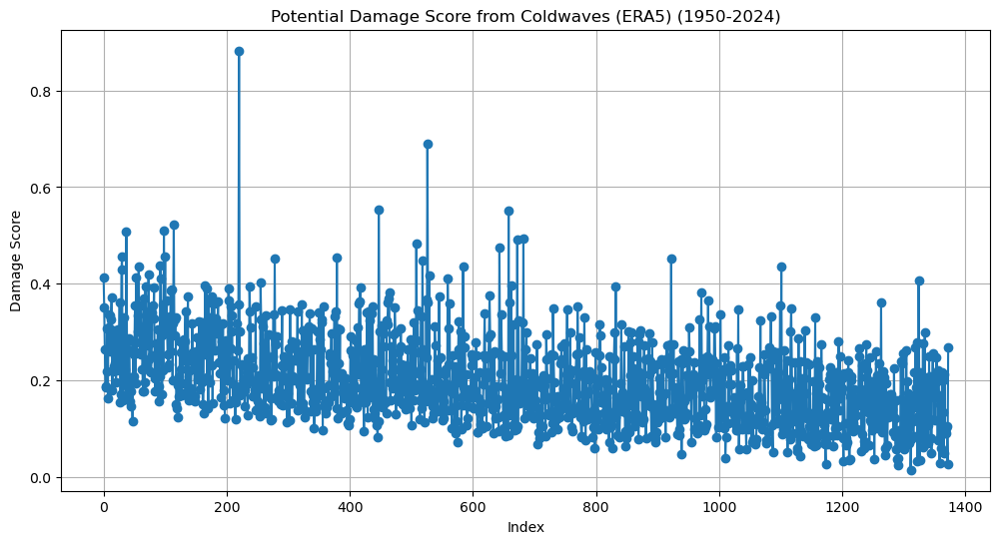

In [108]:
# Plotting
plt.figure(figsize=(12, 6))
plt.plot(damage_df['index'], damage_df['Damage Score'], marker='o', linestyle='-')
plt.title('Potential Damage Score from Coldwaves (ERA5) (1950-2024)')
plt.xlabel('Index')
plt.ylabel('Damage Score')
plt.grid(True)
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


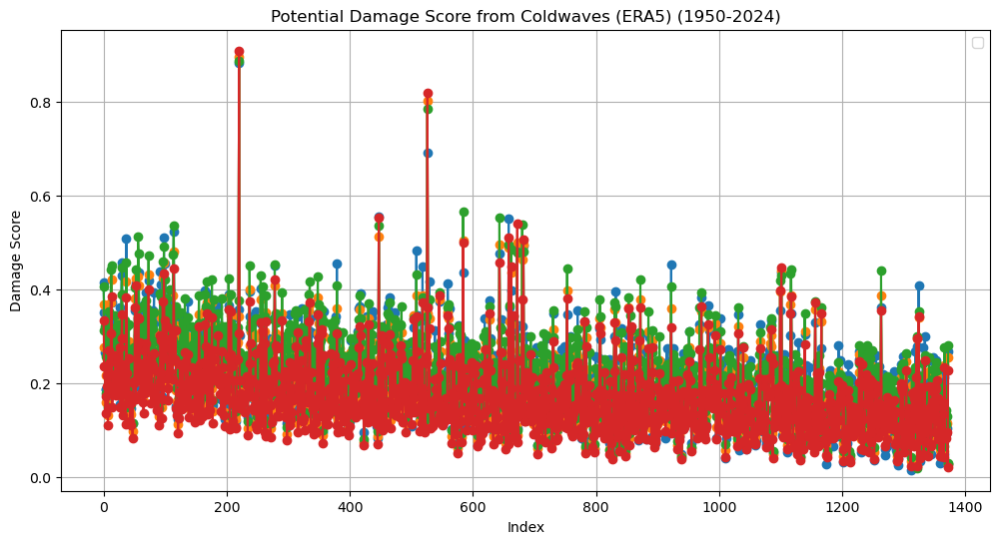

In [112]:
# Plotting
plt.figure(figsize=(12, 6))
plt.plot(damage_df['index'], damage_df['Damage Score'], marker='o', linestyle='-')
plt.plot(damage_df_infrastructure['index'], damage_df_infrastructure['Damage Score'], marker='o', linestyle='-')
plt.plot(damage_df_energy_systems['index'], damage_df_energy_systems['Damage Score'], marker='o', linestyle='-')
plt.plot(damage_df_health['index'], damage_df_health['Damage Score'], marker='o', linestyle='-')
plt.title('Potential Damage Score from Coldwaves (ERA5) (1950-2024)')
plt.xlabel('Index')
plt.ylabel('Damage Score')
plt.grid(True)
plt.legend()


plt.show()

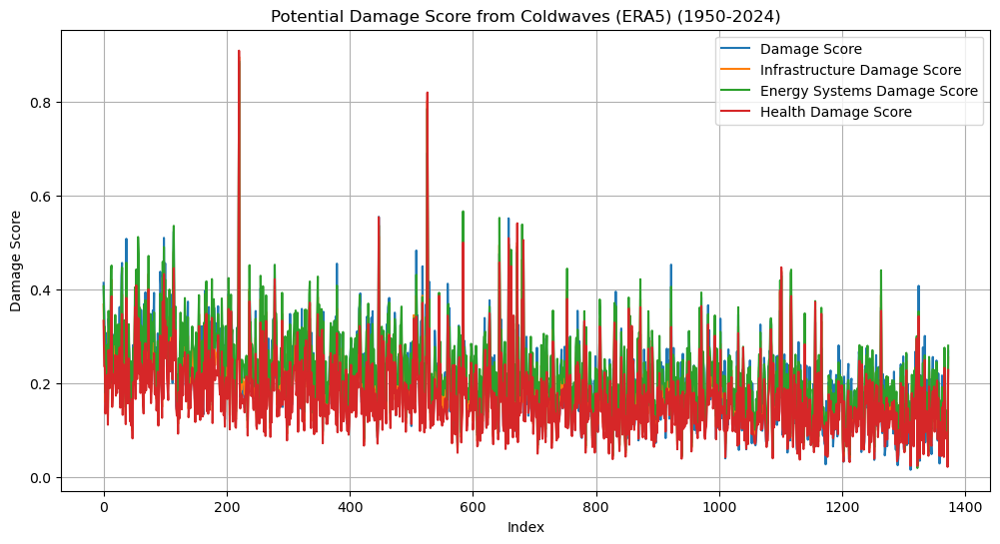

In [457]:
# Plotting
plt.figure(figsize=(12, 6))
plt.plot(damage_df['index'], damage_df['Damage Score'], linestyle='-', label='Damage Score')
plt.plot(damage_df_infrastructure['index'], damage_df_infrastructure['Damage Score'], linestyle='-', label='Infrastructure Damage Score')
plt.plot(damage_df_energy_systems['index'], damage_df_energy_systems['Damage Score'], linestyle='-', label='Energy Systems Damage Score')
plt.plot(damage_df_health['index'], damage_df_health['Damage Score'], linestyle='-', label='Health Damage Score')
plt.title('Potential Damage Score from Coldwaves (ERA5) (1950-2024)')
plt.xlabel('Index')
plt.ylabel('Damage Score')
plt.grid(True)
plt.legend()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_damage_potential_clear.png', dpi=300)

plt.show()

In [35]:
damage_df['start_date'] = coldwave_dataset['start_date'].values
damage_df_infrastructure['start_date'] = coldwave_dataset['start_date'].values
damage_df_energy_systems['start_date'] = coldwave_dataset['start_date'].values
damage_df_health['start_date'] = coldwave_dataset['start_date'].values

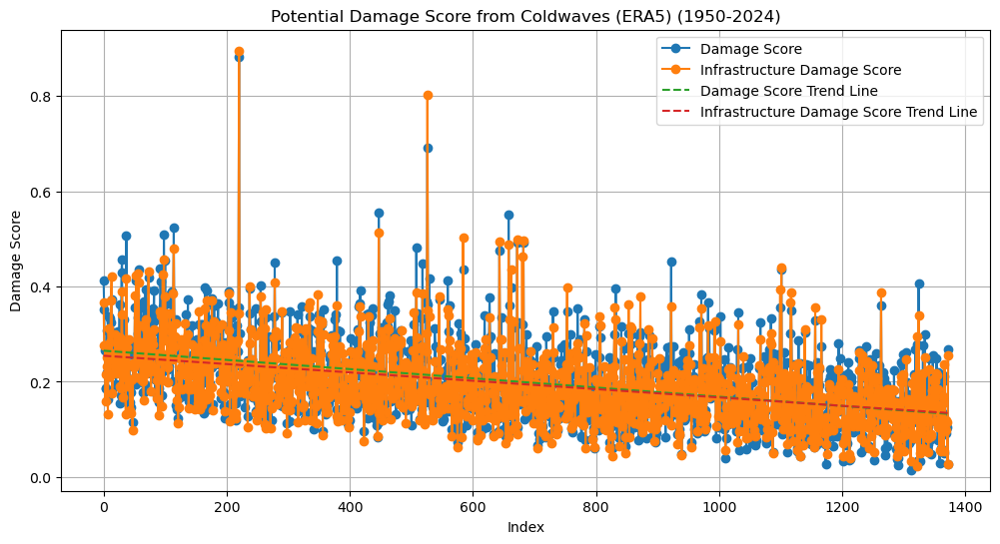

In [39]:
from sklearn.linear_model import LinearRegression
# Plotting
plt.figure(figsize=(12, 6))

# Plot the Damage Score data
plt.plot(damage_df['index'], damage_df['Damage Score'], marker='o', linestyle='-', label='Damage Score')

# Plot the Infrastructure Damage Score data
plt.plot(damage_df_infrastructure['index'], damage_df_infrastructure['Damage Score'], marker='o', linestyle='-', label='Infrastructure Damage Score')

# Add linear regression trend lines
def add_regression_line(x, y, label):
    x = x.reshape(-1, 1)  # Reshape for sklearn
    model = LinearRegression().fit(x, y)
    y_pred = model.predict(x)
    plt.plot(x, y_pred, linestyle='--', label=label + ' Trend Line')

# Add regression line for Damage Score
add_regression_line(damage_df['index'].values, damage_df['Damage Score'].values, 'Damage Score')

# Add regression line for Infrastructure Damage Score
add_regression_line(damage_df_infrastructure['index'].values, damage_df_infrastructure['Damage Score'].values, 'Infrastructure Damage Score')

plt.title('Potential Damage Score from Coldwaves (ERA5) (1950-2024)')
plt.xlabel('Index')
plt.ylabel('Damage Score')
plt.grid(True)
plt.legend()
plt.show()

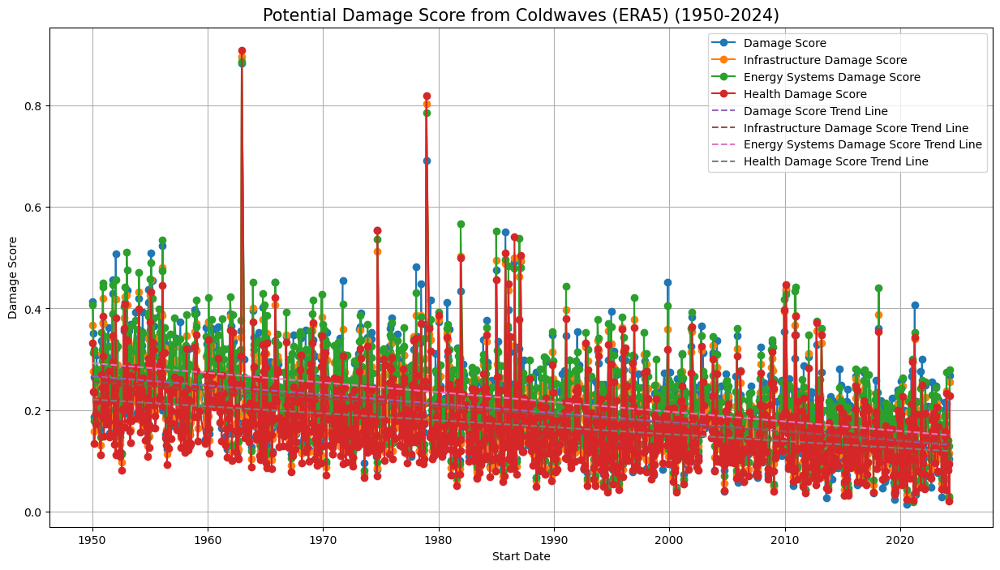

In [41]:
# Function to add a regression line
def add_regression_line(dates, y, label):
    dates_ordinal = dates.apply(lambda x: x.toordinal()).values.reshape(-1, 1)  # Convert dates to ordinals
    model = LinearRegression().fit(dates_ordinal, y)
    y_pred = model.predict(dates_ordinal)
    plt.plot(dates, y_pred, linestyle='--', label=label + ' Trend Line')

# Plotting
plt.figure(figsize=(15, 8))

# Plot the Damage Score data
plt.plot(damage_df['start_date'], damage_df['Damage Score'], marker='o', linestyle='-', label='Damage Score')

# Plot the Infrastructure Damage Score data
plt.plot(damage_df_infrastructure['start_date'], damage_df_infrastructure['Damage Score'], marker='o', linestyle='-', label='Infrastructure Damage Score')

# Plot the Energy Infrastructure Damage Score data
plt.plot(damage_df_energy_systems['start_date'], damage_df_energy_systems['Damage Score'], marker='o', linestyle='-', label='Energy Systems Damage Score')

# Plot the Health Damage Score data
plt.plot(damage_df_health['start_date'], damage_df_health['Damage Score'], marker='o', linestyle='-', label='Health Damage Score')

# Add regression line for Damage Score
add_regression_line(damage_df['start_date'], damage_df['Damage Score'], 'Damage Score')

# Add regression line for Infrastructure Damage Score
add_regression_line(damage_df_infrastructure['start_date'], damage_df_infrastructure['Damage Score'], 'Infrastructure Damage Score')

# Add regression line for Energy Infrastructure Damage Score
add_regression_line(damage_df_energy_systems['start_date'], damage_df_energy_systems['Damage Score'], 'Energy Systems Damage Score')

# Add regression line for Health Damage Score
add_regression_line(damage_df_health['start_date'], damage_df_health['Damage Score'], 'Health Damage Score')

plt.title('Potential Damage Score from Coldwaves (ERA5) (1950-2024)', fontsize=15)
plt.xlabel('Start Date')
plt.ylabel('Damage Score')
plt.grid(True)
plt.legend()

# Save the plot before showing it
#plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_damage_potential.png', dpi=300)

plt.show()

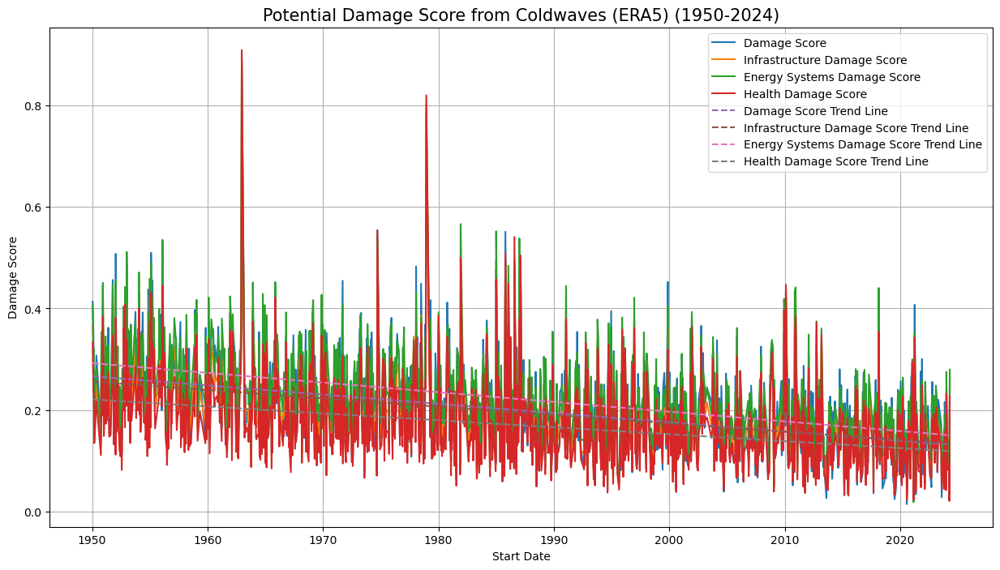

In [464]:
from sklearn.linear_model import LinearRegression

# Function to add a regression line
def add_regression_line(dates, y, label):
    dates_ordinal = dates.apply(lambda x: x.toordinal()).values.reshape(-1, 1)  # Convert dates to ordinals
    model = LinearRegression().fit(dates_ordinal, y)
    y_pred = model.predict(dates_ordinal)
    plt.plot(dates, y_pred, linestyle='--', label=label + ' Trend Line')

# Plotting
plt.figure(figsize=(15, 8))

# Plot the Damage Score data
plt.plot(damage_df['start_date'], damage_df['Damage Score'], linestyle='-', label='Damage Score')

# Plot the Infrastructure Damage Score data
plt.plot(damage_df_infrastructure['start_date'], damage_df_infrastructure['Damage Score'], linestyle='-', label='Infrastructure Damage Score')

# Plot the Energy Infrastructure Damage Score data
plt.plot(damage_df_energy_systems['start_date'], damage_df_energy_systems['Damage Score'], linestyle='-', label='Energy Systems Damage Score')

# Plot the Health Damage Score data
plt.plot(damage_df_health['start_date'], damage_df_health['Damage Score'], linestyle='-', label='Health Damage Score')

# Add regression line for Damage Score
add_regression_line(damage_df['start_date'], damage_df['Damage Score'], 'Damage Score')

# Add regression line for Infrastructure Damage Score
add_regression_line(damage_df_infrastructure['start_date'], damage_df_infrastructure['Damage Score'], 'Infrastructure Damage Score')

# Add regression line for Energy Infrastructure Damage Score
add_regression_line(damage_df_energy_systems['start_date'], damage_df_energy_systems['Damage Score'], 'Energy Systems Damage Score')

# Add regression line for Health Damage Score
add_regression_line(damage_df_health['start_date'], damage_df_health['Damage Score'], 'Health Damage Score')

plt.title('Potential Damage Score from Coldwaves (ERA5) (1950-2024)', fontsize=15)
plt.xlabel('Start Date')
plt.ylabel('Damage Score')
plt.grid(True)
plt.legend()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_damage_potential_clear_trends.png', dpi=300)

plt.show()

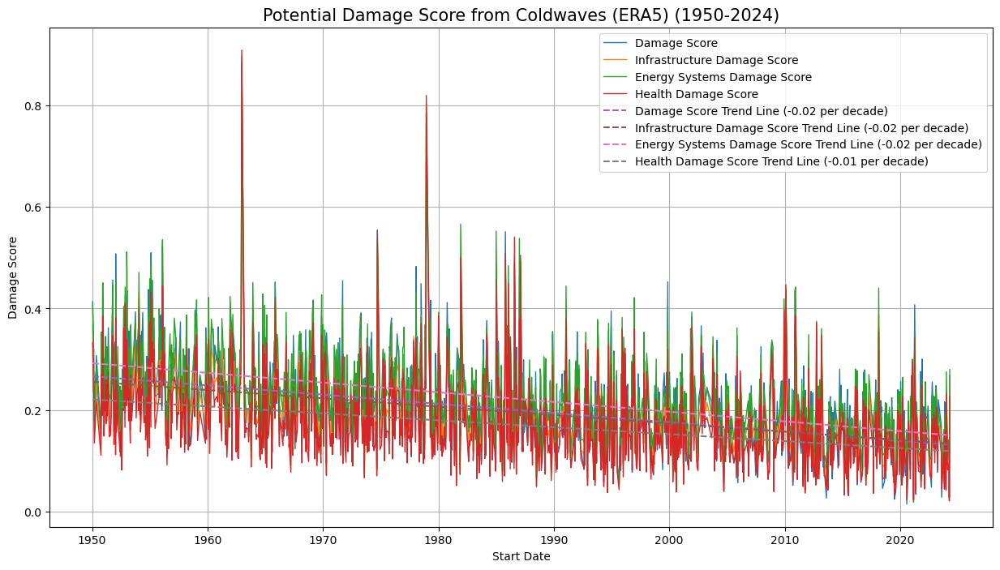

In [481]:
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.linear_model import LinearRegression

# Function to add a regression line and display trend per decade
def add_regression_line(dates, y, label):
    dates_ordinal = dates.apply(lambda x: x.toordinal()).values.reshape(-1, 1)  # Convert dates to ordinals
    model = LinearRegression().fit(dates_ordinal, y)
    y_pred = model.predict(dates_ordinal)
    
    # Calculate the slope (trend) per day
    slope_per_day = model.coef_[0]
    
    # Convert slope to per decade (10 years)
    days_per_decade = 365.25 * 10  # accounting for leap years
    trend_per_decade = slope_per_day * days_per_decade
    
    # Plot the regression line
    plt.plot(dates, y_pred, linestyle='--', label=f'{label} Trend Line ({trend_per_decade:.2f} per decade)')

# Plotting
plt.figure(figsize=(15, 8))

# Plot the Damage Score data
plt.plot(damage_df['start_date'], damage_df['Damage Score'], linestyle='-', linewidth=1, label='Damage Score')

# Plot the Infrastructure Damage Score data
plt.plot(damage_df_infrastructure['start_date'], damage_df_infrastructure['Damage Score'], linestyle='-', linewidth=1, label='Infrastructure Damage Score')

# Plot the Energy Infrastructure Damage Score data
plt.plot(damage_df_energy_systems['start_date'], damage_df_energy_systems['Damage Score'], linestyle='-', linewidth=1, label='Energy Systems Damage Score')

# Plot the Health Damage Score data
plt.plot(damage_df_health['start_date'], damage_df_health['Damage Score'], linestyle='-', linewidth=1, label='Health Damage Score')

# Add regression line for Damage Score
add_regression_line(damage_df['start_date'], damage_df['Damage Score'], 'Damage Score')

# Add regression line for Infrastructure Damage Score
add_regression_line(damage_df_infrastructure['start_date'], damage_df_infrastructure['Damage Score'], 'Infrastructure Damage Score')

# Add regression line for Energy Infrastructure Damage Score
add_regression_line(damage_df_energy_systems['start_date'], damage_df_energy_systems['Damage Score'], 'Energy Systems Damage Score')

# Add regression line for Health Damage Score
add_regression_line(damage_df_health['start_date'], damage_df_health['Damage Score'], 'Health Damage Score')

plt.title('Potential Damage Score from Coldwaves (ERA5) (1950-2024)', fontsize=15)
plt.xlabel('Start Date')
plt.ylabel('Damage Score')
plt.grid(True)
plt.legend()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_damage_potential_clear_trends_perdecade.png', dpi=300)

plt.show()


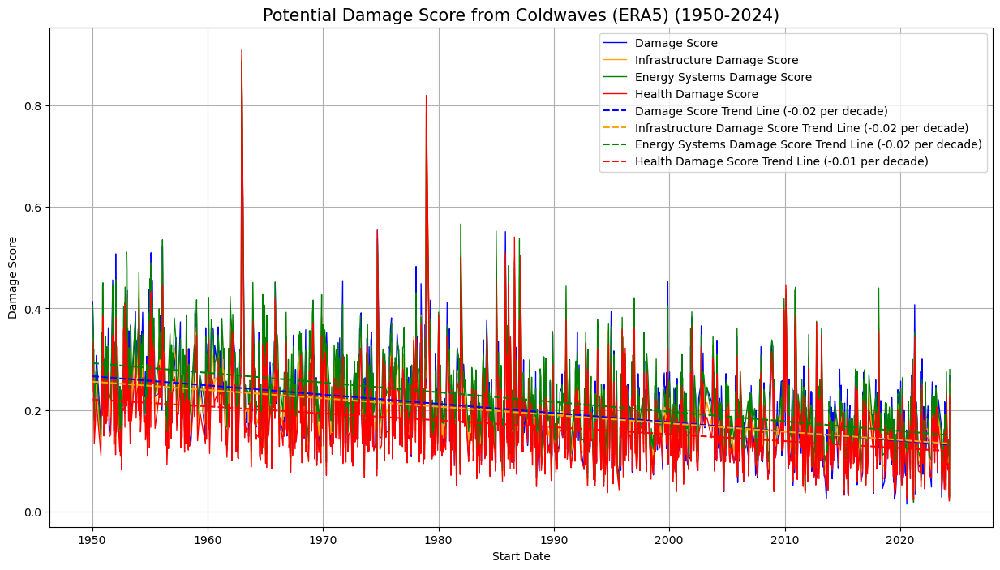

In [483]:
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.linear_model import LinearRegression

# Function to add a regression line and display trend per decade
def add_regression_line(dates, y, label, color):
    dates_ordinal = dates.apply(lambda x: x.toordinal()).values.reshape(-1, 1)  # Convert dates to ordinals
    model = LinearRegression().fit(dates_ordinal, y)
    y_pred = model.predict(dates_ordinal)
    
    # Calculate the slope (trend) per day
    slope_per_day = model.coef_[0]
    
    # Convert slope to per decade (10 years)
    days_per_decade = 365.25 * 10  # accounting for leap years
    trend_per_decade = slope_per_day * days_per_decade
    
    # Plot the regression line with transparency and a different line style
    plt.plot(dates, y_pred, linestyle='--', color=color, label=f'{label} Trend Line ({trend_per_decade:.2f} per decade)')

# Plotting
plt.figure(figsize=(15, 8))

# Define distinct colors for each line
colors = ['blue', 'orange', 'green', 'red']

# Plot the Damage Score data with distinct colors and thinner lines
plt.plot(damage_df['start_date'], damage_df['Damage Score'], linestyle='-', color=colors[0], linewidth=1, label='Damage Score')
plt.plot(damage_df_infrastructure['start_date'], damage_df_infrastructure['Damage Score'], linestyle='-', color=colors[1], linewidth=1, label='Infrastructure Damage Score')
plt.plot(damage_df_energy_systems['start_date'], damage_df_energy_systems['Damage Score'], linestyle='-', color=colors[2], linewidth=1, label='Energy Systems Damage Score')
plt.plot(damage_df_health['start_date'], damage_df_health['Damage Score'], linestyle='-', color=colors[3], linewidth=1, label='Health Damage Score')

# Add regression lines with transparency
add_regression_line(damage_df['start_date'], damage_df['Damage Score'], 'Damage Score', colors[0])
add_regression_line(damage_df_infrastructure['start_date'], damage_df_infrastructure['Damage Score'], 'Infrastructure Damage Score', colors[1])
add_regression_line(damage_df_energy_systems['start_date'], damage_df_energy_systems['Damage Score'], 'Energy Systems Damage Score', colors[2])
add_regression_line(damage_df_health['start_date'], damage_df_health['Damage Score'], 'Health Damage Score', colors[3])

plt.title('Potential Damage Score from Coldwaves (ERA5) (1950-2024)', fontsize=15)
plt.xlabel('Start Date')
plt.ylabel('Damage Score')
plt.grid(True)
plt.legend()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_damage_potential_clear_trends_perdecade(extra).png', dpi=300)

plt.show()


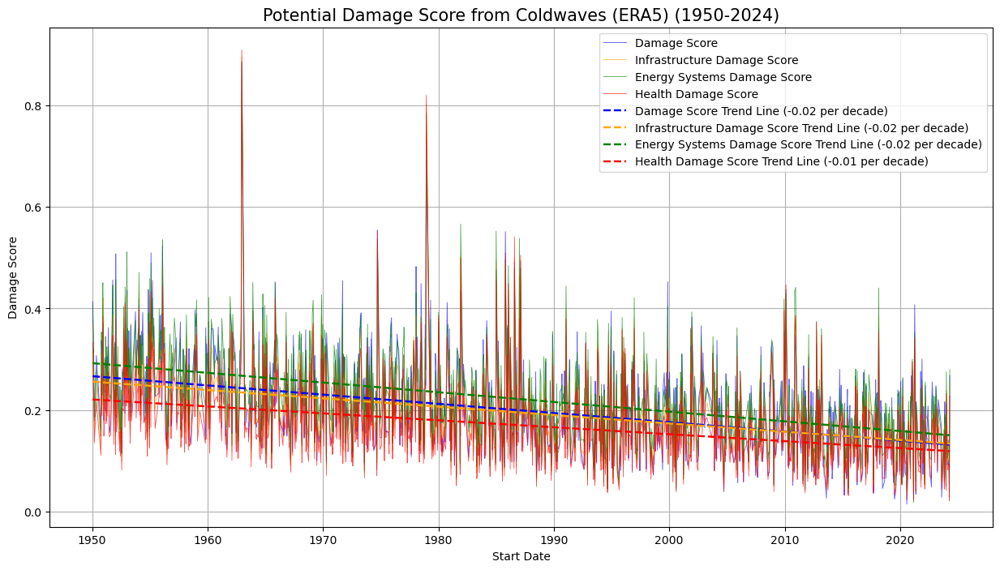

In [43]:
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.linear_model import LinearRegression

# Function to add a regression line and display trend per decade
def add_regression_line(dates, y, label, color,lw):
    dates_ordinal = dates.apply(lambda x: x.toordinal()).values.reshape(-1, 1)  # Convert dates to ordinals
    model = LinearRegression().fit(dates_ordinal, y)
    y_pred = model.predict(dates_ordinal)
    
    # Calculate the slope (trend) per day
    slope_per_day = model.coef_[0]
    
    # Convert slope to per decade (10 years)
    days_per_decade = 365.25 * 10  # accounting for leap years
    trend_per_decade = slope_per_day * days_per_decade
    
    # Plot the regression line with transparency and a different line style
    plt.plot(dates, y_pred, linestyle='--', color=color, label=f'{label} Trend Line ({trend_per_decade:.2f} per decade)',lw=lw)

# Plotting
plt.figure(figsize=(15, 8))

# Define distinct colors for each line
colors = ['blue', 'orange', 'green', 'red']

# Plot the Damage Score data with distinct colors and thinner lines
plt.plot(damage_df['start_date'], damage_df['Damage Score'], linestyle='-', color=colors[0], linewidth=.7, label='Damage Score',alpha=0.6)
plt.plot(damage_df_infrastructure['start_date'], damage_df_infrastructure['Damage Score'], linestyle='-', color=colors[1], linewidth=.6, label='Infrastructure Damage Score', alpha=0.7)
plt.plot(damage_df_energy_systems['start_date'], damage_df_energy_systems['Damage Score'], linestyle='-', color=colors[2], linewidth=.6, label='Energy Systems Damage Score', alpha=0.7)
plt.plot(damage_df_health['start_date'], damage_df_health['Damage Score'], linestyle='-', color=colors[3], linewidth=.6, label='Health Damage Score', alpha=0.7)

# Add regression lines with transparency
add_regression_line(damage_df['start_date'], damage_df['Damage Score'], 'Damage Score', colors[0],lw=1.75)
add_regression_line(damage_df_infrastructure['start_date'], damage_df_infrastructure['Damage Score'], 'Infrastructure Damage Score', colors[1],lw=1.75)
add_regression_line(damage_df_energy_systems['start_date'], damage_df_energy_systems['Damage Score'], 'Energy Systems Damage Score', colors[2],lw=1.75)
add_regression_line(damage_df_health['start_date'], damage_df_health['Damage Score'], 'Health Damage Score', colors[3],lw=1.75)

plt.title('Potential Damage Score from Coldwaves (ERA5) (1950-2024)', fontsize=15)
plt.xlabel('Start Date')
plt.ylabel('Damage Score')
plt.grid(True)
plt.legend()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_damage_potential_clear_trends_perdecade(extra).png', dpi=300)

plt.show()

In [47]:
damage_df['start_date']

0      1950-01-19 12:00:00
1      1950-02-12 12:00:00
2      1950-02-23 12:00:00
3      1950-03-12 12:00:00
4      1950-04-13 12:00:00
               ...        
1368   2024-02-22 12:00:00
1369   2024-03-01 12:00:00
1370   2024-03-25 12:00:00
1371   2024-04-03 12:00:00
1372   2024-04-18 12:00:00
Name: start_date, Length: 1373, dtype: datetime64[ns]

# 19.1 Cold Wave Indicies

In [487]:
def calculate_cwmi(dataset, 
                   temp_metric='tasmin', 
                   duration_metric='length', 
                   severity_metric='severity'):
    """
    Calculate the Cold Wave Magnitude Index (CWMI) from the given dataset.

    Parameters:
    dataset (xarray.Dataset): Dataset containing coldwave metrics.
    temp_metric (str): Name of the temperature metric in the dataset.
    duration_metric (str): Name of the duration metric in the dataset.
    severity_metric (str): Name of the severity metric in the dataset.

    Returns:
    xarray.DataArray: CWMI values.
    """
    # Extract metrics from dataset
    temperature = dataset[temp_metric]
    duration = dataset[duration_metric]
    severity = dataset[severity_metric]

    # Normalizing each metric to the range [0, 1]
    temp_normalized = (temperature.max() - temperature) / (temperature.max() - temperature.min())
    dur_normalized = (duration - duration.min()) / (duration.max() - duration.min())
    sev_normalized = (severity - severity.min()) / (severity.max() - severity.min())

    # Calculate CWMI as a product of normalized metrics
    cwmi = dur_normalized * sev_normalized * temp_normalized

    # Apply a small offset to avoid zero values
    cwmi += np.finfo(float).eps

    return cwmi

In [488]:
def calculate_ccwi(dataset, 
                   temp_metric='tasmin', 
                   duration_metric='length', 
                   severity_metric='severity', 
                   extremes_metric='min_temps'):
    temperature = dataset[temp_metric]
    duration = dataset[duration_metric]
    severity = dataset[severity_metric]
    extremes = dataset[extremes_metric]

    # Normalizing each metric
    temp_normalized = (temperature.max() - temperature) / (temperature.max() - temperature.min())
    dur_normalized = (duration - duration.min()) / (duration.max() - duration.min())
    sev_normalized = (severity - severity.min()) / (severity.max() - severity.min())
    ext_normalized = (extremes.max() - extremes) / (extremes.max() - extremes.min())

    # Combining metrics into CCWI
    ccwi = 0.25 * temp_normalized + 0.25 * dur_normalized + 0.25 * sev_normalized + 0.25 * ext_normalized
    
    return ccwi


In [491]:
# Compute the indices
cwmi = calculate_cwmi(coldwave_dataset)
ccwi = calculate_ccwi(coldwave_dataset)

# Convert to DataFrame for easy plotting
indices_df = pd.DataFrame({
    'start_date': coldwave_dataset['start_date'].values,
    'CWMI': cwmi,
    'CCWI': ccwi
})

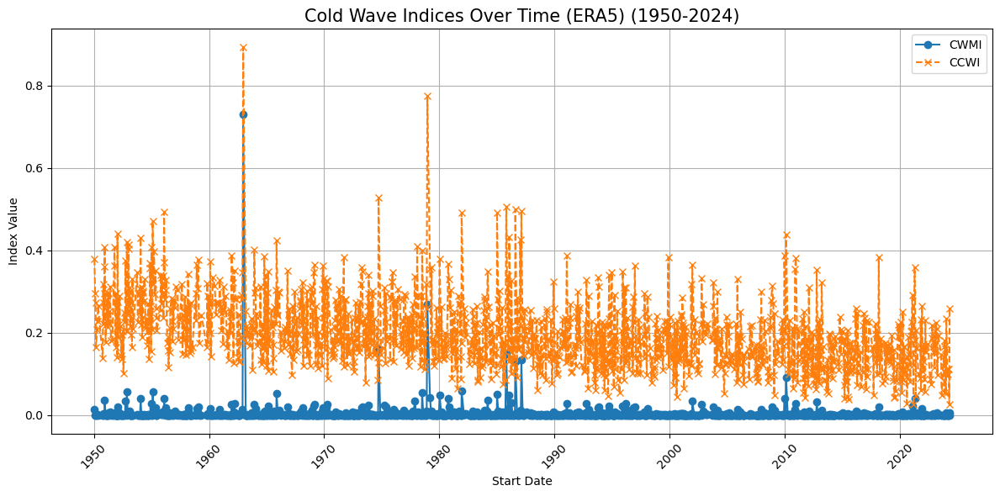

In [493]:
# Plotting
plt.figure(figsize=(12, 6))
plt.plot(indices_df['start_date'], indices_df['CWMI'], marker='o', linestyle='-', label='CWMI')
plt.plot(indices_df['start_date'], indices_df['CCWI'], marker='x', linestyle='--', label='CCWI')
plt.title('Cold Wave Indices Over Time (ERA5) (1950-2024)', fontsize=15)
plt.xlabel('Start Date')
plt.ylabel('Index Value')
plt.grid(True)
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_CCWI_CWMI.png', dpi=300)

plt.show()

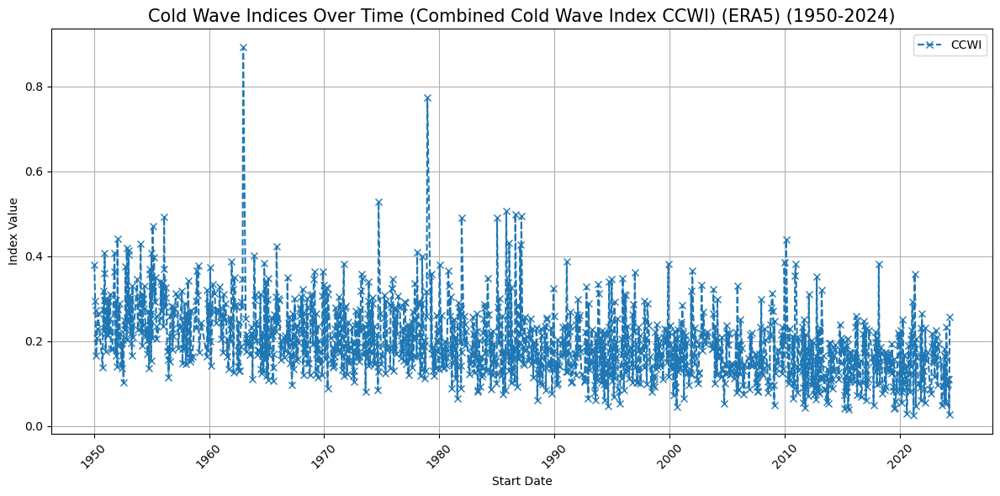

In [495]:
# Plotting
plt.figure(figsize=(12, 6))
#plt.plot(indices_df['start_date'], indices_df['CWMI'], marker='o', linestyle='-', label='CWMI')
plt.plot(indices_df['start_date'], indices_df['CCWI'], marker='x', linestyle='--', label='CCWI')
plt.title('Cold Wave Indices Over Time (Combined Cold Wave Index CCWI) (ERA5) (1950-2024)', fontsize=15)
plt.xlabel('Start Date')
plt.ylabel('Index Value')
plt.grid(True)
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_CCWI.png', dpi=300)

plt.show()

# 19.2 Metric Visualisation

In [497]:
# Convert dataset to DataFrame
metrics_df = coldwave_dataset.to_dataframe().reset_index()

# Flatten 'min_temps' arrays to scalar values
metrics_df['min_temps'] = metrics_df['min_temps'].apply(lambda x: x.item() if isinstance(x, np.ndarray) else x)

# Select only the relevant columns
selected_columns = ['tasmin', 'length', 'severity', 'min_temps']
metrics_df_selected = metrics_df[selected_columns]

# Convert 'min_temps' to numeric, handling errors
metrics_df_selected['min_temps'] = pd.to_numeric(metrics_df_selected['min_temps'], errors='coerce')

# Drop rows with NaN values if any
metrics_df_selected = metrics_df_selected.dropna()

# Ensure all columns are numeric
numeric_metrics_df = metrics_df_selected.select_dtypes(include=[float, int])

# Check correlation matrix
correlation_matrix = numeric_metrics_df.corr()

# Custom column labels
custom_labels = {
    'tasmin': 'Daily Min Temp (°C)',
    'length': 'Duration (Days)',
    'severity': 'Severity Index',
    'min_temps': 'Extreme Min Temp (°C)'
}

# Update column and index names in correlation matrix for custom labels
correlation_matrix = correlation_matrix.rename(columns=custom_labels, index=custom_labels)

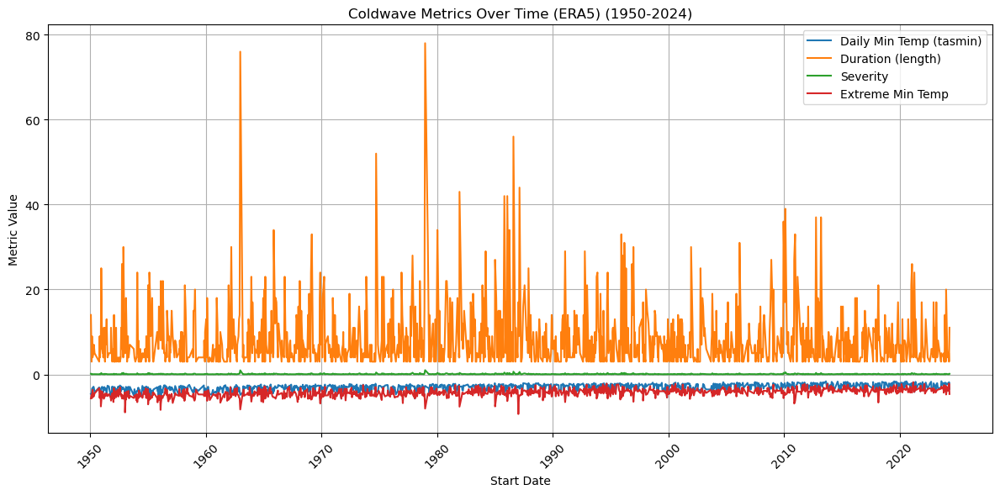

In [499]:
plt.figure(figsize=(12, 6))
plt.plot(metrics_df['start_date'], metrics_df['tasmin'], label='Daily Min Temp (tasmin)')
plt.plot(metrics_df['start_date'], metrics_df['length'], label='Duration (length)')
plt.plot(metrics_df['start_date'], metrics_df['severity'], label='Severity')
plt.plot(metrics_df['start_date'], metrics_df['min_temps'], label='Extreme Min Temp')
plt.title('Coldwave Metrics Over Time (ERA5) (1950-2024)')
plt.xlabel('Start Date')
plt.ylabel('Metric Value')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_combined_metrics_1plot.png', dpi=300)

plt.show()


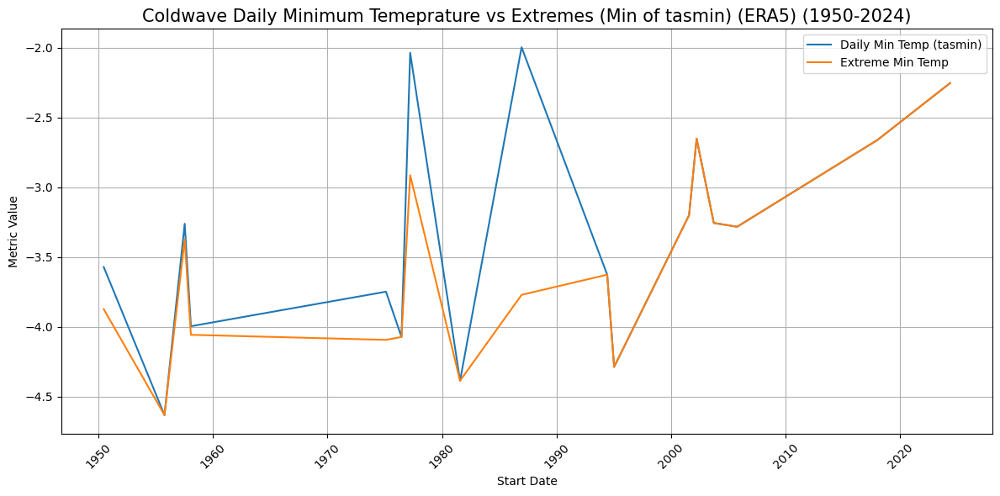

In [1105]:
plt.figure(figsize=(12, 6))
plt.plot(metrics_df['start_date'], metrics_df['tasmin'], label='Daily Min Temp (tasmin)')
#plt.plot(metrics_df['start_date'], metrics_df['length'], label='Duration (length)')
#plt.plot(metrics_df['start_date'], metrics_df['severity'], label='Severity')
plt.plot(metrics_df['start_date'], metrics_df['min_temps'], label='Extreme Min Temp')
plt.title('Coldwave Daily Minimum Temeprature vs Extremes (Min of tasmin) (ERA5) (1950-2024)', fontsize=15)
plt.xlabel('Start Date')
plt.ylabel('Metric Value')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_comparison_tasmin_extremes.png', dpi=300)

plt.show()


In [501]:
# Custom column labels
custom_labels = {
    'tasmin': 'Daily Min Temp (°C)',
    'length': 'Duration (Days)',
    'severity': 'Severity Index',
    'min_temps': 'Extreme Min Temp (°C)'
}

# Update column and index names in correlation matrix for custom labels
metrics_df_selected_named = metrics_df_selected.rename(columns=custom_labels, index=custom_labels)


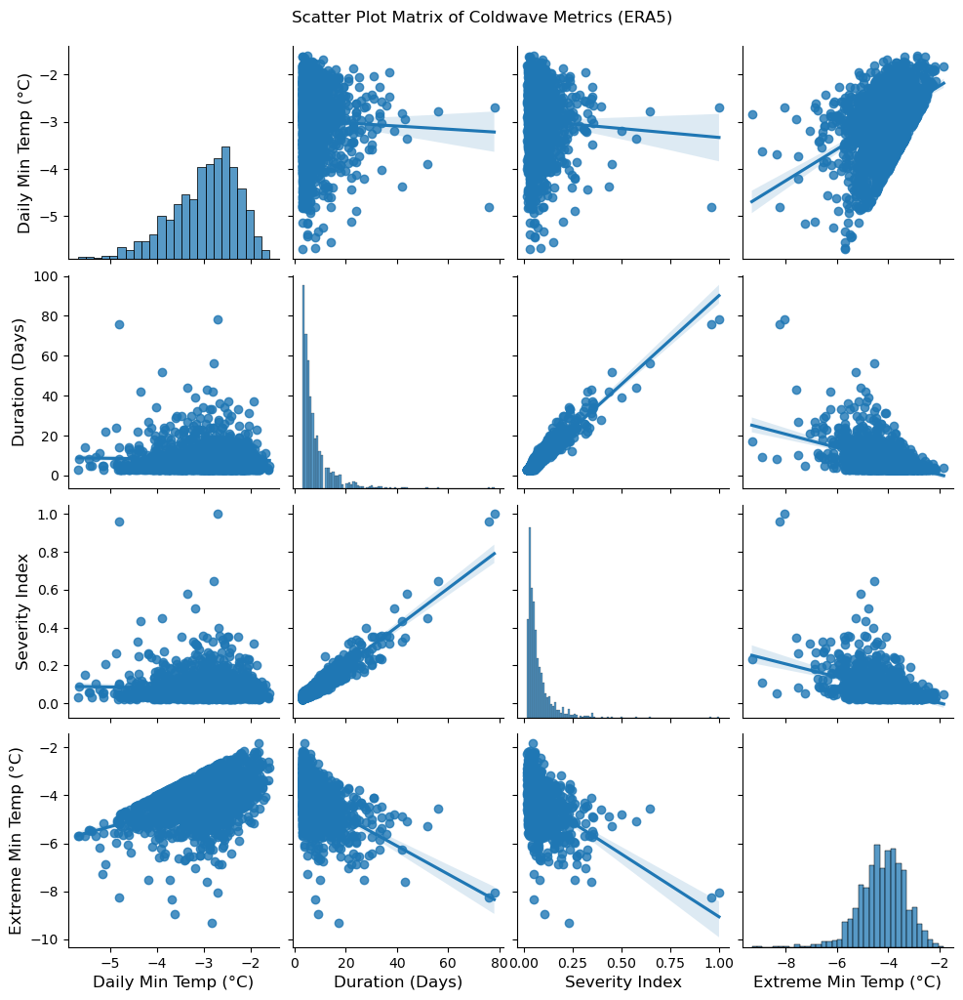

In [502]:
import seaborn as sns
from pandas.plotting import scatter_matrix

# PairPlot with lines of best fit
pair_plot = sns.pairplot(metrics_df_selected_named, diag_kind='hist', markers='o', palette='viridis', kind='reg')

# Customize plot appearance
pair_plot.fig.suptitle('Scatter Plot Matrix of Coldwave Metrics (ERA5)', y=1.02)  # Title above the plots
for ax in pair_plot.axes.flatten():
    ax.set_xlabel(ax.get_xlabel(), fontsize=12)
    ax.set_ylabel(ax.get_ylabel(), fontsize=12)
    
# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_metrics_scatter_matrix.png', dpi=300)


# Show the plot
plt.show()

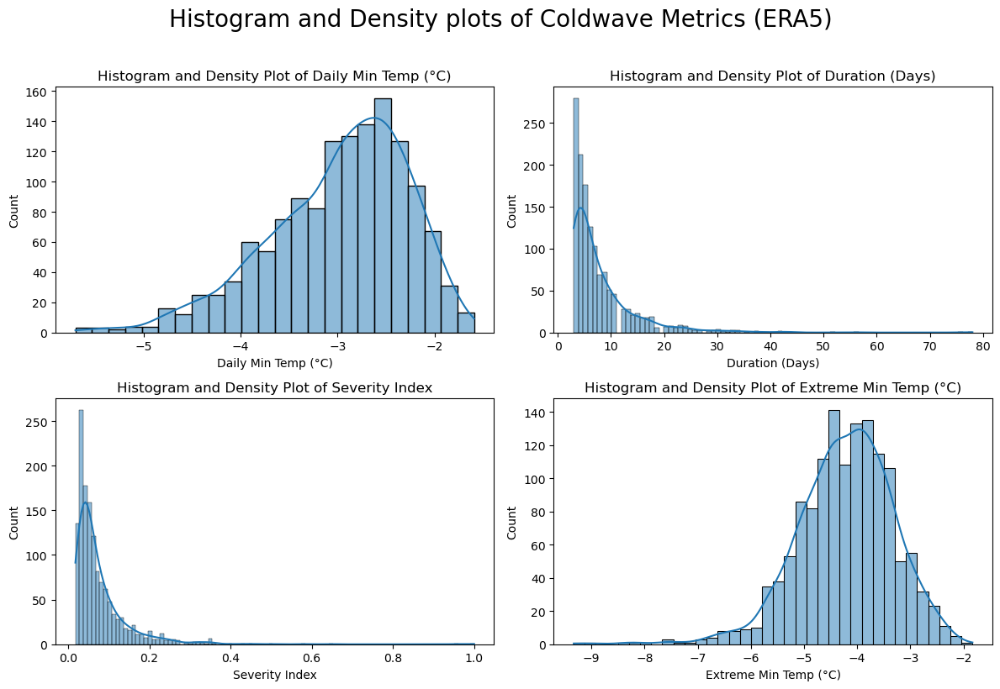

In [505]:
# Plot histograms and density plots for each metric
plt.figure(figsize=(12, 8))
for i, column in enumerate(metrics_df_selected_named.columns, 1):
    plt.subplot(2, 2, i)
    sns.histplot(metrics_df_selected_named[column], kde=True)
    plt.title(f'Histogram and Density Plot of {column}')

# Add main title
plt.suptitle('Histogram and Density plots of Coldwave Metrics (ERA5)', fontsize=20, y=1.02)

# Adjust layout
plt.tight_layout()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_metrics_histogram_density_plot.png', dpi=300)

# Show plot
plt.show()

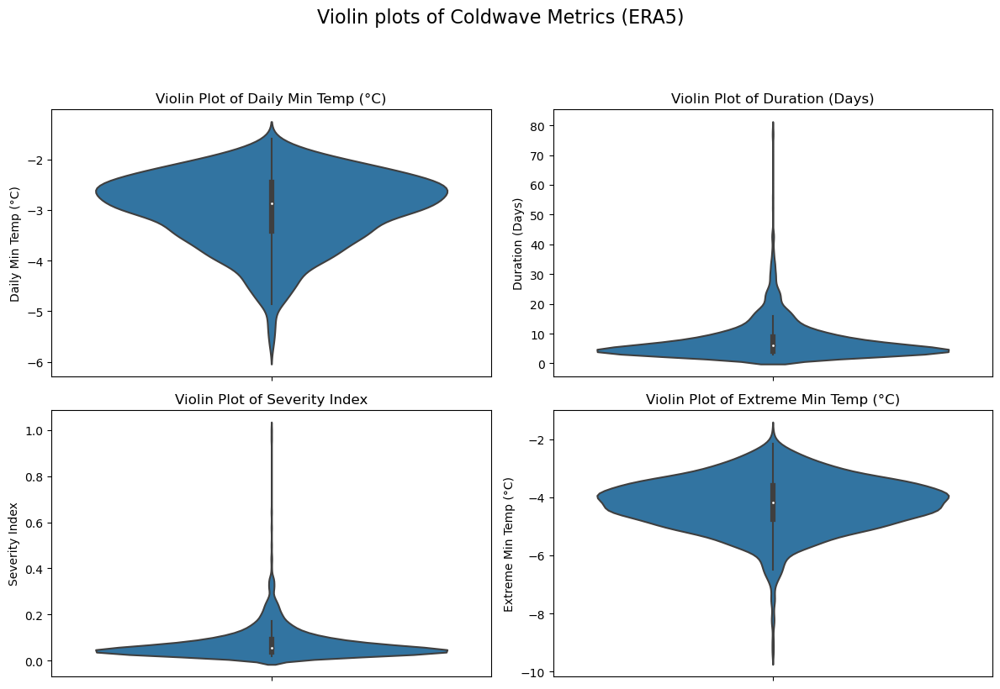

In [506]:
# Plot violin plots for each metric
plt.figure(figsize=(12, 8))
for i, column in enumerate(metrics_df_selected_named.columns, 1):
    plt.subplot(2, 2, i)
    sns.violinplot(y=metrics_df_selected_named[column])
    plt.title(f'Violin Plot of {column}')

# Add main title
plt.suptitle('Violin plots of Coldwave Metrics (ERA5)', fontsize=16, y=1.02)

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.96])

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_metrics_violin_plot.png', dpi=300)

# Show plot
plt.show()


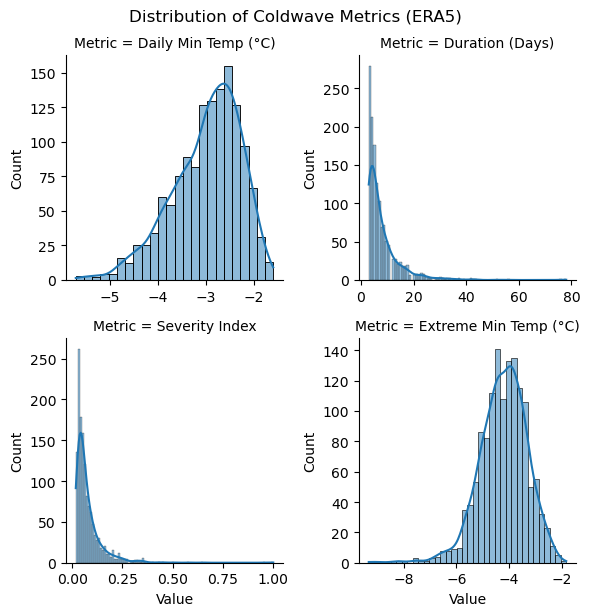

In [507]:
g = sns.FacetGrid(metrics_df_selected_named.melt(var_name='Metric', value_name='Value'), col='Metric', col_wrap=2, sharex=False, sharey=False)
g.map(sns.histplot, 'Value', kde=True)
g.fig.suptitle('Distribution of Coldwave Metrics (ERA5)', y=1.02)

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_metrics_facetgrid_plot.png', dpi=300)

plt.show()

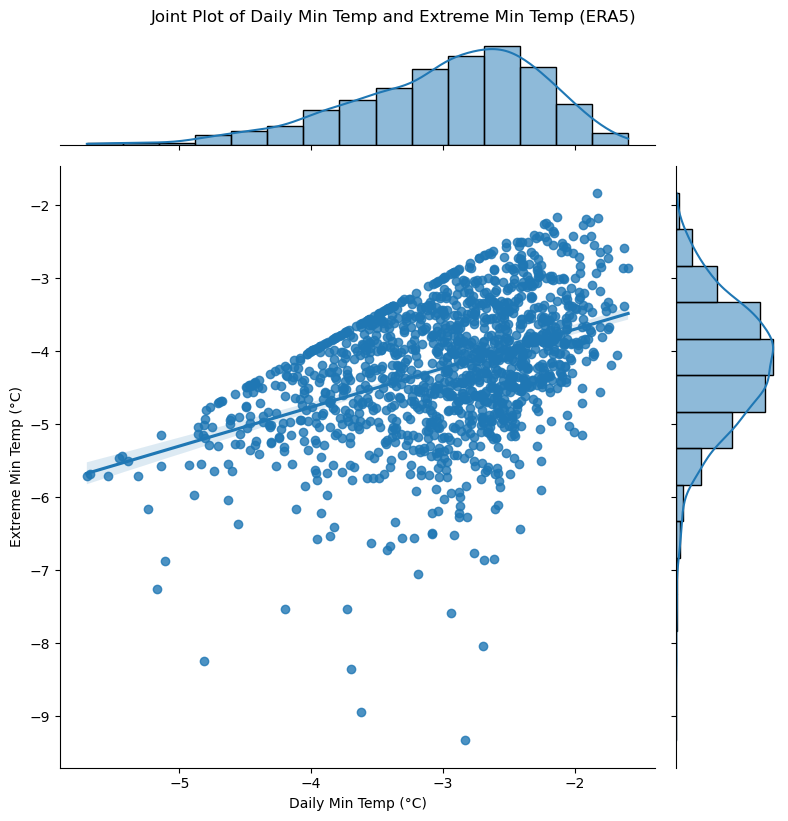

In [510]:
sns.jointplot(data=metrics_df_selected_named, x='Daily Min Temp (°C)', y='Extreme Min Temp (°C)', kind='reg', height=8, marginal_kws=dict(bins=15, fill=True))
plt.suptitle('Joint Plot of Daily Min Temp and Extreme Min Temp (ERA5)', y=1.02)

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_metrics_jointplot_tasmin_extreme.png', dpi=300)

plt.show()


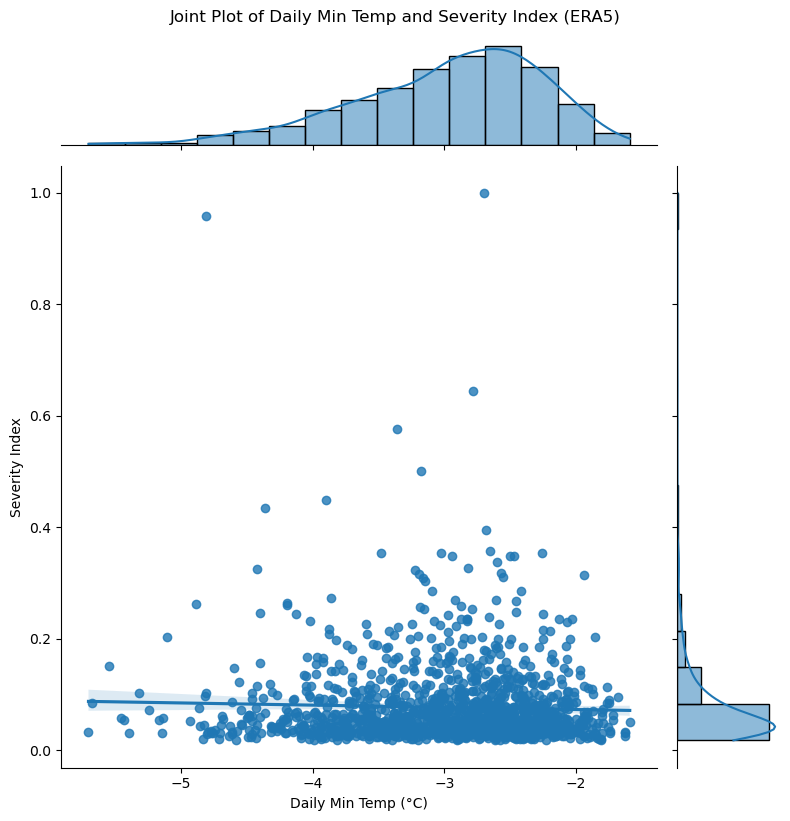

In [511]:
sns.jointplot(data=metrics_df_selected_named, x='Daily Min Temp (°C)', y='Severity Index', kind='reg', height=8, marginal_kws=dict(bins=15, fill=True))
plt.suptitle('Joint Plot of Daily Min Temp and Severity Index (ERA5)', y=1.02)

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_metrics_jointplot_tasmin_sverity.png', dpi=300)

plt.show()

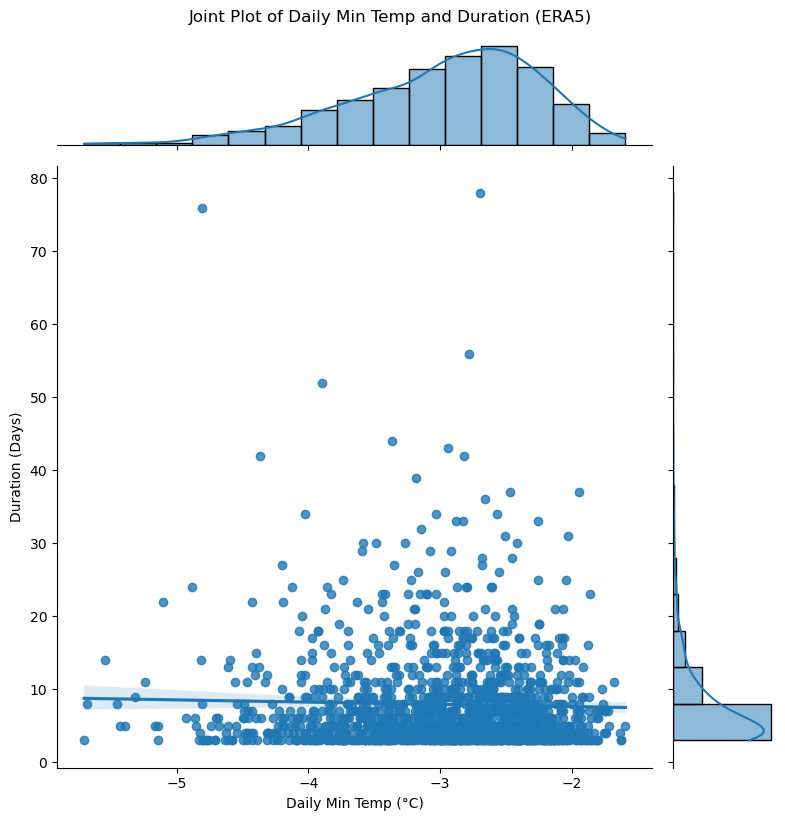

In [512]:
sns.jointplot(data=metrics_df_selected_named, x='Daily Min Temp (°C)', y='Duration (Days)', kind='reg', height=8, marginal_kws=dict(bins=15, fill=True))
plt.suptitle('Joint Plot of Daily Min Temp and Duration (ERA5)', y=1.02)

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_metrics_jointplot_tasmin_duration.png', dpi=300)

plt.show()

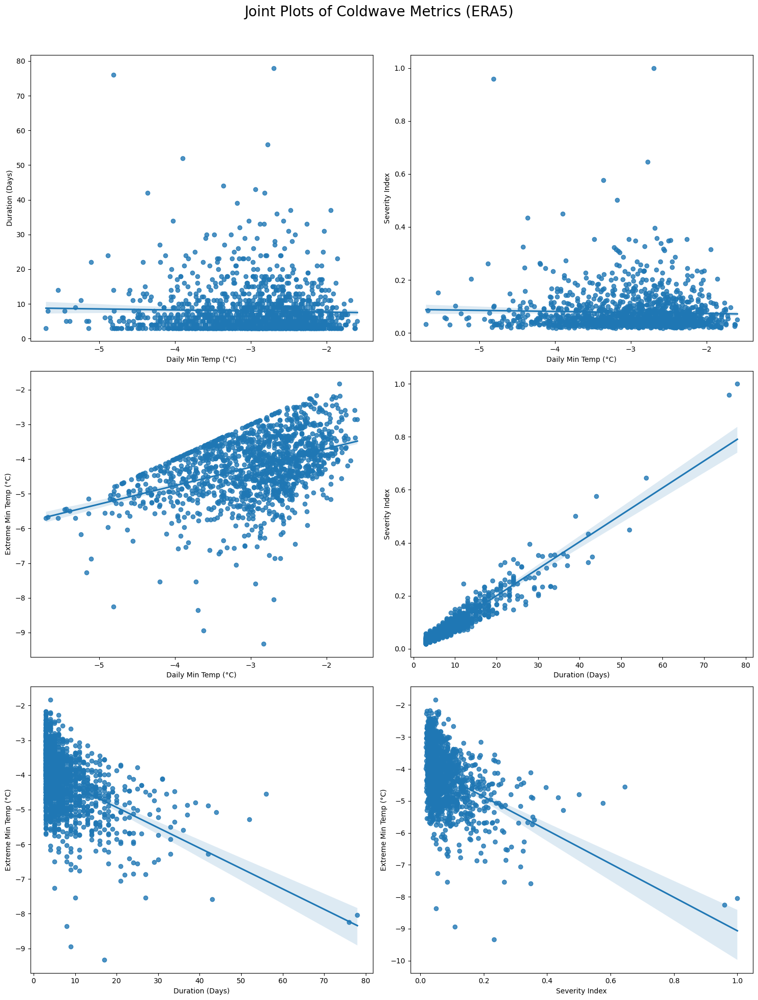

In [513]:
# Mapping the variables to their more descriptive names
metric_names = {
    'tasmin': 'Daily Min Temp (°C)',
    'length': 'Duration (Days)',
    'severity': 'Severity Index',
    'min_temps': 'Extreme Min Temp (°C)'
}

# Create a figure to hold all jointplots
fig, axes = plt.subplots(3, 2, figsize=(15, 20))
fig.suptitle('Joint Plots of Coldwave Metrics (ERA5)', y=0.98, fontsize=20)

# First pair: 'tasmin' vs 'length'
sns.regplot(ax=axes[0, 0], data=metrics_df_selected, x='tasmin', y='length')
axes[0, 0].set_xlabel(metric_names['tasmin'])
axes[0, 0].set_ylabel(metric_names['length'])

# Second pair: 'tasmin' vs 'severity'
sns.regplot(ax=axes[0, 1], data=metrics_df_selected, x='tasmin', y='severity')
axes[0, 1].set_xlabel(metric_names['tasmin'])
axes[0, 1].set_ylabel(metric_names['severity'])

# Third pair: 'tasmin' vs 'min_temps'
sns.regplot(ax=axes[1, 0], data=metrics_df_selected, x='tasmin', y='min_temps')
axes[1, 0].set_xlabel(metric_names['tasmin'])
axes[1, 0].set_ylabel(metric_names['min_temps'])

# Fourth pair: 'length' vs 'severity'
sns.regplot(ax=axes[1, 1], data=metrics_df_selected, x='length', y='severity')
axes[1, 1].set_xlabel(metric_names['length'])
axes[1, 1].set_ylabel(metric_names['severity'])

# Fifth pair: 'length' vs 'min_temps'
sns.regplot(ax=axes[2, 0], data=metrics_df_selected, x='length', y='min_temps')
axes[2, 0].set_xlabel(metric_names['length'])
axes[2, 0].set_ylabel(metric_names['min_temps'])

# Sixth pair: 'severity' vs 'min_temps'
sns.regplot(ax=axes[2, 1], data=metrics_df_selected, x='severity', y='min_temps')
axes[2, 1].set_xlabel(metric_names['severity'])
axes[2, 1].set_ylabel(metric_names['min_temps'])

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.96])  # Increase the bottom margin of the layout to make space for the title

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_metrics_jointplots_combined.png', dpi=300)

plt.show()

# 20. Further Analysis Coldwave Metrics

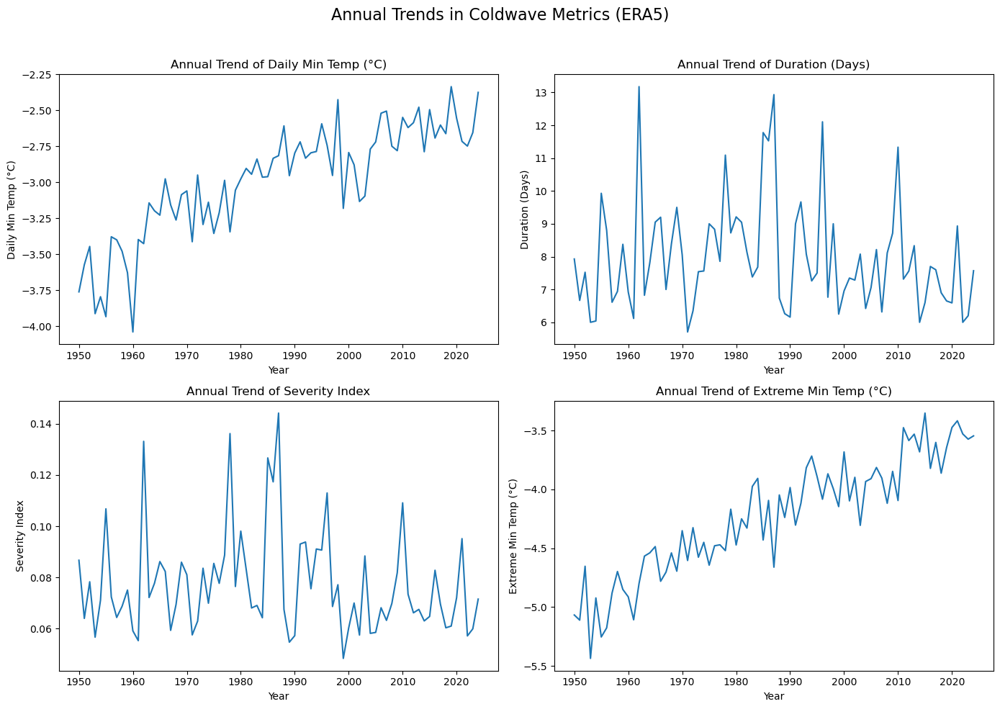

In [11]:
# Convert xarray DataArray to pandas DataFrame
metrics_df = coldwave_dataset.to_dataframe().reset_index()

# Convert 'start_date' to pandas datetime if needed
# Here assuming 'start_date' is a cftime object, so extract year directly
# If 'start_date' is already a string or datetime, adjust accordingly
metrics_df['start_date'] = pd.to_datetime(metrics_df['start_date'].astype(str))

# Extract year from 'start_date'
metrics_df['year'] = metrics_df['start_date'].dt.year

# Select relevant columns
metrics_df_selected = metrics_df[['year', 'tasmin', 'length', 'severity', 'min_temps']]

# Group by year and calculate the mean for each metric
annual_trends = metrics_df_selected.groupby('year').mean()

# Plot trends over time
fig, axes = plt.subplots(2, 2, figsize=(14, 10))
fig.suptitle('Annual Trends in Coldwave Metrics (ERA5)', fontsize=16)

# Map metric names
metric_names = {
    'tasmin': 'Daily Min Temp (°C)',
    'length': 'Duration (Days)',
    'severity': 'Severity Index',
    'min_temps': 'Extreme Min Temp (°C)'
}

for ax, column in zip(axes.flat, ['tasmin', 'length', 'severity', 'min_temps']):
    ax.plot(annual_trends.index, annual_trends[column])
    ax.set_title(f'Annual Trend of {metric_names[column]}')
    ax.set_xlabel('Year')
    ax.set_ylabel(metric_names[column])

plt.tight_layout(rect=[0, 0, 1, 0.96])

# Save the plot before showing it
#plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_metrics_annual_trends.png', dpi=300)

plt.show()

In [13]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import seaborn as sns


# Convert xarray DataArray to pandas DataFrame
metrics_df = coldwave_dataset.to_dataframe().reset_index()

# Flatten and clean 'min_temps' column
def extract_numeric_value(array_like):
    """Extract numeric value from array-like structure."""
    if isinstance(array_like, np.ndarray):
        # Convert array-like to scalar if possible
        return array_like.item() if array_like.size > 0 else np.nan
    return array_like

# Apply the extraction function to 'min_temps'
metrics_df['min_temps'] = metrics_df['min_temps'].apply(extract_numeric_value)

# Convert relevant columns to numeric and handle errors
metrics_df['tasmin'] = pd.to_numeric(metrics_df['tasmin'], errors='coerce')
metrics_df['length'] = pd.to_numeric(metrics_df['length'], errors='coerce')
metrics_df['severity'] = pd.to_numeric(metrics_df['severity'], errors='coerce')
metrics_df['min_temps'] = pd.to_numeric(metrics_df['min_temps'], errors='coerce')

# Drop rows with NaN values in selected columns
metrics_df_selected = metrics_df.dropna(subset=['tasmin', 'length', 'severity', 'min_temps'])

# Check data types and contents
print("Data Types:")
print(metrics_df_selected.dtypes)
print("\nSample Data:")
print(metrics_df_selected.head())


Data Types:
index                     int64
start_date       datetime64[ns]
end_date         datetime64[ns]
length                    int64
severity                float64
tasmin                  float32
mean_tasmin             float32
min_temps               float64
min_temp_flag              bool
dtype: object

Sample Data:
   index          start_date            end_date  length  severity    tasmin  \
0      0 1950-01-19 12:00:00 1950-02-01 12:00:00      14  0.147622 -4.597478   
1      1 1950-02-12 12:00:00 1950-02-14 12:00:00       3  0.031697 -4.770039   
2      2 1950-02-23 12:00:00 1950-03-03 12:00:00       9  0.090821 -3.401092   
3      3 1950-03-12 12:00:00 1950-03-15 12:00:00       4  0.042187 -3.171635   
4      4 1950-04-13 12:00:00 1950-04-17 12:00:00       5  0.052392 -2.892752   

   mean_tasmin  min_temps  min_temp_flag  
0    -4.633050  -5.637524          False  
1    -4.154053  -4.770039          False  
2    -4.681537  -5.589410          False  
3    -3.209326  -3.

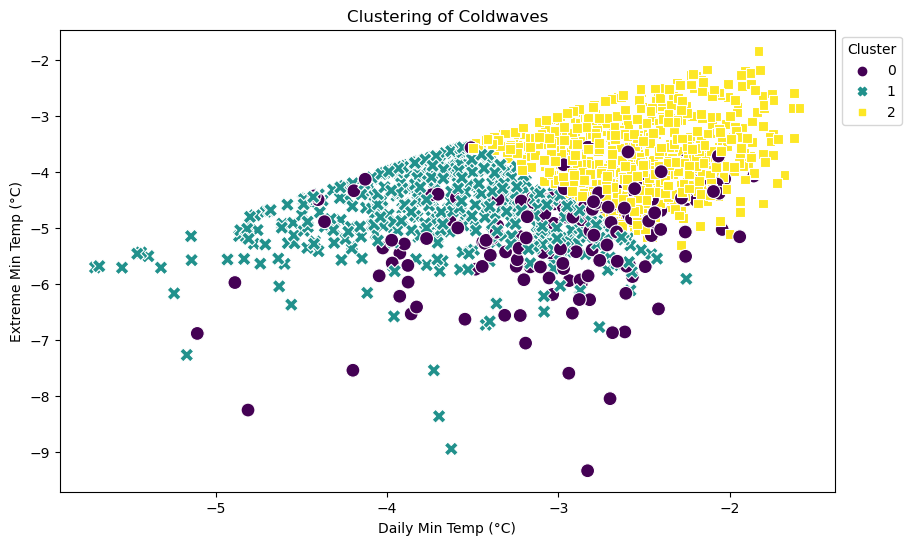

In [15]:
# Standardize the metrics
scaler = StandardScaler()
scaled_metrics = scaler.fit_transform(metrics_df_selected[['tasmin', 'length', 'severity', 'min_temps']])

# Perform KMeans clustering
kmeans = KMeans(n_clusters=3, random_state=42)
metrics_df_selected['cluster'] = kmeans.fit_predict(scaled_metrics)

# Plot clusters
plt.figure(figsize=(10, 6))
sns.scatterplot(data=metrics_df_selected, x='tasmin', y='min_temps', hue='cluster', palette='viridis', style='cluster', s=100)
plt.title('Clustering of Coldwaves')
plt.xlabel('Daily Min Temp (°C)')
plt.ylabel('Extreme Min Temp (°C)')
plt.legend(title='Cluster', loc='upper left', bbox_to_anchor=(1, 1))
plt.show()

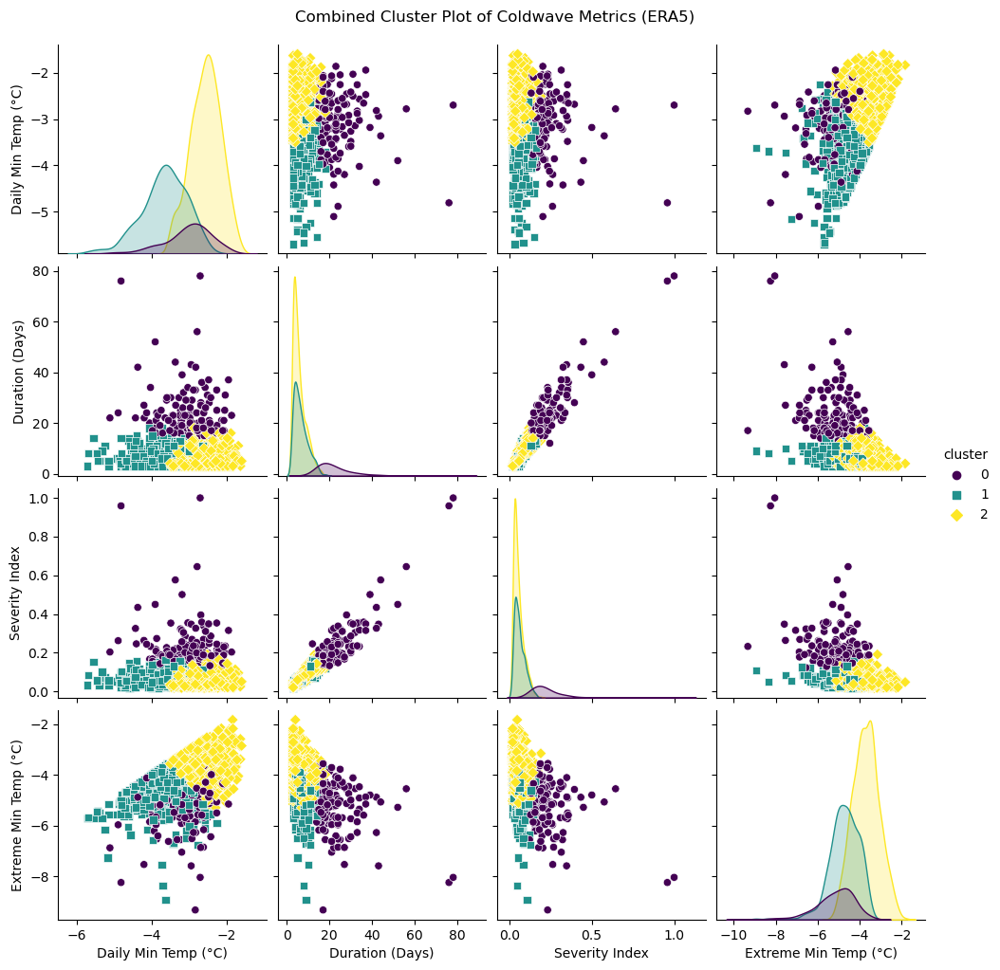

In [16]:
# Replace this with your actual data loading step
metrics_df = coldwave_dataset.to_dataframe().reset_index()

# Flatten and clean 'min_temps' column
def extract_numeric_value(array_like):
    """Extract numeric value from array-like structure."""
    if isinstance(array_like, np.ndarray):
        return array_like.item() if array_like.size > 0 else np.nan
    return array_like

metrics_df['min_temps'] = metrics_df['min_temps'].apply(extract_numeric_value)

# Convert relevant columns to numeric and handle errors
metrics_df['tasmin'] = pd.to_numeric(metrics_df['tasmin'], errors='coerce')
metrics_df['length'] = pd.to_numeric(metrics_df['length'], errors='coerce')
metrics_df['severity'] = pd.to_numeric(metrics_df['severity'], errors='coerce')
metrics_df['min_temps'] = pd.to_numeric(metrics_df['min_temps'], errors='coerce')

# Drop rows with NaN values in selected columns
metrics_df_selected = metrics_df.dropna(subset=['tasmin', 'length', 'severity', 'min_temps'])

# Standardize the metrics
scaler = StandardScaler()
scaled_metrics = scaler.fit_transform(metrics_df_selected[['tasmin', 'length', 'severity', 'min_temps']])

# Perform KMeans clustering
kmeans = KMeans(n_clusters=3, random_state=42)
metrics_df_selected['cluster'] = kmeans.fit_predict(scaled_metrics)

# Map the descriptive names for metrics
metric_names = {
    'tasmin': 'Daily Min Temp (°C)',
    'length': 'Duration (Days)',
    'severity': 'Severity Index',
    'min_temps': 'Extreme Min Temp (°C)'
}

# Prepare a DataFrame for plotting with renamed columns
plot_df = metrics_df_selected[['tasmin', 'length', 'severity', 'min_temps', 'cluster']].copy()
plot_df.rename(columns=metric_names, inplace=True)

# Plot pairplot
sns.pairplot(plot_df, hue='cluster', palette='viridis', markers=['o', 's', 'D'])
plt.suptitle('Combined Cluster Plot of Coldwave Metrics (ERA5)', y=1.02)

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_metrics_cluster_plot.png', dpi=300)

plt.show()

In [18]:
def extract_numeric_value(array_like):
    """Extract numeric value from array-like structure."""
    if isinstance(array_like, np.ndarray):
        return array_like.item() if array_like.size > 0 else np.nan
    return array_like

metrics_df['min_temps'] = metrics_df['min_temps'].apply(extract_numeric_value)

# Convert relevant columns to numeric and handle errors
metrics_df['tasmin'] = pd.to_numeric(metrics_df['tasmin'], errors='coerce')
metrics_df['length'] = pd.to_numeric(metrics_df['length'], errors='coerce')
metrics_df['severity'] = pd.to_numeric(metrics_df['severity'], errors='coerce')
metrics_df['min_temps'] = pd.to_numeric(metrics_df['min_temps'], errors='coerce')

# Drop rows with NaN values in selected columns
metrics_df_selected = metrics_df.dropna(subset=['tasmin', 'length', 'severity', 'min_temps'])


Cluster Centroids:
   Daily Min Temp (°C)  Duration (Days)  Severity Index  \
0            -3.016146        22.730263        0.229235   
1            -3.656206         6.501066        0.062039   
2            -2.554870         5.825798        0.055757   

   Extreme Min Temp (°C)  Cluster  
0              -5.184886        0  
1              -4.738252        1  
2              -3.708835        2  


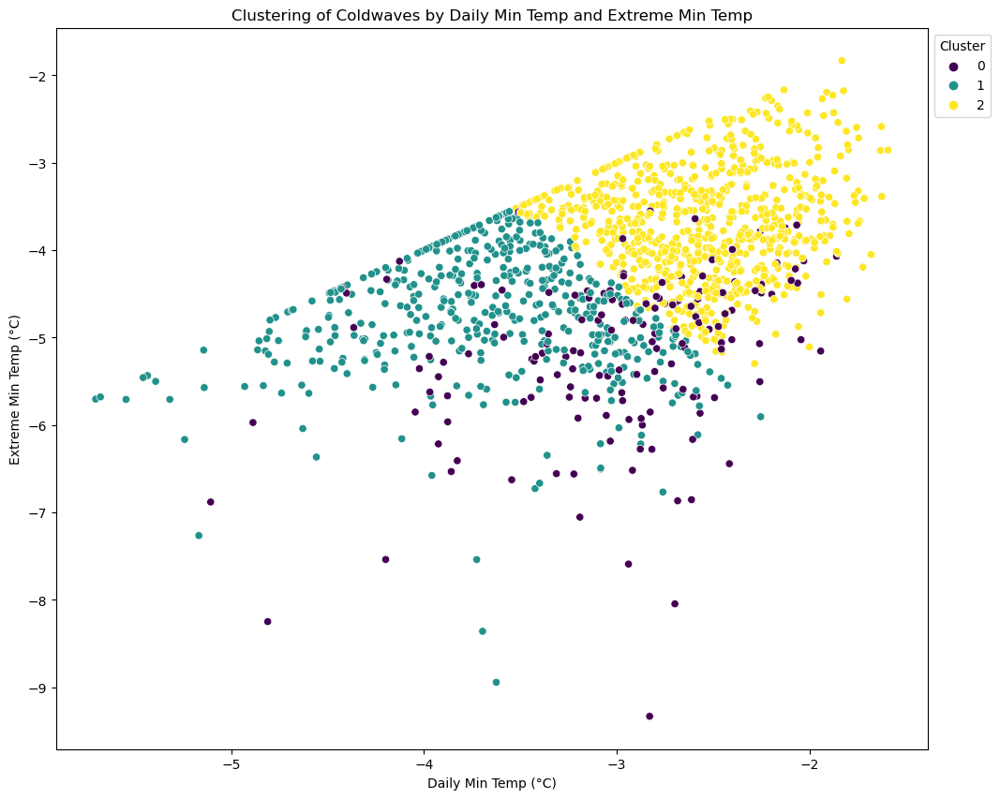

     tasmin  length  severity  min_temps  cluster
0 -4.597478      14  0.147622  -5.637524        1
1 -4.770039       3  0.031697  -4.770039        1
2 -3.401092       9  0.090821  -5.589410        1
3 -3.171635       4  0.042187  -3.625302        2
4 -2.892752       5  0.052392  -5.248700        1


In [19]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import seaborn as sns
import matplotlib.pyplot as plt

# Standardize the metrics
scaler = StandardScaler()
scaled_metrics = scaler.fit_transform(metrics_df_selected[['tasmin', 'length', 'severity', 'min_temps']])

# Perform KMeans clustering
kmeans = KMeans(n_clusters=3, random_state=42)
metrics_df_selected['cluster'] = kmeans.fit_predict(scaled_metrics)

# Map the descriptive names for metrics
metric_names = {
    'tasmin': 'Daily Min Temp (°C)',
    'length': 'Duration (Days)',
    'severity': 'Severity Index',
    'min_temps': 'Extreme Min Temp (°C)'
}

# Rename columns for plotting
plot_df = metrics_df_selected[['tasmin', 'length', 'severity', 'min_temps', 'cluster']].copy()
plot_df.rename(columns=metric_names, inplace=True)

# Calculate cluster centroids
centroids = pd.DataFrame(scaler.inverse_transform(kmeans.cluster_centers_), columns=[metric_names[col] for col in ['tasmin', 'length', 'severity', 'min_temps']])
centroids['Cluster'] = centroids.index

# Print centroids
print("Cluster Centroids:")
print(centroids)

# Plot clusters
plt.figure(figsize=(12, 10))
sns.scatterplot(data=metrics_df_selected, x='tasmin', y='min_temps', hue='cluster', palette='viridis')
plt.title('Clustering of Coldwaves by Daily Min Temp and Extreme Min Temp')
plt.xlabel('Daily Min Temp (°C)')
plt.ylabel('Extreme Min Temp (°C)')
plt.legend(title='Cluster', loc='upper left', bbox_to_anchor=(1, 1))
plt.show()

# Print a sample of data with cluster labels
print(metrics_df_selected[['tasmin', 'length', 'severity', 'min_temps', 'cluster']].head())


In [ ]:
Cluster Centroids:
   Daily Min Temp (°C)  Duration (Days)  Severity Index  \
0            -3.016146        22.730263        0.229235   
1            -3.656206         6.501066        0.062039   
2            -2.554870         5.825798        0.055757   

   Extreme Min Temp (°C)  Cluster  
0              -5.184886        0  
1              -4.738252        1  
2              -3.708835        2  


Cluster 0:

Daily Min Temp (°C): -3.02
Duration (Days): 22.73 days
Severity Index: 0.23
Extreme Min Temp (°C): -5.18
Suggested Name: "Extended Moderate Cold Wave"
Rationale: This cluster represents a cold wave with an extended duration of over 22 days, with moderately cold temperatures and moderate severity. The term "Extended" emphasizes the prolonged duration, while "Moderate Cold Wave" describes the intensity.
Cluster 1:

Daily Min Temp (°C): -3.66
Duration (Days): 6.50 days
Severity Index: 0.06
Extreme Min Temp (°C): -4.74
Suggested Name: "Short Moderate Cold Wave"
Rationale: This cluster features a cold wave of moderate intensity with a shorter duration (around 6.5 days) and mild severity. The term "Short" indicates the brief duration, while "Moderate Cold Wave" reflects the moderate intensity.
Cluster 2:

Daily Min Temp (°C): -2.55
Duration (Days): 5.83 days
Severity Index: 0.06
Extreme Min Temp (°C): -3.71
Suggested Name: "Brief Mild Cold Wave"
Rationale: This cluster is characterized by the mildest conditions and the shortest duration. The term "Brief" highlights the short duration, while "Mild Cold Wave" conveys the low intensity and mild temperatures.

In [20]:
# Define the cluster labels
cluster_labels = {
    0: "Extended Moderate Cold Wave",
    1: "Short Moderate Cold Wave",
    2: "Brief Mild Cold Wave"
}

# Add a new column to your DataFrame with these labels
metrics_df_selected['cluster_label'] = metrics_df_selected['cluster'].map(cluster_labels)

# Display the first few rows to check
print(metrics_df_selected[['tasmin', 'length', 'severity', 'min_temps', 'cluster', 'cluster_label']].head())

     tasmin  length  severity  min_temps  cluster             cluster_label
0 -4.597478      14  0.147622  -5.637524        1  Short Moderate Cold Wave
1 -4.770039       3  0.031697  -4.770039        1  Short Moderate Cold Wave
2 -3.401092       9  0.090821  -5.589410        1  Short Moderate Cold Wave
3 -3.171635       4  0.042187  -3.625302        2      Brief Mild Cold Wave
4 -2.892752       5  0.052392  -5.248700        1  Short Moderate Cold Wave


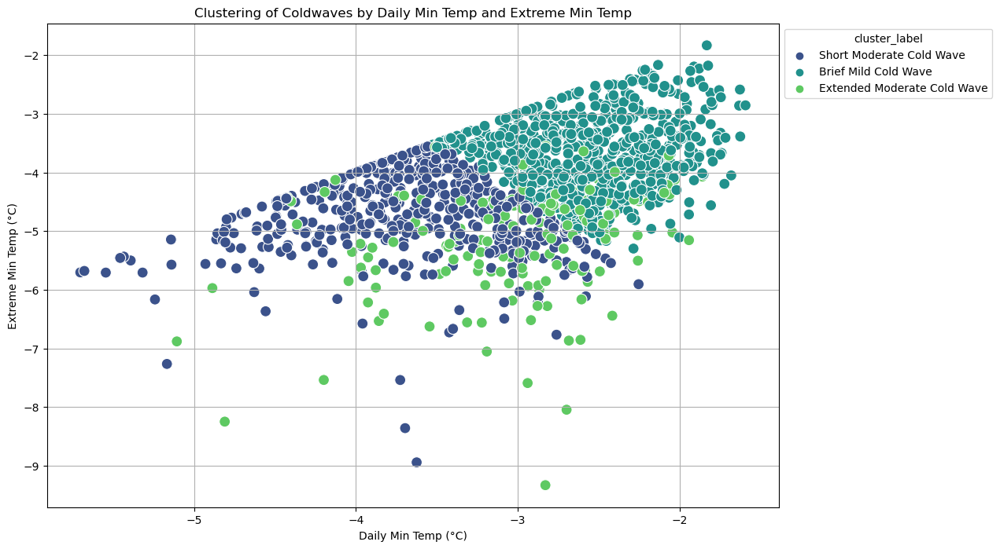

In [533]:
plt.figure(figsize=(12, 8))
sns.scatterplot(data=metrics_df_selected, x='tasmin', y='min_temps', hue='cluster_label', palette='viridis', s=100)
plt.title('Clustering of Coldwaves by Daily Min Temp and Extreme Min Temp')
plt.xlabel('Daily Min Temp (°C)')
plt.ylabel('Extreme Min Temp (°C)')
plt.legend(title='cluster_label', loc='upper left', bbox_to_anchor=(1, 1))
plt.grid(True)
plt.show()

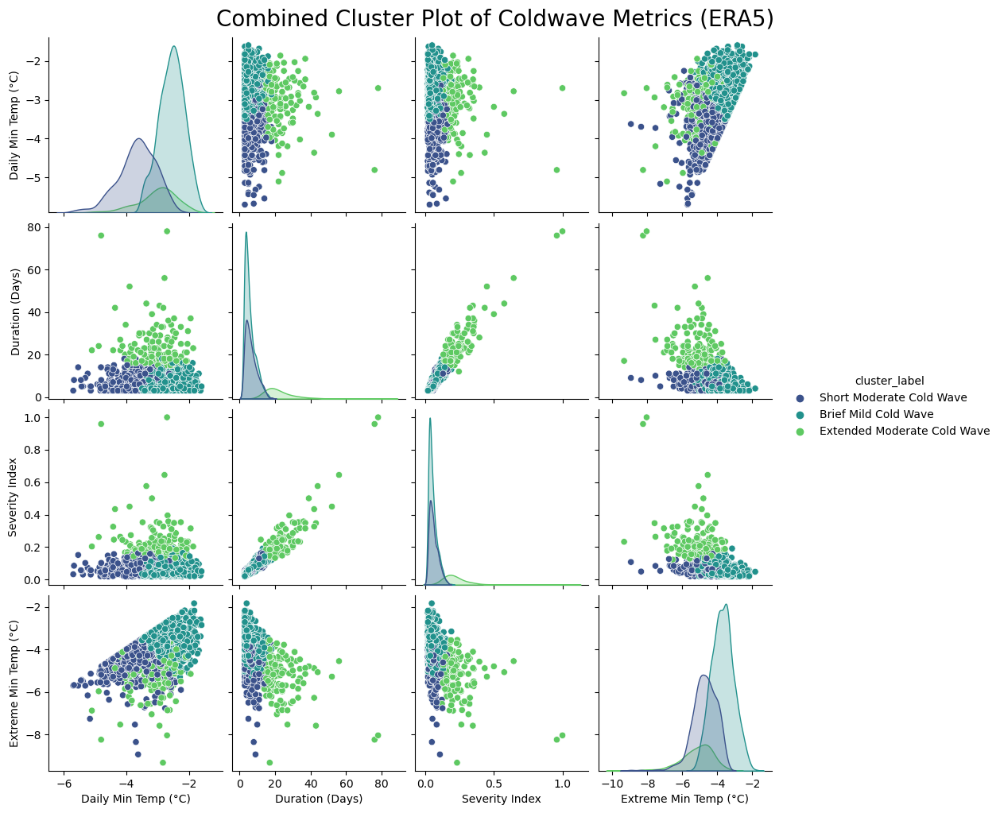

In [21]:
# Map the descriptive names for metrics
metric_names = {
    'tasmin': 'Daily Min Temp (°C)',
    'length': 'Duration (Days)',
    'severity': 'Severity Index',
    'min_temps': 'Extreme Min Temp (°C)',
    'cluster_label': 'cluster_label',
    'cluster': 'cluster'
}

# Prepare a DataFrame for plotting with renamed columns
plot_df = metrics_df_selected[['tasmin', 'length', 'severity', 'min_temps', 'cluster_label','cluster']].copy()
plot_df.rename(columns=metric_names, inplace=True)

sns.pairplot(plot_df, hue='cluster_label', palette='viridis', vars=['Daily Min Temp (°C)', 'Duration (Days)', 'Severity Index', 'Extreme Min Temp (°C)'])
plt.suptitle('Combined Cluster Plot of Coldwave Metrics (ERA5)', y=1.02, fontsize=20)

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_metrics_cluster_plot_labelled.png', dpi=300)

plt.show()


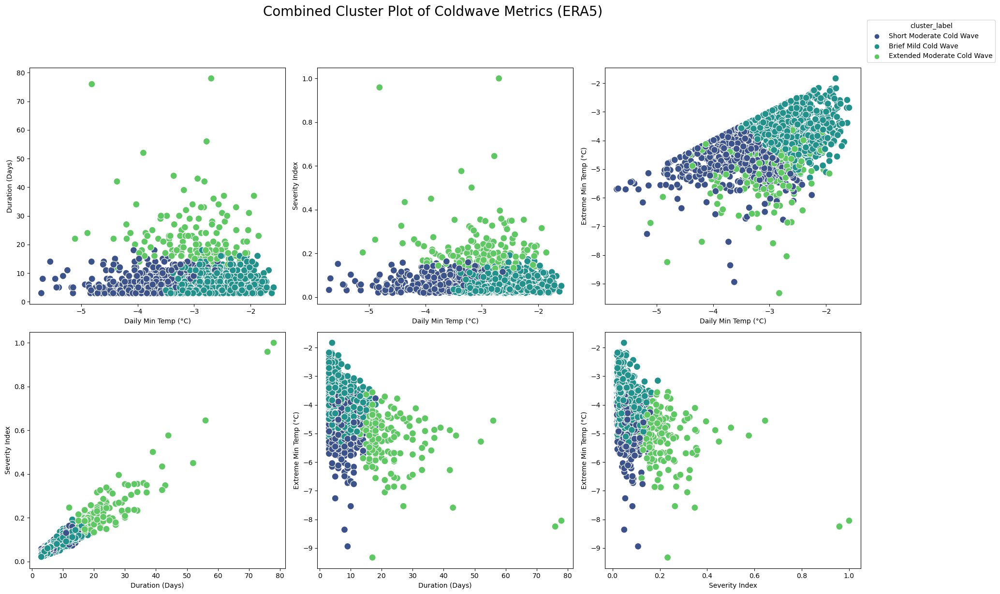

In [543]:
# Define the metrics you want to include in the scatter plots
metrics = ['Daily Min Temp (°C)', 'Duration (Days)', 'Severity Index', 'Extreme Min Temp (°C)']

# Create a 2x3 grid for the scatter plots
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Define the pairs of metrics to plot
pairs = [
    ('Daily Min Temp (°C)', 'Duration (Days)'),
    ('Daily Min Temp (°C)', 'Severity Index'),
    ('Daily Min Temp (°C)', 'Extreme Min Temp (°C)'),
    ('Duration (Days)', 'Severity Index'),
    ('Duration (Days)', 'Extreme Min Temp (°C)'),
    ('Severity Index', 'Extreme Min Temp (°C)')
]

# Plot each pair
for i, (x, y) in enumerate(pairs):
    sns.scatterplot(data=plot_df, x=x, y=y, hue='cluster_label', palette='viridis', ax=axes[i], s=100)
    axes[i].set_xlabel(x)
    axes[i].set_ylabel(y)
    axes[i].legend_.remove()  # Remove the legend from individual plots to avoid redundancy

# Add a main title
plt.suptitle('Combined Cluster Plot of Coldwave Metrics (ERA5)', y=1.02, fontsize=20)

# Add a single legend outside the grid
handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='upper right', bbox_to_anchor=(1.15, 1), title='cluster_label')

# Adjust layout to avoid title being cut off
plt.tight_layout(rect=[0, 0, 1, 0.96])

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_metrics_cluster_plot_labelled_6panels.png', 
            dpi=300, bbox_inches='tight')

plt.show()


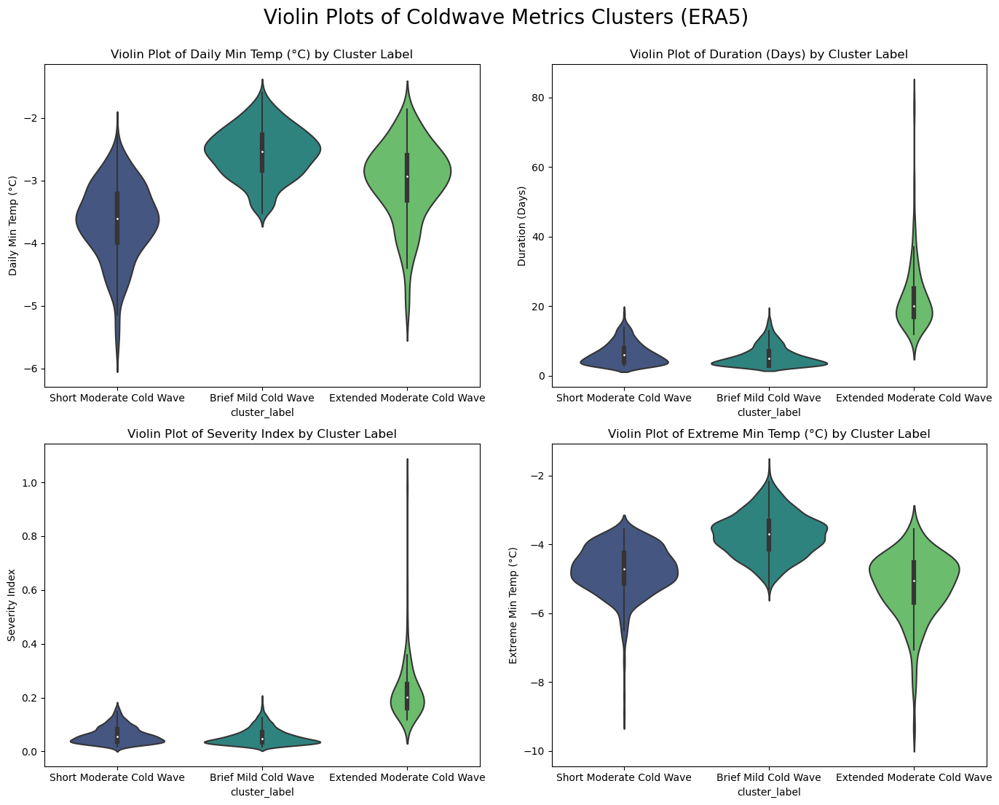

In [541]:
plt.figure(figsize=(14, 11))

for i, column in enumerate(['Daily Min Temp (°C)', 'Duration (Days)', 'Severity Index', 'Extreme Min Temp (°C)'], 1):
    plt.subplot(2, 2, i)
    sns.violinplot(x='cluster_label', y=column, data=plot_df, palette='viridis')
    plt.title(f'Violin Plot of {column} by Cluster Label')

plt.suptitle('Violin Plots of Coldwave Metrics Clusters (ERA5)', y=1.0, fontsize=20)
plt.tight_layout()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/coldwave_metrics_cluster_violin_plots.png', dpi=300)

plt.show()

In [27]:
# Adjusted calculate_damage function for pandas with the current metric names
def calculate_damage_pandas(df, 
                            temp_metric='Daily Min Temp (°C)', 
                            duration_metric='Duration (Days)', 
                            severity_metric='Severity Index', 
                            extremes_metric='Extreme Min Temp (°C)',
                            temp_weight=0.4, 
                            dur_weight=0.3, 
                            sev_weight=0.2, 
                            ext_weight=0.1):
    """
    Calculate the potential damage from coldwaves based on given metrics in a pandas DataFrame.
    """
    # Normalize the metrics
    temp_normalized = (df[temp_metric].max() - df[temp_metric]) / (df[temp_metric].max() - df[temp_metric].min())
    dur_normalized = (df[duration_metric] - df[duration_metric].min()) / (df[duration_metric].max() - df[duration_metric].min())
    sev_normalized = (df[severity_metric] - df[severity_metric].min()) / (df[severity_metric].max() - df[severity_metric].min())
    ext_normalized = (df[extremes_metric].max() - df[extremes_metric]) / (df[extremes_metric].max() - df[extremes_metric].min())
    
    # Calculate the damage score
    damage_score = (temp_weight * temp_normalized + 
                    dur_weight * dur_normalized + 
                    sev_weight * sev_normalized + 
                    ext_weight * ext_normalized)
    
    return damage_score


In [29]:
# Define the calculate_damage function
def calculate_damage_infrastructure_cluster(dataset, 
                     temp_metric='Daily Min Temp (°C)', 
                            duration_metric='Duration (Days)', 
                            severity_metric='Severity Index', 
                            extremes_metric='Extreme Min Temp (°C)',
                     temp_weight=0.2, 
                     dur_weight=0.2, 
                     sev_weight=0.3, 
                     ext_weight=0.3):
    """
    Calculate the potential damage from coldwaves based on given metrics in an xarray dataset.

    Parameters:
    dataset (xarray.Dataset): Dataset containing coldwave metrics.
    temp_metric (str): Name of the temperature metric in the dataset.
    duration_metric (str): Name of the duration metric in the dataset.
    severity_metric (str): Name of the severity metric in the dataset.
    extremes_metric (str): Name of the extremes metric in the dataset.
    temp_weight (float): Weight for the temperature metric.
    dur_weight (float): Weight for the duration metric.
    sev_weight (float): Weight for the severity metric.
    ext_weight (float): Weight for the extremes metric.

    Returns:
    xarray.DataArray: Potential damage score.
    """
    
    # Extract metrics from dataset
    temperature = dataset[temp_metric]
    duration = dataset[duration_metric]
    severity = dataset[severity_metric]
    extremes = dataset[extremes_metric]
    
    # Normalize the metrics
    # Reverse normalization for temperature: colder temperatures (lower values) should get higher scores
    temp_normalized = (temperature.max() - temperature) / (temperature.max() - temperature.min())
    dur_normalized = (duration - duration.min()) / (duration.max() - duration.min())
    sev_normalized = (severity - severity.min()) / (severity.max() - severity.min())

    # Reverse normalization for extremes: higher extremes (lower values) should get higher scores
    ext_normalized = (extremes.max() - extremes) / (extremes.max() - extremes.min())
    
    # Calculate the damage score
    damage_score = (temp_weight * temp_normalized + 
                    dur_weight * dur_normalized + 
                    sev_weight * sev_normalized + 
                    ext_weight * ext_normalized)
    
    return damage_score

In [31]:
# Define the calculate_damage function
def calculate_damage_energy_systems_cluster(dataset, 
                     temp_metric='Daily Min Temp (°C)', 
                            duration_metric='Duration (Days)', 
                            severity_metric='Severity Index', 
                            extremes_metric='Extreme Min Temp (°C)',
                     temp_weight=0.2, 
                     dur_weight=0.3, 
                     sev_weight=0.1, 
                     ext_weight=0.4):
    """
    Calculate the potential damage from coldwaves based on given metrics in an xarray dataset.

    Parameters:
    dataset (xarray.Dataset): Dataset containing coldwave metrics.
    temp_metric (str): Name of the temperature metric in the dataset.
    duration_metric (str): Name of the duration metric in the dataset.
    severity_metric (str): Name of the severity metric in the dataset.
    extremes_metric (str): Name of the extremes metric in the dataset.
    temp_weight (float): Weight for the temperature metric.
    dur_weight (float): Weight for the duration metric.
    sev_weight (float): Weight for the severity metric.
    ext_weight (float): Weight for the extremes metric.

    Returns:
    xarray.DataArray: Potential damage score.
    """
    
    # Extract metrics from dataset
    temperature = dataset[temp_metric]
    duration = dataset[duration_metric]
    severity = dataset[severity_metric]
    extremes = dataset[extremes_metric]
    
    # Normalize the metrics
    # Reverse normalization for temperature: colder temperatures (lower values) should get higher scores
    temp_normalized = (temperature.max() - temperature) / (temperature.max() - temperature.min())
    dur_normalized = (duration - duration.min()) / (duration.max() - duration.min())
    sev_normalized = (severity - severity.min()) / (severity.max() - severity.min())
    
    # Reverse normalization for extremes: higher extremes (lower values) should get higher scores
    ext_normalized = (extremes.max() - extremes) / (extremes.max() - extremes.min())
    
    # Calculate the damage score
    damage_score = (temp_weight * temp_normalized + 
                    dur_weight * dur_normalized + 
                    sev_weight * sev_normalized + 
                    ext_weight * ext_normalized)
    
    return damage_score

In [33]:
# Define the calculate_damage function
def calculate_damage_health_cluster(dataset, 
                      temp_metric='Daily Min Temp (°C)', 
                            duration_metric='Duration (Days)', 
                            severity_metric='Severity Index', 
                            extremes_metric='Extreme Min Temp (°C)',
                     temp_weight=0.2, 
                     dur_weight=0.4, 
                     sev_weight=0.2, 
                     ext_weight=0.2):
    """
    Calculate the potential damage from coldwaves based on given metrics in an xarray dataset.

    Parameters:
    dataset (xarray.Dataset): Dataset containing coldwave metrics.
    temp_metric (str): Name of the temperature metric in the dataset.
    duration_metric (str): Name of the duration metric in the dataset.
    severity_metric (str): Name of the severity metric in the dataset.
    extremes_metric (str): Name of the extremes metric in the dataset.
    temp_weight (float): Weight for the temperature metric.
    dur_weight (float): Weight for the duration metric.
    sev_weight (float): Weight for the severity metric.
    ext_weight (float): Weight for the extremes metric.

    Returns:
    xarray.DataArray: Potential damage score.
    """
    
    # Extract metrics from dataset
    temperature = dataset[temp_metric]
    duration = dataset[duration_metric]
    severity = dataset[severity_metric]
    extremes = dataset[extremes_metric]
    
    # Normalize the metrics
    # Reverse normalization for temperature: colder temperatures (lower values) should get higher scores
    temp_normalized = (temperature.max() - temperature) / (temperature.max() - temperature.min())
    dur_normalized = (duration - duration.min()) / (duration.max() - duration.min())
    sev_normalized = (severity - severity.min()) / (severity.max() - severity.min())
    
    # Reverse normalization for extremes: higher extremes (lower values) should get higher scores
    ext_normalized = (extremes.max() - extremes) / (extremes.max() - extremes.min())
    
    # Calculate the damage score
    damage_score = (temp_weight * temp_normalized + 
                    dur_weight * dur_normalized + 
                    sev_weight * sev_normalized + 
                    ext_weight * ext_normalized)
    
    return damage_score

In [35]:
# Group the DataFrame by cluster and calculate the damage scores
plot_df['damage_score'] = plot_df.groupby('cluster').apply(
    lambda group: calculate_damage_pandas(group)
).reset_index(drop=True)

# Display the DataFrame with the new damage scores
print(plot_df)

      Daily Min Temp (°C)  Duration (Days)  Severity Index  \
0               -4.597478               14        0.147622   
1               -4.770039                3        0.031697   
2               -3.401092                9        0.090821   
3               -3.171635                4        0.042187   
4               -2.892752                5        0.052392   
...                   ...              ...             ...   
1368            -2.358157                4        0.044352   
1369            -2.153156                4        0.045964   
1370            -2.279765                5        0.060041   
1371            -1.823771                3        0.021139   
1372            -3.400290               11        0.130541   

      Extreme Min Temp (°C)             cluster_label  cluster  damage_score  
0                 -5.637524  Short Moderate Cold Wave        1      0.325585  
1                 -4.770039  Short Moderate Cold Wave        1      0.304898  
2                 

In [37]:
# Group the DataFrame by cluster and calculate the damage scores
plot_df['damage_score_health'] = plot_df.groupby('cluster').apply(
    lambda group: calculate_damage_health_cluster(group)
).reset_index(drop=True)

# Group the DataFrame by cluster and calculate the damage scores
plot_df['damage_score_infrastructure'] = plot_df.groupby('cluster').apply(
    lambda group: calculate_damage_infrastructure_cluster(group)
).reset_index(drop=True)

# Group the DataFrame by cluster and calculate the damage scores
plot_df['damage_score_energy_systems'] = plot_df.groupby('cluster').apply(
    lambda group: calculate_damage_energy_systems_cluster(group)
).reset_index(drop=True)

# Display the DataFrame with the new damage scores
print(plot_df)

      Daily Min Temp (°C)  Duration (Days)  Severity Index  \
0               -4.597478               14        0.147622   
1               -4.770039                3        0.031697   
2               -3.401092                9        0.090821   
3               -3.171635                4        0.042187   
4               -2.892752                5        0.052392   
...                   ...              ...             ...   
1368            -2.358157                4        0.044352   
1369            -2.153156                4        0.045964   
1370            -2.279765                5        0.060041   
1371            -1.823771                3        0.021139   
1372            -3.400290               11        0.130541   

      Extreme Min Temp (°C)             cluster_label  cluster  damage_score  \
0                 -5.637524  Short Moderate Cold Wave        1      0.325585   
1                 -4.770039  Short Moderate Cold Wave        1      0.304898   
2              

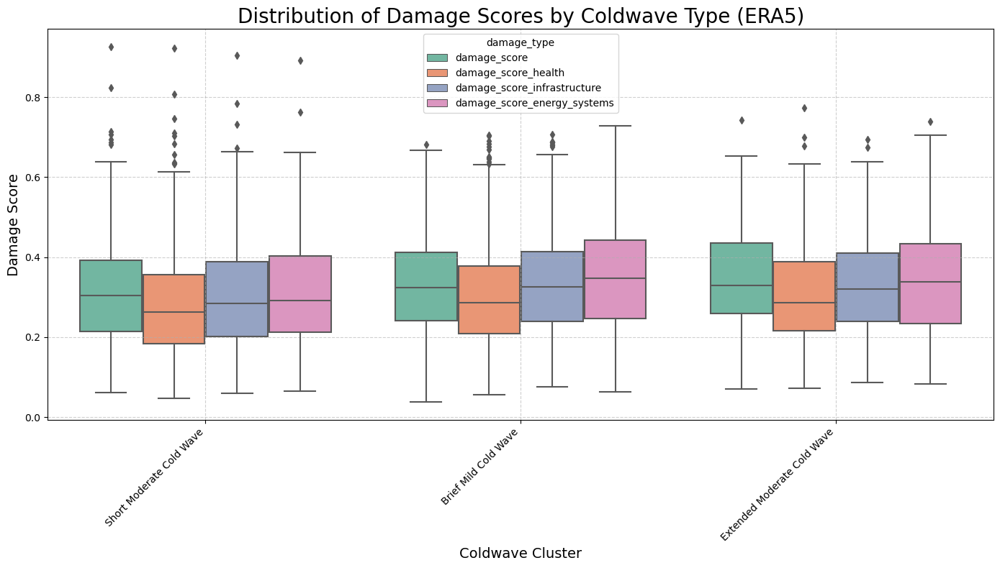

In [85]:
import seaborn as sns
import matplotlib.pyplot as plt

# Melt the DataFrame to create a long-form DataFrame suitable for combined plotting
plot_df_melted = plot_df.melt(
    id_vars=['cluster_label', 'cluster'], 
    value_vars=['damage_score', 'damage_score_health', 'damage_score_infrastructure', 'damage_score_energy_systems'], 
    var_name='damage_type', 
    value_name='score'
)

# Set the plot size
plt.figure(figsize=(14, 8))

# Create a combined box plot
sns.boxplot(x='cluster_label', y='score', hue='damage_type', data=plot_df_melted, palette='Set2')

# Add a title and labels
plt.title('Distribution of Damage Scores by Coldwave Type (ERA5)', fontsize=20)
plt.xlabel('Coldwave Cluster', fontsize=14)
plt.ylabel('Damage Score', fontsize=14)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Show grid for better interpretation of values
plt.grid(True, linestyle='--', alpha=0.6)

# Display the plot
plt.tight_layout()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/combined_coldwave_cluster_damage.png', 
            dpi=300, bbox_inches='tight')
plt.show()


In [49]:
# Convert the 'start_date' and 'index' from the xarray Dataset to a DataFrame
coldwave_df = coldwave_dataset[['start_date']].to_dataframe().reset_index()


In [53]:
# Merge 'start_date' into 'plot_df' using the 'index' column
plot_df = plot_df.merge(coldwave_df[['start_date', 'index']], left_index=True, right_on='index')

# After the merge, you can drop the 'index' column if it's no longer needed
plot_df.drop(columns='index', inplace=True)

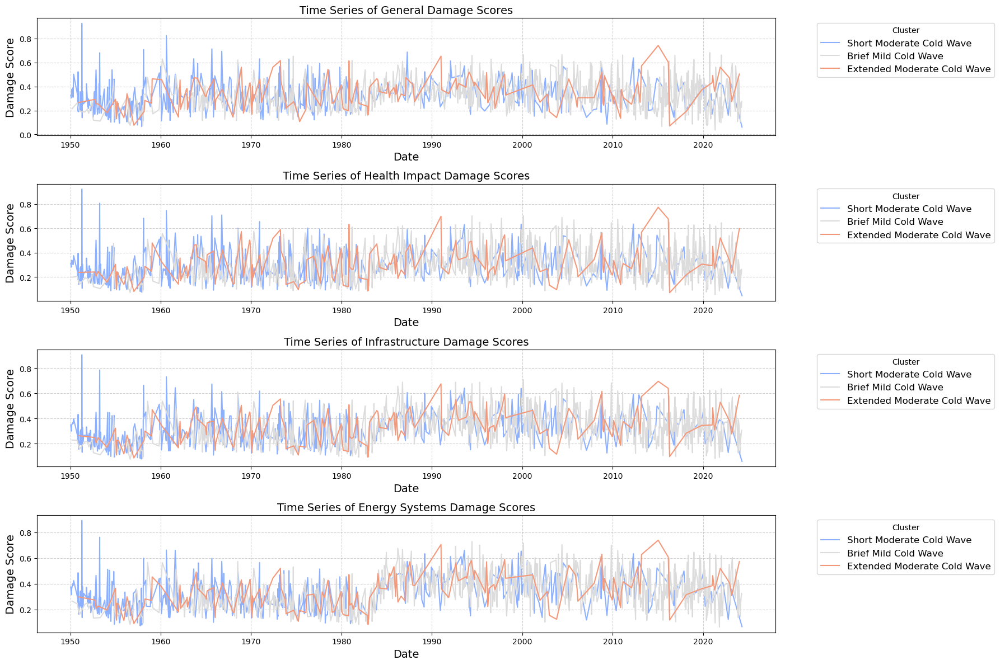

In [77]:
# Set the plot size (increased for larger panels)
plt.figure(figsize=(18, 12))

# Define line width for better readability
line_width = 1.5

# Plot for General Damage Score
plt.subplot(4, 1, 1)
sns.lineplot(x='start_date', y='damage_score', hue='cluster_label', data=plot_df, palette='coolwarm', linewidth=line_width)
plt.title('Time Series of General Damage Scores', fontsize=14)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Damage Score', fontsize=14)
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)

# Plot for Health Impact Damage Score
plt.subplot(4, 1, 2)
sns.lineplot(x='start_date', y='damage_score_health', hue='cluster_label', data=plot_df, palette='coolwarm', linewidth=line_width)
plt.title('Time Series of Health Impact Damage Scores', fontsize=14)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Damage Score', fontsize=14)
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)

# Plot for Infrastructure Damage Score
plt.subplot(4, 1, 3)
sns.lineplot(x='start_date', y='damage_score_infrastructure', hue='cluster_label', data=plot_df, palette='coolwarm', linewidth=line_width)
plt.title('Time Series of Infrastructure Damage Scores', fontsize=14)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Damage Score', fontsize=14)
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)

# Plot for Energy Systems Damage Score
plt.subplot(4, 1, 4)
sns.lineplot(x='start_date', y='damage_score_energy_systems', hue='cluster_label', data=plot_df, palette='coolwarm', linewidth=line_width)
plt.title('Time Series of Energy Systems Damage Scores', fontsize=14)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Damage Score', fontsize=14)
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)

# Adjust the layout
plt.tight_layout()

# Show the plots
plt.show()

In [79]:
def normalize_scores(df, columns):
    """Normalize specified columns in a DataFrame to a range [0, 1]."""
    for col in columns:
        df[col + '_normalized'] = (df[col] - df[col].min()) / (df[col].max() - df[col].min())
    return df

# Apply normalization
plot_df = normalize_scores(plot_df, ['damage_score', 'damage_score_health', 'damage_score_infrastructure', 'damage_score_energy_systems'])


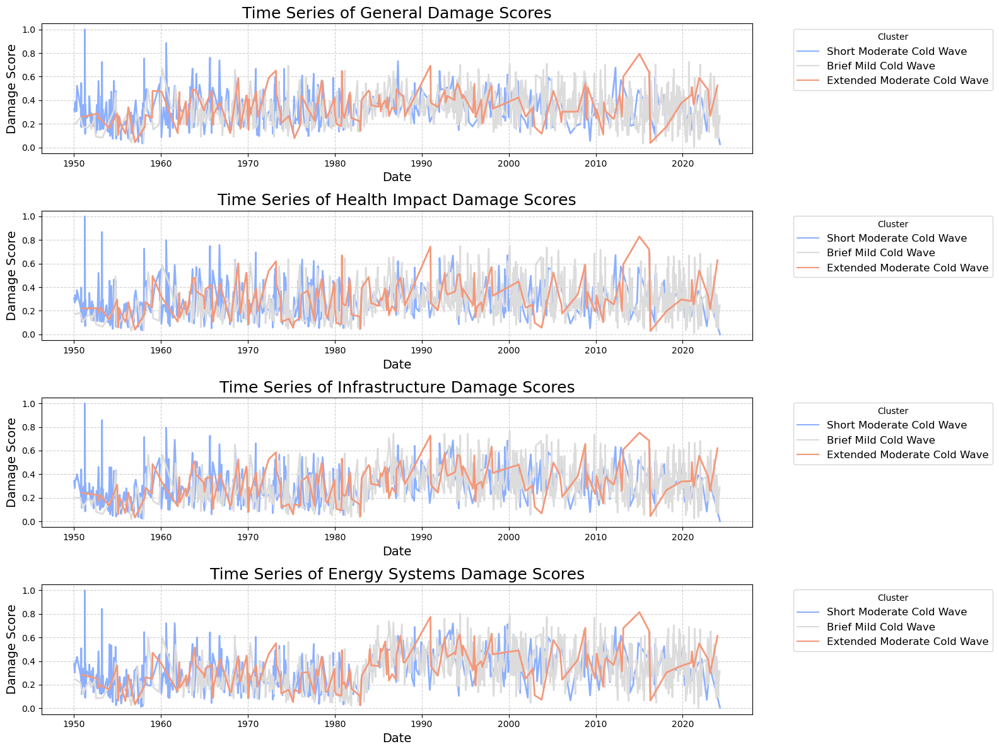

In [89]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the plot size
plt.figure(figsize=(16, 12))

# Define line width for better readability
line_width = 2

# Define colors and styles
colors = {
    'General Damage Score': 'coolwarm',
    'Health Impact Damage Score': 'coolwarm',
    'Infrastructure Damage Score': 'coolwarm',
    'Energy Systems Damage Score': 'coolwarm'
}
line_styles = ['-', '--', '-.', ':']

# Plot for General Damage Score
plt.subplot(4, 1, 1)
sns.lineplot(x='start_date', y='damage_score_normalized', hue='cluster_label', data=plot_df, palette=colors['General Damage Score'], linewidth=line_width)
plt.title('Time Series of General Damage Scores', fontsize=18)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Damage Score', fontsize=14)
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)

# Plot for Health Impact Damage Score
plt.subplot(4, 1, 2)
sns.lineplot(x='start_date', y='damage_score_health_normalized', hue='cluster_label', data=plot_df, palette=colors['Health Impact Damage Score'], linewidth=line_width)
plt.title('Time Series of Health Impact Damage Scores', fontsize=18)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Damage Score', fontsize=14)
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)

# Plot for Infrastructure Damage Score
plt.subplot(4, 1, 3)
sns.lineplot(x='start_date', y='damage_score_infrastructure_normalized', hue='cluster_label', data=plot_df, palette=colors['Infrastructure Damage Score'], linewidth=line_width)
plt.title('Time Series of Infrastructure Damage Scores', fontsize=18)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Damage Score', fontsize=14)
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)

# Plot for Energy Systems Damage Score
plt.subplot(4, 1, 4)
sns.lineplot(x='start_date', y='damage_score_energy_systems_normalized', hue='cluster_label', data=plot_df, palette=colors['Energy Systems Damage Score'], linewidth=line_width)
plt.title('Time Series of Energy Systems Damage Scores', fontsize=18)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Damage Score', fontsize=14)
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)

# Adjust the layout
plt.tight_layout()

# Save the plot before showing it
plt.savefig('OneDrive - University College London/Documents/Uni/Masters/Dissertation/plots/python plots/ERA5/combined_coldwave_cluster_damage_timeseries.png', 
            dpi=300, bbox_inches='tight')

# Show the plots
plt.show()
